## Code to identify promoters of mating genes in different species.
> written by Sri Srikant, 20200415 for use with Harvard Odyssey 2.0 in py2 for job submission to the SLURM scheduler

The goal of this notebook is to develop methods to predict fungal lipidated (a-like) pheromones in yeast species from their genome sequence. The code is written with the intention of using the 332 yeast genomes published in Shen XX et al, Cell (2018). This notebook is the corollory of the primary code-base in {pheromoneFinder.py} that is also written for running on Harvard' Odyssey 2.0 SLURM scheduler. This code-base also includes code-cells to identify the promoters of mating genes in various yeasts (by identifying orthologs to mating genes in S. cerevisiae) and extract the conserved motifs for these promoters which are the presumed motifs of transcription factors that control mating. Finally, the code will look for the presence of these motifs upstream of the candidates identified by {pheromoneFinder.py}. The presence of these motifs offers a scoring strategy to rank-order candidates for testing to find true pheromones.

On [20210421] switched to sager's mode of working directly in GoogleDrive data. This is now symbolically linked in xps15 at "/home/ssrikant/WindowsFiles/Fungi_pheromoneFinder"

In [1]:
##Importing all the relevant libraries.
import sys
import os
from os import listdir
from os.path import isfile, join
import subprocess
import shlex

import traceback
import re
import collections

from Bio import SeqIO
from Bio.Seq import Seq
from Bio.Alphabet import IUPAC
from Bio import pairwise2
from collections import defaultdict
from Bio.SeqUtils.ProtParam import ProteinAnalysis
from Bio.Blast.Applications import NcbiblastxCommandline
from Bio.Blast.Applications import NcbiblastnCommandline
from Bio.Blast.Applications import NcbitblastnCommandline
from Bio.Blast import NCBIXML
import xml.etree.ElementTree as ET

#import dendropy
import numpy as np
import scipy as scp
import seaborn as sns
import pandas as pd
from pylab import *
import matplotlib.pyplot as plt
##Set pdf ouput of matplotlib to have embedded fonts that are editable in Illustrator
plt.rcParams['pdf.fonttype'] = 42
##Output current font family
print(plt.rcParams['font.family'])
print(plt.rcParams['font.sans-serif'])
##Setting the default font to 'Arial'
plt.rcParams.update({'font.family':'sans-serif'})
plt.rcParams.update({'font.sans-serif':'Arial'})

import csv
import math
import operator
import itertools
from operator import attrgetter
from pprint import pprint

#data_dir = os.path.join("..", "..", "..", "pheromoneFinder_data", "Cluster")
data_dir = os.path.join("/home", "ssrikant", "WindowsFiles", "Fungi_pheromoneFinder", "Cluster")
figure_dir = os.path.join(data_dir, "figures")

fileList = [f for f in listdir(data_dir) if os.path.isdir(os.path.join(data_dir, f))]
print("List of folders:")
print("\n".join(fileList))

['sans-serif']
['DejaVu Sans', 'Bitstream Vera Sans', 'Computer Modern Sans Serif', 'Lucida Grande', 'Verdana', 'Geneva', 'Lucid', 'Arial', 'Helvetica', 'Avant Garde', 'sans-serif']
List of folders:
candidatePromoters
matingGeneHomologPromoters
candidates_phyloGroups_Geneious
copynumberCandidates
meme
ORF-Locator
scores
figures
tree
fimo
evolution-rate
curated-candidates_geneious


In [2]:
##These are Classes and Functions
###Not using this for now.
class Pipeline(object):
    def __init__(self, command):
        self.command = command
        self.command_list = self.command.split('|')
        self.output = None
        self.errors = None
        self.status = None
        self.result = None

    def run(self):
        process_list = list()
        previous_process = None
        for command in self.command_list:
            args = shlex.split(command)
            if previous_process is None:
                process = subprocess.Popen(args, stdout=subprocess.PIPE)
            else:
                process = subprocess.Popen(args,
                                           stdin=previous_process.stdout,
                                           stdout=subprocess.PIPE)
            process_list.append(process)
            previous_process = process
        last_process = process_list[-1]
        self.output, self.errors = last_process.communicate()
        self.status = last_process.returncode
        self.result = (0 == self.status)
        return self.result

class FASTAStructureMinimal():
    def __init__(self, id, seq):
        self.id = id
        self.seq = seq
        
###Functions to modify pandas dataframe
def insert_species_name(row):
    return row['sequence name'].split("|/|")[0]

####Functions to modify the pandas dataframe 'candidate_promoter_stats_frame'
def fimostats_insert_species_name(row):
    return row['PheromoneCandidateName'].split("|/|")[0]

def fimostats_insert_chr_id(row):
    return row['PheromoneCandidateName'].split("|/|")[1].split("||")[0]

def fimostats_insert_cys_pos(row):
    return int(row['PheromoneCandidateName'].split("|/|")[1].split("||")[1].split("[Translate:")[0].split("[")[-1].split("-")[-2])

def fimostats_insert_stop_pos(row):
    return int(row['PheromoneCandidateName'].split("|/|")[1].split("||")[1].split("[Translate:")[0].split("[")[-1].split("-")[-1].split("]")[0])

####Functions to modify the pandas dataframe 'final_candidates_scoring_frame'
def candidates_score_sum_motifs(row):
    return (row['#all_motif_sites'] + row['#pheroAct_motif_sites'] + row['#aSpec_motif_sites'])

####Functions to modify the pandas dataframe 'mature_candidates_geneious_frame'
def mature_region_length(row):
    return (len(row['mature']))

###Functions for natural sorting, from (https://stackoverflow.com/questions/5967500/how-to-correctly-sort-a-string-with-a-number-inside)
def atoi(text):
    return int(text) if text.isdigit() else text

def natural_keys(text):
    '''
    alist.sort(key=natural_keys) sorts in human order
    http://nedbatchelder.com/blog/200712/human_sorting.html
    (See Toothy's implementation in the comments)
    '''
    return [ atoi(c) for c in re.split(r'(\d+)', text) ]

##Functions from Peter Culviner (https://www.github.com/peterculviner), wrappers to use meme locally. I have installed meme-5.1.1 on WSL Ubuntu 18.04 with python 2.7.
def parsememexml(xml_path, library_order = 'ATGC'):
    # populate a list for scores and frequencies from meme output
    motif_details = []
    motif_scores = []
    motif_frequencies = []
    motif_regex = []
    counts = []
    # pull motifs from the xml file
    open_xml = ET.parse(xml_path)
    found_motifs = open_xml.getroot().find('motifs')
    for motif in found_motifs:
        #Modified by Sri, Details of the motif for use in comparissons.
        motif_name = motif.attrib['name']
        motif_width = motif.attrib['width']
        motif_evalue = motif.attrib['e_value']
        #motif_pvalue = motif.attrib['p_value'] #Not present in meme-4.9.0
        # populate empty arrays to fill, set to np.nan
        scores = np.zeros((int(motif.attrib['width']),len(library_order))) + np.nan
        frequencies = np.zeros((int(motif.attrib['width']),len(library_order))) + np.nan
        # add counts of instances used to build the motif
        counts.append(int(motif.attrib['sites']))
        # iterate across scores
        for position_i,position_data in enumerate(motif.find('scores').find('alphabet_matrix')):
            # iterate across letters for each position
            for letter_data in position_data:
                letter_i = library_order.find(letter_data.attrib['letter_id']) # determine letter_i based on library_order kwarg
                scores[position_i,letter_i] = float(letter_data.text)
        # iterate across frequencies
        for position_i,position_data in enumerate(motif.find('probabilities').find('alphabet_matrix')):
            # iterate across letters for each position
            for letter_data in position_data:
                letter_i = library_order.find(letter_data.attrib['letter_id']) # determine letter_i based on library_order kwarg
                frequencies[position_i,letter_i] = float(letter_data.text)
        motif_details.append([motif_name, motif_width, motif_evalue]) #Removed motif_pvalue
        motif_scores.append(scores)
        motif_frequencies.append(frequencies)
        motif_regex.append(motif.find('regular_expression').text.replace('\n',''))
    # pull letter frequences from xml file
    bg_frequencies = np.zeros(4)
    bg_letters = open_xml.getroot().find('training_set').find('letter_frequencies').find('alphabet_array')
    for letter_data in bg_letters:
        letter_i = library_order.find(letter_data.attrib['letter_id'])
        bg_frequencies[letter_i] = float(letter_data.text)
    # output data
    return motif_details, motif_scores, motif_frequencies, motif_regex, counts, bg_frequencies

##Parameters of MEME ['-dna','-nostatus', '-time', '18000', '-mod', 'anr', '-nmotifs', '3', '-minw', '6', '-maxw', '15', '-objfun', 'classic', '-revcomp', '-markov_order', '0']
##For WSL Ubuntu 18.04 ['-dna','-nostatus', '-time', '18000', '-mod', 'zoops', '-nmotifs', '3', '-minw', '5', '-maxw', '10', '-objfun', 'classic', '-revcomp', '-markov_order', '0'] meme-5.1.1
##For Odyssey 2.0 ['-dna','-nostatus', '-time', '18000', '-mod', 'zoops', '-nmotifs', '3', '-minw', '5', '-maxw', '10'] meme-4.9.0
##[delete_outputs = True] will prevent bloating the directory.
def memewrapper(fasta_path,
                meme_path = '/home/ssrikant/local/meme/bin/meme',
                meme_args = ['-dna','-nostatus', '-time', '18000', '-mod', 'zoops', '-nmotifs', '3', '-minw', '5', '-maxw', '10', '-objfun', 'classic', '-revcomp', '-markov_order', '0'],
                delete_outputs = False):
    # run meme
    base_directory = '/'.join(fasta_path.split('/')[:-2])
    file_name = fasta_path.split("/")[-1].split(".")[0]
    ###Base output directory check
    if not(os.path.isdir(os.path.join(base_directory, 'meme_output'))):
        os.mkdir(os.path.join(base_directory, 'meme_output'))
    ###Categorical output directory check; 'species' OR 'phyloGroup', and making the lowest per-file output_directory
    if (file_name.find("phyloGroup") >= 0):
        if not(os.path.isdir(os.path.join(base_directory, 'meme_output', 'phyloGroup'))):
            os.mkdir(os.path.join(base_directory, 'meme_output', 'phyloGroup'))
        cat_output_dir = os.path.join(base_directory, 'meme_output', 'phyloGroup')
        if not(os.path.isdir(os.path.join(cat_output_dir, file_name))):
            os.mkdir(os.path.join(cat_output_dir, file_name))
    elif (file_name.find("phyloGroup") == -1):
        if not(os.path.isdir(os.path.join(base_directory, 'meme_output', 'species'))):
            os.mkdir(os.path.join(base_directory, 'meme_output', 'species'))
        cat_output_dir = os.path.join(base_directory, 'meme_output', 'species')
        if not(os.path.isdir(os.path.join(cat_output_dir, file_name))):
            os.mkdir(os.path.join(cat_output_dir, file_name))
    
    output_dir = os.path.join(cat_output_dir, file_name)
    meme_command = [meme_path, fasta_path, '-oc', output_dir] + meme_args
    meme_cmd = subprocess.Popen(meme_command, stderr=subprocess.PIPE, stdout=subprocess.PIPE)
    print(meme_cmd.communicate()[1].decode('utf-8'))
    # pull motifs out
    if (os.path.isfile(os.path.join(output_dir, 'meme.xml'))):
        motif_details, motif_scores, motif_frequencies, motif_regex, counts, bg_frequencies = parsememexml(os.path.join(output_dir, 'meme.xml'))
    else:
        print("MEME outputs for "+str(file_name)+" was missing. Skipping this output!")
        motif_details = []
        motif_scores = []
        motif_frequencies = []
        motif_regex = []
        counts = []
        bg_frequencies = []
    # delete meme output files
    if delete_outputs is True:
        os.removedirs(output_dir)
        #subprocess.Popen(['rm','-r',output_dir])
    return motif_details, motif_scores, motif_frequencies, motif_regex, counts, bg_frequencies

##FIMO command wrapper for use in python2.7 scripting.
##FIMO command on Odyssey from meme-4.9.0, local WSL from meme-5.1.1 (Documentation http://web.mit.edu/meme_v4.11.4/share/doc/fimo.html)
##Parameters of MEME []
def fimowrapper(candidate_fasta_file,
                meme_motif_file,
                fimo_args = []
                ):
    base_directory = "/".join(candidate_fasta_file.split("/")[:-2])
    #print(base_directory)
    ###Base output dir check
    if not(os.path.isdir(os.path.join(base_directory, "fimo_output"))):
        os.mkdir(os.path.join(base_directory, "fimo_output"))
    #print(meme_motif_file.split("/")[-2])
    
    ###Categorical output directory check; 'species' OR 'phyloGroup', and making the lowest per-file output_directory
    if (meme_motif_file.split("/")[-2].find("phyloGroup") >= 0):
        if not(os.path.isdir(os.path.join(base_directory, 'fimo_output', 'phyloGroup'))):
            os.mkdir(os.path.join(base_directory, 'fimo_output', 'phyloGroup'))
        cat_output_dir = os.path.join(base_directory, 'fimo_output', 'phyloGroup')
        if not(os.path.isdir(os.path.join(cat_output_dir, meme_motif_file.split("/")[-2]))):
            os.mkdir(os.path.join(cat_output_dir, meme_motif_file.split("/")[-2]))
    elif (meme_motif_file.split("/")[-2].find("phyloGroup") == -1):
        if not(os.path.isdir(os.path.join(base_directory, 'fimo_output', 'species'))):
            os.mkdir(os.path.join(base_directory, 'fimo_output', 'species'))
        cat_output_dir = os.path.join(base_directory, 'fimo_output', 'species')
        if not(os.path.isdir(os.path.join(cat_output_dir, meme_motif_file.split("/")[-2]))):
            os.mkdir(os.path.join(cat_output_dir, meme_motif_file.split("/")[-2]))
    
    output_dir = os.path.join(cat_output_dir, meme_motif_file.split("/")[-2])
    fimo_cmd_args = ['fimo', '-oc', output_dir, meme_motif_file, candidate_fasta_file] + fimo_args
    fimo_cmd = subprocess.Popen(fimo_cmd_args, stderr=subprocess.PIPE, stdout=subprocess.PIPE)
    return fimo_cmd.communicate()
    

In [3]:
##Defining directories to run code.
###When I make the functions to be used on Odyssey these have to be changed accordingly! Especially the genome_dir and the protein_dir are going to be made into static links.
###Remember to run the code block below before the "_Processed" folders show up.
genome_dir = os.path.join(data_dir, "seqfiles", "genomes_Processed")
protein_dir = os.path.join(data_dir, "seqfiles", "proteins_Processed")
hmm_dir = os.path.join(data_dir, "matingGeneHomologPromoters", "hmm")
figure_dir = os.path.join(data_dir, "figures")

print("Figures in folder for now:")
print("\n".join(os.listdir(figure_dir)))

Figures in folder for now:
332yeast_species_homologs-byGene_200428.pdf
332yeast_phylogroup_MEME-eValues_201228.pdf
332yeast_species_MEME-eValues_200502.pdf
332yeast_phylogroup_MEME-eValues_210420.pdf
332yeast_species_homologs-byGene_210420.pdf
332yeast_species_MEME-significant-hits-eValues_210620.pdf
332yeast_phylogroup_MEME-significant-hits-eValues_210620.pdf
candidateStats_210715.pdf
pheromone-phyloGroups_species-grouping-density_210718.pdf
mating-regulation-phyloGroups_species-grouping-density_210718.pdf
332yeast_Shen2018_210721.png
candidateStats_210718.pdf
candidateStats_candidate-protein-model-comparisson_210904.pdf
finalUniqueCandidate_score_scatter_210905.pdf
candidateStats_210905.pdf
candidateStats_candidate-protein-model-comparisson_210905.pdf
curated-candidates_per-species-count_210908.pdf
candidates_per-species-count_210909.pdf
curated-candidates_per-species-count_210909.pdf
candidates_per-species-count_regulation-phylogroup_210909.pdf
curated-candidates_candidates_scatter_

#### Code to add file name (species_name) to the genome and proteome files
Function to modify IDs of each sequence in genomes and proteomes of fungi. Modifying <pheromoneFinder/seqIdProcess> to address the fact that pulling just IDs gives non-unique identifiers for the proteomes. The genomes are fine since the contigs number is part of each identifier though there seems to be more information in the raw files.

In [251]:
###Modifying the function in pheromoneFinder to incorporate more than just the identifier in proteome FASTA which seem to have redundancies.
####Input variables:
    ####fasta_folder: Folder containing the FASTA files of the genomes or proteomes.
    ####dictionary_file: A .csv file with details of the file names matched to the "species names" of the fungi we are working with.
fasta_folder = os.path.join(data_dir, "seqfiles", "genomes")
dictionary_file = os.path.join(data_dir, "seqfiles", "332taxa_index.txt")
#This is to add the filename to the ids of chromosomes so that the species name (as contained in the file name) will be included in the chromosome identifiers.
if not(os.path.isdir(fasta_folder)):
    print "Input provided is not a folder. Please use the folder containing all sequence files, genomes or proteins."
else:
    seqFileList = [f for f in listdir(fasta_folder) if (f.endswith(".fasta") or f.endswith(".fas") or f.endswith(".fa") or f.endswith(".max.pep"))]
    writeCount = 1
    
    ##This is to create the folder to store the processed genome files.
    if not(os.path.isdir(str(fasta_folder[:-1])+"_Processed")):
        os.mkdir(str(fasta_folder[:-1])+"_Processed")
        
    ##This is to make the fungal genome to species dictionary.
    with open(dictionary_file, mode='r') as infile:
        reader = csv.reader(infile)
        fungalDictionary = {rows[0].split("\t")[0]: rows[0].split("\t")[2] for rows in reader}
        
    for g in seqFileList:
        records = open(os.path.join(fasta_folder, g), "rU")
        sequences = list(SeqIO.parse(records, "fasta"))
        records.close()
        
        #print(sequences[0])
        #print(sequences[0].description.replace(" ", "_||_"))
        #sys.exit()
        
        if (g.find(".f") >= 0): 
            speciesName = g.split(".f")[0]
        elif (g.find(".max.pep") >= 0):
            speciesName = g.split(".max.pep")[0]
        
        writeIndex = os.path.join(fasta_folder[:-1]+"_Processed/", g)
        outputHandle = open(writeIndex,"wb")
        if (g.find(".f") >= 0):
            for sequence_record in sequences:
                outputHandle.write(">"+str(speciesName)+"|/|"+str(sequence_record.id)+"\n"+str(sequence_record.seq)+"\n")
        elif (g.find(".max.pep") >= 0):
            for sequence_record in sequences:
                outputHandle.write(">"+str(speciesName)+"|/|"+str(sequence_record.description.replace(" ", "_||_"))+"\n"+str(sequence_record.seq)+"\n")
        outputHandle.close()
        writeCount += 1
        
    #I think I'm almost done!
    print "Done writing ", str(writeCount-1), " genome OR protein files in the "+str(fasta_folder[:-1])+"_Processed folder. Good luck!"


Done writing  6  genome OR protein files in the ../seqfiles/genome_Processed folder. Good luck!


#### Code to build the HMM profiles for the protein alignments
Result of phmmer search for the pheromoneActivatedGenes and aSpecificGenes in the Saccharomycetales (taxid:4692). The dictionary file (Scer-matingGenes_phmmer_200412.csv) contains the data of what the genes-of-interest are in the table with columns (GeneName,FileName,Category,SGDName,Hits).

In [50]:
## Printing file list
fileList = [f for f in listdir(hmm_dir) if f.endswith("afa")]
print("List of files:")
print("\n".join(fileList))

List of files:
2C115178-7C4A-11EA-9E2D-FFB753F04F9B.1.afa
2C115178-7C4A-11EA-9E2D-FFB753F04F9B.2.afa
2C115178-7C4A-11EA-9E2D-FFB753F04F9B.3.afa
2C115178-7C4A-11EA-9E2D-FFB753F04F9B.4.afa
2C115178-7C4A-11EA-9E2D-FFB753F04F9B.5.afa
2C115178-7C4A-11EA-9E2D-FFB753F04F9B.6.afa
2C115178-7C4A-11EA-9E2D-FFB753F04F9B.7.afa
2C115178-7C4A-11EA-9E2D-FFB753F04F9B.8.afa
6B2B6CCC-7C68-11EA-B2EB-C555E976C163.1.afa
6B2B6CCC-7C68-11EA-B2EB-C555E976C163.2.afa
6B2B6CCC-7C68-11EA-B2EB-C555E976C163.3.afa
6B2B6CCC-7C68-11EA-B2EB-C555E976C163.4.afa
6B2B6CCC-7C68-11EA-B2EB-C555E976C163.5.afa
6B2B6CCC-7C68-11EA-B2EB-C555E976C163.6.afa
6B2B6CCC-7C68-11EA-B2EB-C555E976C163.7.afa
STE6Sc_Sergey-allDBv2_Fungiv2p1_Saccharomycetales_muscle.afa


In [15]:
## Defining the dictionary file for mating genes.
hmm_dict_file = os.path.join(hmm_dir, "Scer-matingGenes_phmmer_200416.csv")
hmm_dict = pd.read_csv(hmm_dict_file)
hmm_dict.head()

,GeneName,FileName,Category,SGDName,Hits
0,FIG1,2C115178-7C4A-11EA-9E2D-FFB753F04F9B.1,pheromoneActivatedGenes,YBR040W,65
1,PRM1,2C115178-7C4A-11EA-9E2D-FFB753F04F9B.2,pheromoneActivatedGenes,YNL279W,72
2,KAR4,2C115178-7C4A-11EA-9E2D-FFB753F04F9B.3,pheromoneActivatedGenes,YCL055W,72
3,KAR5,2C115178-7C4A-11EA-9E2D-FFB753F04F9B.4,pheromoneActivatedGenes,YMR065W,63
4,SST2,2C115178-7C4A-11EA-9E2D-FFB753F04F9B.5,pheromoneActivatedGenes,YLR452C,71


In [16]:
print(hmm_dict[hmm_dict['GeneName'] == 'FIG1']['FileName'].values+".afa")

['2C115178-7C4A-11EA-9E2D-FFB753F04F9B.1.afa']


In [52]:
##Looping to run hmmbuild on all the results listed in the dictionary file.
for index, record in hmm_dict.iterrows():
    input_file = os.path.join(hmm_dir, str(record['FileName'])+".afa")
    #print(input_file)
    output_file = os.path.join(hmm_dir, str(record['GeneName'])+"_"+str(record['FileName'])+".hmm")
    log_file = os.path.join(hmm_dir, str(record['GeneName'])+"_"+str(record['FileName'])+".log")
    
    hmmbuild_cmd = subprocess.call(["hmmbuild", "--amino", "-n", str(record['GeneName']), "-o", log_file, output_file, input_file])
print("Check "+hmm_dir+" for HMM profiles built by hmmbuild for the "+str(len(hmm_dict))+" gene alignments!\n")

Check ../hmm/ for HMM profiles built by hmmbuild for the 15 gene alignments!



In [19]:
##Running hmmsearch against the protein files of the various species files.
proteinFileList = [f for f in listdir(protein_dir) if f.endswith(".max.pep")]

for species_prot in proteinFileList:
    for index, record in hmm_dict.iterrows():
        input_prot_database = os.path.join(protein_dir, species_prot)
        hmm_file = os.path.join(hmm_dir, str(record['GeneName'])+"_"+str(record['FileName'])+".hmm")
        
        if not(os.path.isdir(os.path.join(data_dir, "hmmsearch_raw"))):
            os.mkdir(os.path.join(data_dir, "hmmsearch_raw"))
        hmmsearch_output_file = os.path.join(data_dir, "hmmsearch_raw", str(record['GeneName'])+"_0_"+species_prot.split(".max.pep")[0]+"_hmmsearch.out")
        hmmsearch_output_tblout = os.path.join(data_dir, "hmmsearch_raw", str(record['GeneName'])+"_0_"+species_prot.split(".max.pep")[0]+"_hmmsearch.tbl")
        
        hmmsearch_cmd = subprocess.call(["hmmsearch", "-o", hmmsearch_output_file, "--tblout", hmmsearch_output_tblout, hmm_file, input_prot_database])

In [20]:
##Pulling top-hits of hmmsearch for each hmmprofile and combining the hits by genome.
###First need to index all the protein collections
for species_prot in proteinFileList:
    eslsfetch_index_cmd = subprocess.call(["esl-sfetch", "--index", os.path.join(protein_dir, species_prot)])
    
    if not(os.path.isdir(os.path.join(data_dir, "hmmsearch_best"))):
        os.mkdir(os.path.join(data_dir, "hmmsearch_best"))
    output_fasta_file = os.path.join(data_dir, species_prot.split(".max.pep")[0]+"_hmmsearch.fasta")
    input_prot_database = os.path.join(protein_dir, species_prot)
    print("Working on finding homologous mating genes of "+species_prot.split(".max.pep")[0]+".\n")
    
    homolog_protein_collection = []
    
    for index, record in hmm_dict.iterrows():
        hmmsearch_output_tblout = os.path.join(data_dir, "hmmsearch_raw", str(record['GeneName'])+"_0_"+species_prot.split(".max.pep")[0]+"_hmmsearch.tbl")
        temp_output_file = os.path.join(data_dir, "hmmsearch_best", "temp_0_"+species_prot.split(".max.pep")[0]+".fasta")
        #temp = "grep -v \"^#\" "+hmmsearch_output_tblout+" | awk '{print $1}' | esl-sfetch"+" -f "+input_prot_database+" - > "+temp_output_file
        #eslsfetch_cmd = subprocess.call([temp])
                
        command = '|'.join([
            "grep -v \"^#\" "+hmmsearch_output_tblout,
            "awk '{print $1}'",
            "esl-sfetch -f "+input_prot_database+" - > "+temp_output_file
        ])
        #print command
        ##This works exactly as needed but python strongly discourages using shell=True since it is not secure. I am going to go ahead with this temporarily.
        eslsfetch_cmd = subprocess.call([command], shell=True)
        #pipeline = Pipeline(command)
        #if not pipeline.run():
        #    print "ERROR: Pipeline failed"
        #else:
        #    print pipeline.output
        #sys.exit()
        
        ##The next step is to open the results file and append the top hit to a class for all mating homologous genes into a single file. 
        ##I can then delete the temp file of the output file.
        input_temp_seq_file = temp_output_file
        file_handle = open(input_temp_seq_file, "r")
        temp_candidates = list(SeqIO.parse(file_handle, "fasta"))
        file_handle.close()
        
        #print(str(record['GeneName'])+"|/|"+temp_candidates[0].id+"\n"+temp_candidates[0].seq)
        if not temp_candidates:
            print("No homolog found for "+str(record['GeneName'])+" in "+species_prot.split(".max.pep")[0]+". Skipping!\n")
        else:
            homolog_protein_collection.append(FASTAStructure(str(record['GeneName'])+"|/|"+temp_candidates[0].id, temp_candidates[0].seq))
            print("Homolog found for "+str(record['GeneName'])+" in "+species_prot.split(".max.pep")[0]+". "+homolog_protein_collection[-1].id+" has been saved!")
        os.remove(temp_output_file)
    
    print("There are "+str(len(homolog_protein_collection))+" mating gene homologs identified in "+species_prot.split(".max.pep")[0]+". Good luck!")
    for homolog in homolog_protein_collection:
        print("\t"+homolog.id.split("|/|")[0])
        
    homolog_byspecies_output_file = os.path.join(data_dir, "hmmsearch_best", "homologs_0_"+species_prot.split(".max.pep")[0]+".fasta")
    output_file_handle = open(homolog_byspecies_output_file, "w")
    for homolog in homolog_protein_collection:
        output_file_handle.write(">"+str(homolog.id)+"\n"+str(homolog.seq)+"\n")
    output_file_handle.close()
    

Working on finding homologous mating genes of alloascoidea_hylecoeti.

Homolog found for FIG1 in alloascoidea_hylecoeti. FIG1|/|alloascoidea_hylecoeti|/|-processed-gene-8.8-mRNA-1_1_||_gene=augustus_masked-gi|1002318379|dbj|BCKZ01000004.1|-processed-gene-8.8_||_CDS=1-828 has been saved!
Homolog found for PRM1 in alloascoidea_hylecoeti. PRM1|/|alloascoidea_hylecoeti|/|-processed-gene-10.23-mRNA-1_1_||_gene=augustus_masked-gi|1002318380|dbj|BCKZ01000003.1|-processed-gene-10.23_||_CDS=1-2499 has been saved!
Homolog found for KAR4 in alloascoidea_hylecoeti. KAR4|/|alloascoidea_hylecoeti|/|-processed-gene-11.61-mRNA-1_1_||_gene=augustus_masked-gi|1002318381|dbj|BCKZ01000002.1|-processed-gene-11.61_||_CDS=1-942 has been saved!
Homolog found for KAR5 in alloascoidea_hylecoeti. KAR5|/|alloascoidea_hylecoeti|/|-processed-gene-11.33-mRNA-1_1_||_gene=snap_masked-gi|1002318381|dbj|BCKZ01000002.1|-processed-gene-11.33_||_CDS=1-1932 has been saved!
Homolog found for SST2 in alloascoidea_hylecoeti. S

In [22]:
###Need to write a small piece of code to use makeblastdb to generate the blastdb files that I can use for the blastN.
###Remember to define the genome directory as the genome_blastdb_dir. Should I make separate folders for the makeblastdb output and for the base genome files? I think so.
genome_blast_dir = os.path.join(data_dir, "seqfiles/blastdb_genome")
genome_file_list = [f for f in os.listdir(genome_blast_dir) if (f.endswith(".fasta") or f.endswith(".fas") or f.endswith(".fa"))]
for species_genome in genome_file_list:
    blastdb_input_file = os.path.join(genome_blast_dir, species_genome)
    blastdb_input_file_type = "fasta"
    blastdb_dbtype = "nucl"
    blastdb_genome_title = species_genome.split(".f")[0]
    
    makeblastdb_cmd = subprocess.Popen(["makeblastdb", "-dbtype", blastdb_dbtype, "-input_type", blastdb_input_file_type, "-title", blastdb_genome_title, "-in", blastdb_input_file], 
                                      stdout=subprocess.PIPE)
    stdout = makeblastdb_cmd.communicate()
    
    print("Done make the blast database with the genome file of "+species_genome.split(".f")[0]+", the blastdb folder is in "+genome_blast_dir)    

Done make the blast database with the genome file of alloascoidea_hylecoeti, the blastdb folder is in ../seqfiles/blastdb_genome
Done make the blast database with the genome file of ambrosiozyma_kashinagacola, the blastdb folder is in ../seqfiles/blastdb_genome
Done make the blast database with the genome file of ambrosiozyma_monospora, the blastdb folder is in ../seqfiles/blastdb_genome
Done make the blast database with the genome file of candida_albicans, the blastdb folder is in ../seqfiles/blastdb_genome
Done make the blast database with the genome file of saccharomyces_cerevisiae, the blastdb folder is in ../seqfiles/blastdb_genome
Done make the blast database with the genome file of yHAB155_kazachstania_spencerorum_160519, the blastdb folder is in ../seqfiles/blastdb_genome
Done make the blast database with the genome file of yarrowia_lipolytica, the blastdb folder is in ../seqfiles/blastdb_genome


In [151]:
###Using top hits from the hmmsearch from each species proteome (saved in a single file) and identifying their positions in the genomes (stored in the genome folder) using tBLASTN.
##From these positions pull out the "promoter" of each homolog. Defined identical to what I used before with <pheromoneFinder/promoterExtract> as a 1000bp upstream from the start.
###I am also going to use some of the code from <pheromoneFinder/scorePheromone>
###Remember to modify the code such that "species_genome" variable is ingested from the main section of code and called into the function.
###The other variables that are pulled/defined are the "data_dir" (which should be ./)
###The "blastdb_genome_dir" has to be hard defined as a copy of the genome folder in my server subfolder on which I run the 
genome_file_list = [f for f in os.listdir(genome_dir) if (f.endswith(".fasta") or f.endswith(".fas") or f.endswith(".fa"))]
blastdb_genome_dir = os.path.join(data_dir, "seqfiles/blastdb_genome")
for species_genome in genome_file_list:
    print("Finding the tBLASTN hits of hmmsearch hits of the homologous mating proteins against the corresponding genomes.\n")
    tblastn_query_file = os.path.join(data_dir, "hmmsearch_best", "homologs_0_"+species_genome.split(".f")[0]+".fasta")    
    
    if not(os.path.isdir(os.path.join(data_dir, "tblastn"))):
        os.mkdir(os.path.join(data_dir, "tblastn"))
    tblastn_output_file = os.path.join(data_dir, "tblastn", species_genome.split(".")[0]+"_tblastn.tbl")
    
    tblastn_db = os.path.join(blastdb_genome_dir, species_genome)
    #print outputXML
    #exit()
    ##Output format 5 corresponds to an xml, while format 6 is tabular output (without comments)
    tblastn_cmd = NcbitblastnCommandline(query=tblastn_query_file, db=tblastn_db, outfmt=6, out=tblastn_output_file)
    stdOut, stdErr = tblastn_cmd()

    ##I am going to parse the output XML from the tBLASTN of the putative pheromones and using the the e-value of the top result.
    ###tblastn_results_raw = NCBIXML.parse(read_tblastn_handle)
    ###tblastn_results = list(tblastn_results_raw)
    ##The tabular output of tBLASTN has the results in the following columns [qseqid sseqid pident length mismatch gapopen qstart qend sstart send evalue bitscore]
    try:
        #read_tblastn_handle = open(tblastn_output_file)
        tblastn_column_names = ["qseqid", "sseqid", "pident", "length", "mismatch", "gapopen", "qstart", "qend", "sstart", "send", "evalue", "bitscore"]
        tblastn_results = pd.read_csv(tblastn_output_file, sep="\t", names=tblastn_column_names)
        #read_tblastn_handle.close()
    except:
        print "The tabular output of tBLASTN is missing!"
        sys.exit()
        
    ####Importing the genome sequence and storing it to a dictionary.
    genome_dictionary = {}
    genome_fasta_handle = open(os.path.join(genome_dir, species_genome), "r")
    genome_fasta_read = list(SeqIO.parse(genome_fasta_handle, "fasta"))
    genome_fasta_handle.close()
    
    for chromosome in genome_fasta_read:
        genome_dictionary.update({chromosome.id: chromosome.seq})
    
    #print(tblastn_results['qseqid'].unique())
    homolog_promoters_fasta = []
    for query_seqid in tblastn_results['qseqid'].unique():
        temp_result_frame = pd.DataFrame()
        temp_result_frame = tblastn_results[tblastn_results['qseqid'] == query_seqid].sort_values(by=['evalue'], ascending=True).copy()
        #print(temp_result_frame)
        
        if (temp_result_frame['length'].iloc[0] == temp_result_frame['length'].max()):
            if (temp_result_frame['sstart'].iloc[0] < temp_result_frame['send'].iloc[0]):
                orf_start = temp_result_frame['sstart'].iloc[0] - 3*(temp_result_frame['qstart'].iloc[0] - 1)
                #print(orf_start)
                if (orf_start <= 1000):
                    promoter_seq = genome_dictionary[temp_result_frame['sseqid'].iloc[0]][0:orf_start-1]
                else:
                    promoter_seq = genome_dictionary[temp_result_frame['sseqid'].iloc[0]][orf_start-1001:orf_start-1]
            elif (temp_result_frame['sstart'].iloc[0] > temp_result_frame['send'].iloc[0]):
                orf_start = temp_result_frame['sstart'].iloc[0] + 3*(temp_result_frame['qstart'].iloc[0] - 1)
                if (orf_start >= (len(genome_dictionary[temp_result_frame['sseqid'].iloc[0]]) - 1000)):
                    promoter_seq = genome_dictionary[temp_result_frame['sseqid'].iloc[0]][orf_start:].reverse_complement()
                else:
                    promoter_seq = genome_dictionary[temp_result_frame['sseqid'].iloc[0]][orf_start:orf_start+1000].reverse_complement()
        else:
            print("The alignment with the lowest evalue is saved, but the longest match is:\n"
                  +str(temp_result_frame[temp_result_frame['length'] == temp_result_frame['length'].max()]['sseqid'].values)
                  +"\t"+str(temp_result_frame[temp_result_frame['length'] == temp_result_frame['length'].max()]['sstart'].values)
                  +"-"+str(temp_result_frame[temp_result_frame['length'] == temp_result_frame['length'].max()]['send'].values))
            if (temp_result_frame['sstart'].iloc[0] < temp_result_frame['send'].iloc[0]):
                orf_start = temp_result_frame['sstart'].iloc[0] - 3*(temp_result_frame['qstart'].iloc[0] - 1)
                if (orf_start <= 1000):
                    promoter_seq = genome_dictionary[temp_result_frame['sseqid'].iloc[0]][0:orf_start-1]
                else:
                    promoter_seq = genome_dictionary[temp_result_frame['sseqid'].iloc[0]][orf_start-1001:orf_start-1]
            elif (temp_result_frame['sstart'].iloc[0] > temp_result_frame['send'].iloc[0]):
                orf_start = temp_result_frame['sstart'].iloc[0] + 3*(temp_result_frame['qstart'].iloc[0] - 1)
                if (orf_start >= (len(genome_dictionary[temp_result_frame['sseqid'].iloc[0]]) - 1000)):
                    promoter_seq = genome_dictionary[temp_result_frame['sseqid'].iloc[0]][orf_start:].reverse_complement()
                else:
                    promoter_seq = genome_dictionary[temp_result_frame['sseqid'].iloc[0]][orf_start:orf_start+1000].reverse_complement()
        
        if (len(promoter_seq) > 50):
            homolog_promoters_fasta.append(FASTAStructureMinimal(temp_result_frame['qseqid'].iloc[0].replace('"', ''), promoter_seq))
            print("Saving the 1000bp promoter region:\n"+homolog_promoters_fasta[-1].id+"\n"+homolog_promoters_fasta[-1].seq+"\n")
        elif (len(promoter_seq) <= 50):
            print("Skipping the promoter region:\n"+temp_result_frame['qseqid'].iloc[0].replace('"', '')+"\n"+promoter_seq+"\n")
        
    if not(os.path.isdir(os.path.join(data_dir, "promoters"))):
        os.mkdir(os.path.join(data_dir, "promoters"))
    promoter_output_file = os.path.join(os.path.join(data_dir, "promoters", "promoters_0_"+species_genome.split(".f")[0]+".fasta"))
    output_file_handle = open(promoter_output_file, "w")
    for homolog in homolog_promoters_fasta:
        output_file_handle.write(">"+str(homolog.id)+"\n"+str(homolog.seq)+"\n")
    output_file_handle.close()
    
    print("Done printing promoters of "+str(len(homolog_promoters_fasta))+" mating homologous genes in "+species_genome.split(".f")[0]+".\n")

Finding the tBLASTN hits of hmmsearch hits of the homologous mating proteins against the corresponding genomes.

Saving the 1000bp promoter region:
FIG1|/|alloascoidea_hylecoeti|/|-processed-gene-8.8-mRNA-1_1_||_gene=augustus_masked-gi|1002318379|dbj|BCKZ01000004.1|-processed-gene-8.8_||_CDS=1-828
TTGCAGGTGGTAAATGGTCAGATCATATAGTTAAAAGACAACAACGTAAAAACAATGGAGTTTTGATTCCTGAAGAAAGAATTGCTGAGAATTCATTTGCTGCTTCAATTATTTATCCACTTTCTATTTTGATTTTTTCATGGCCTTTACATTATGGAAAACATTGGGTTATTCCTTTGGTTGGGACATTTCTTTTTGGATTTGGATCAATGCTTGTATTCGGAACCACGGTTACTTATCTTATTGATGCTTTACCTGGAAGAGGTGCTAGTGGTGTTGCTGTGAATAATCTCTTTAGATTAACATTAGGTGCAGTGGCAACATTCGCTAATCATTCGGAGATAGAATCTATGGGAGTTGGCTGGACAGGAACAATGTGCTGTCTTCTTGGGCTTATATCTTCCTTGTGTTTGCTTTCTATTAAGATTTTTGGACCAAAATGGAGGAAATCTGTAAACTTGGAGAGGCTATATTCTTAAAGTGTATAACCTTATAGCTAGAGACAATTTGAATTATGGTTGGCCTTGTATTGAGATAAAAATATTGTTATATCATCGTTTTATCATTGCTATTTCATTTTCCAATTGTTTTACTTATAATCTTATACACATAATGTTTTTGTTAAATCAGTTTTATATGGACGTTTCATGGTACTATAAATGCAAACGTTATTATTAATATTATACATAATTACTGTTTTG

In [19]:
##Function to read through the fasta files of best hmmsearch hits in a folder and output the list of homologs identified accross species or phylogenetic groups.
##The input values into this function are:
    ###hmmsearch_dir = This is the folder that contains the FASTA files of the promoters of different species or different phyloGroups
    ###hmm_dict_file = This is the dictionary file of the mating genes whoose homologs were found in various fungi. The genes belong to two classes: 'pheromoneActivatedGenes' & 'aSpecificGenes'
mating_gene_homologs_dir = os.path.join(data_dir, "matingGeneHomologPromoters")
hmm_dict_file = os.path.join(mating_gene_homologs_dir, "hmm", "Scer-matingGenes_phmmer_200416.csv")
hmmsearch_dir = os.path.join(mating_gene_homologs_dir, "hmmsearch_best")

####Reading in the dictionary file into a pandqas dataframe
hmm_dict = pd.read_csv(hmm_dict_file)

homolog_fasta_file_list = [f for f in os.listdir(hmmsearch_dir) if f.endswith(".fasta")]
homolog_stats = pd.DataFrame()

for homolog_fasta_file in homolog_fasta_file_list:
    input_fasta_file_handle = open(os.path.join(hmmsearch_dir, homolog_fasta_file), "r")
    records = list(SeqIO.parse(input_fasta_file_handle, "fasta"))
    input_fasta_file_handle.close()
    
    ####Making a blank dict for the promoter stats of the current file.
    homolog_key = ["phylogeneticName", "Total", "pheromoneActivated", "aSpecific"] + list(hmm_dict['GeneName'].values)
    ###print(promoter_key) == 
    ###['Total', 'pheromoneActivated', 'aSpecific', 'FIG1', 'PRM1', 'KAR4', 'KAR5', 'SST2', 'FUS3', 'STE12', 'FUS1', 'STE2', 'STE6', 'ASG7', 'AXL1', 'RAM2', 'BAR1', 'AGA2']
    homolog_stats_dict = collections.OrderedDict()
    for column in homolog_key:
        homolog_stats_dict[column] = 0
    ###print(promoter_stats_dict)
    
    for record in records:
        ####Checking the promoter identity to appropriately record the stats.
        if ((hmm_dict[hmm_dict['GeneName'] == record.id.split("|/|")[0].split(">")[-1]]['Category'].values) == "pheromoneActivatedGenes"):
            homolog_stats_dict['pheromoneActivated'] += 1
        elif ((hmm_dict[hmm_dict['GeneName'] == record.id.split("|/|")[0].split(">")[-1]]['Category'].values) == "aSpecificGenes"):
            homolog_stats_dict['aSpecific'] += 1
        homolog_stats_dict[record.id.split("|/|")[0].split(">")[-1]] +=1
        homolog_stats_dict['Total'] += 1
    homolog_stats_dict['phylogeneticName'] = homolog_fasta_file.split(".fasta")[0].split("_0_")[-1]
    ###print("Done categorizing "+str(len(records))+" promoters from "+homolog_fasta_file.split(".fasta")[0]+".")
    homolog_stats = homolog_stats.append(pd.DataFrame(homolog_stats_dict, index=[0]), ignore_index=True)
    ###print(promoter_stats)
output_csv_file = os.path.join(mating_gene_homologs_dir, hmmsearch_dir.split("/")[-1]+"_stats.csv")
homolog_stats.to_csv(output_csv_file, sep="\t", header=True)
print("Done analyzing "+str(len(homolog_stats))+" phylogenetic group\'s promoters and made the statstics file "+output_csv_file+" .")

Done analyzing 332 phylogenetic group's promoters and made the statstics file ../../../pheromoneFinder_data/Cluster/matingGeneHomologPromoters/hmmsearch_best_stats.csv .


FIG1     330
PRM1     331
KAR4     321
KAR5     332
SST2     331
FUS3     332
STE12    332
FUS1     332
STE2     331
STE6     332
ASG7     312
AXL1     332
RAM2     332
BAR1     332
AGA2      76
dtype: int64
['phylogeneticName', 'Total', 'pheromoneActivated', 'aSpecific', 'FIG1', 'PRM1', 'KAR4', 'KAR5', 'SST2', 'FUS3', 'STE12', 'FUS1', 'STE2', 'STE6', 'ASG7', 'AXL1', 'RAM2', 'BAR1', 'AGA2']


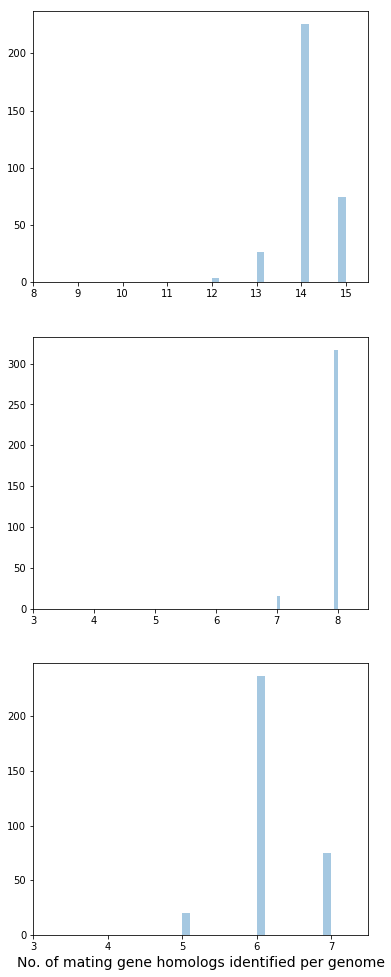

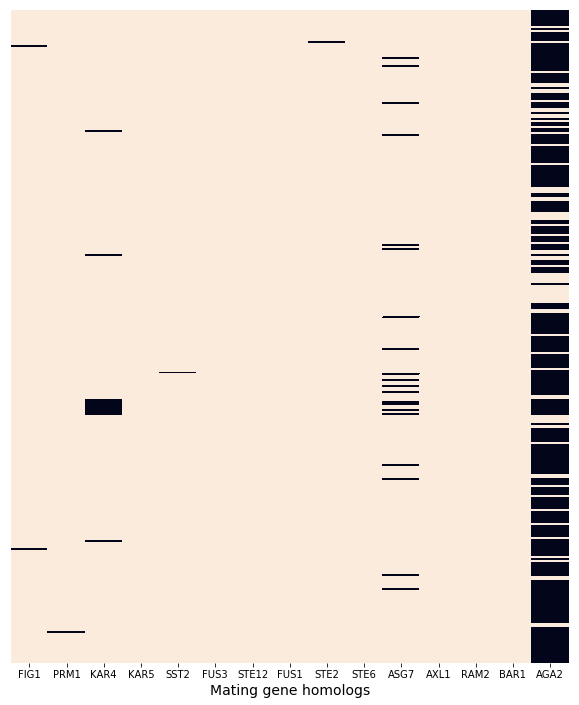

In [4]:
##Writing a quick script to read through the stats file for the identified homologs.
mating_gene_homologs_dir = os.path.join(data_dir, "matingGeneHomologPromoters")
homolog_species_stats_file = os.path.join(mating_gene_homologs_dir, "hmmsearch_best_stats.csv")
homolog_species_stats = pd.read_csv(homolog_species_stats_file, sep="\t", index_col=0)
print(homolog_species_stats[['FIG1', 'PRM1', 'KAR4', 'KAR5', 'SST2', 'FUS3', 'STE12', 'FUS1', 'STE2', 'STE6', 'ASG7', 'AXL1', 'RAM2', 'BAR1', 'AGA2']].sum())
#promoter_species_stats.head()
print(list(homolog_species_stats.columns))

fig1 = figure(figsize=(6,17))
ax1 = subplot(311)
ax1 = sns.distplot(homolog_species_stats['Total'], kde=False, axlabel=False)
plt.xlim(8,15.5)

ax2 = subplot(312)
ax2 = sns.distplot(homolog_species_stats['pheromoneActivated'], kde=False, axlabel=False)
plt.xlim(3,8.5)

ax3 = subplot(313)
ax3 = sns.distplot(homolog_species_stats['aSpecific'], kde=False)
plt.xlim(3,7.5)
ax3.xaxis.set_major_locator(MaxNLocator(integer=True))
plt.xlabel("No. of mating gene homologs identified per genome", fontsize=14);
#savefig(os.path.join(figure_dir, '332yeast_species_homologs_200428.png'), dpi=300, transparent=True)

homolog_species_stats_heatmap = homolog_species_stats[['FIG1', 'PRM1', 'KAR4', 'KAR5', 'SST2', 'FUS3', 'STE12', 'FUS1', 'STE2', 'STE6', 'ASG7', 'AXL1', 'RAM2', 'BAR1', 'AGA2']]
fig2 = figure(figsize=(10,12))
ax2 = sns.heatmap(homolog_species_stats_heatmap, cbar=False, yticklabels=False)
plt.xlabel("Mating gene homologs", fontsize=14);
#savefig(os.path.join(figure_dir, '332yeast_species_homologs-byGene_210420.pdf'), dpi=300, transparent=True)

### Code-chunk that is used to process promoters from fungal species (332 yeast)
This section has code blocks that perform the following functions:  
1. Function to pool the mating regulatory regions of species within the expected the time horizon where mating TF motifs are conserved. The time horizon was done by comparing the largest divergence time between species in clades from Sorrells et al, that showed conserved STE12 motif in aSpecific genes. This time horizon was identified in my 'pheromoneFinder_py3-testbed.ipynb' in the 'notebooks' folder.
  1. Copy of above function in order to pool the regulatory regions of the candidates identified by the other functions of {pheromoneFinder}. The groups are identified by the time horizon associated with the Saccharomyces clade from Sorrells.
2. Function to separate promoters of 'pheromoneActivatedGenes' & 'aSpecificGenes' as identified in my HMM dictionary file that was used to setup the hmmbuild and hmmsearch. These genes were identified in Sorrells et al and I've just mimiced the homolog discovery pipeline they described in their methods.
3. Function to measure statistic of the number of promoters identified for each file (species or phylogenetic clade/group) in the promoter folder. This is a validation table that will be needed for the paper's supplementary.
4. Function to strip (") characters from sequence IDs since it messes with the parsing of the xml output from meme.

In [29]:
##This block mimics the function of <pheromoneFinder/phyloGroup>, and has been modified to work on the promoters dir of homologous mating proteins.
##The function has the following inputs:
    ###promoter_dir = The directory containing the fasta files of promoters. Each file corresponds to a species with the promoters of the mating gene homologs identified in that genome.
    ###phylogroup_regulation_list_dir = The directory containing .txt. files of the phhylogenetic groups that share a common ancestor before the time-horizon of mating regultion conservation.
tree_dir = os.path.join(data_dir, "matingGeneHomologPromoters")
candidate_promoter_dir = os.path.join(tree_dir, "promoters")
phylogroup_regulation_list_dir = os.path.join(tree_dir, "PhyloGroups_candidate_regulation")
phylogroup_regulation_file_list = [f for f in os.listdir(phylogroup_regulation_list_dir)]
#print(phylogroup_regulation_file_list)

for file_list in phylogroup_regulation_file_list:
    print("Working on ", file_list.split(".txt")[0], " that contains species that are presumed to share mating TF motifs.")
    speciesFileList = []
    #print inputHandle.readline()
    with open(os.path.join(phylogroup_regulation_list_dir, file_list), "r") as input_handle:
        speciesFileList = input_handle.read().split("\n")
        speciesFileList.remove("")
    #print(speciesFileList)
    
    print speciesFileList, "\n which contains ", len(speciesFileList), " species!\n"
    regulatory_phylo_group_candidates = []
    for speciesFile in speciesFileList:
        #This is to pool only the largest candidate per CAAX-Stop locus of Asn...CAAX-Stop candidates from speies within a PhyloGroup.
        input_file_handle = open(os.path.join(promoter_dir, speciesFile), "r")
        records = list(SeqIO.parse(input_file_handle, "fasta"))
        input_file_handle.close()
        
        ##Extending master list.
        regulatory_phylo_group_candidates.extend(records)
    
    print "Concatenated ", len(regulatory_phylo_group_candidates), " candidates in the ", file_list.split(".")[0], " phylogenetic group.\n"
    
    ##Making Output directory.
    if not(os.path.isdir(os.path.join(tree_dir, "PhyloGroup_promoters"))):
        os.mkdir(os.path.join(tree_dir, "PhyloGroup_promoters"))
    
    outputFile = os.path.join(tree_dir, "PhyloGroup_promoters", "promoters_0_"+file_list.split(".")[0]+".fasta")
    outputHandle = open(outputFile, "w")
    for candidate in regulatory_phylo_group_candidates:
        outputHandle.write(">"+str(candidate.id)+"\n"+str(candidate.seq)+"\n")
    outputHandle.close()

('Working on ', 'phyloGroup_1', ' that contains species that are presumed to share mating TF motifs.')
['promoters_0_yHMPu5000041678_debaryomyces_prosopidis_160928.fasta', 'promoters_0_yHMPu5000041829_debaryomyces_fabryi_160928.fasta', 'promoters_0_yHMPu5000041824_debaryomyces_subglobosus_160928.fasta', 'promoters_0_debaryomyces_hansenii.fasta', 'promoters_0_yHMPu5000041693_debaryomyces_nepalensis_160928.fasta', 'promoters_0_yHMPu5000041713_debaryomyces_maramus_160928.fasta', 'promoters_0_millerozyma_acaciae.fasta'] 
 which contains  7  species!

Concatenated  98  candidates in the  phyloGroup_1  phylogenetic group.

('Working on ', 'phyloGroup_12', ' that contains species that are presumed to share mating TF motifs.')
['promoters_0_yHMPu5000034918_nakazawaea_holstii_160519.fasta', 'promoters_0_nakazawaea_peltata.fasta'] 
 which contains  2  species!

Concatenated  28  candidates in the  phyloGroup_12  phylogenetic group.

('Working on ', 'phyloGroup_13', ' that contains species that a

In [6]:
##This block mimics the function of <pheromoneFinder/phyloGroup>, and has been modified to work on the promoters dir of candidate pheromones.
##The function has the following inputs:
    ###promoter_dir = The directory containing the fasta files of promoters. Each file corresponds to a species with the promoters of the mating gene homologs identified in that genome.
    ###phylogroup_regulation_list_dir = The directory containing .txt. files of the phhylogenetic groups that share a common ancestor before the time-horizon of mating regultion conservation.
tree_dir = os.path.join(data_dir, "candidatePromoters")
promoter_dir = os.path.join(tree_dir, "PromoterExtract")
phylogroup_regulation_list_dir = os.path.join(tree_dir, "PhyloGroups_candidate_regulation")
phylogroup_regulation_file_list = [f for f in os.listdir(phylogroup_regulation_list_dir) if os.path.isfile(os.path.join(tree_dir, "PhyloGroups_candidate_regulation", f))]
#print(phylogroup_regulation_file_list)

for file_list in phylogroup_regulation_file_list:
    print("Working on ", file_list.split(".txt")[0], " that contains species that are presumed to share mating TF motifs.")
    speciesFileList = []
    #print inputHandle.readline()
    with open(os.path.join(phylogroup_regulation_list_dir, file_list), "r") as input_handle:
        speciesFileList = input_handle.read().split("\n")        
        speciesFileList.remove("")
    #print(speciesFileList)
    
    print speciesFileList, "\n which contains ", len(speciesFileList), " species!\n"
    regulatory_phylo_group_candidates = []
    for speciesFile in speciesFileList:
        #This is to pool only the largest candidate per CAAX-Stop locus of Asn...CAAX-Stop candidates from speies within a PhyloGroup.
        input_file_handle = open(os.path.join(promoter_dir, speciesFile), "r")
        records = list(SeqIO.parse(input_file_handle, "fasta"))
        input_file_handle.close()
        
        ##Extending master list.
        regulatory_phylo_group_candidates.extend(records)
    
    print "Concatenated ", len(regulatory_phylo_group_candidates), " candidates in the ", file_list.split(".")[0], " phylogenetic group.\n"
    
    ##Making Output directory.
    if not(os.path.isdir(os.path.join(tree_dir, "PhyloGroup_candidate_promoters"))):
        os.mkdir(os.path.join(tree_dir, "PhyloGroup_candidate_promoters"))
    
    outputFile = os.path.join(tree_dir, "PhyloGroup_candidate_promoters", "promoters_0_candidates_0_"+file_list.split(".")[0]+".fasta")
    outputHandle = open(outputFile, "w")
    for candidate in regulatory_phylo_group_candidates:
        outputHandle.write(">"+str(candidate.id)+"\n"+str(candidate.seq)+"\n")
    outputHandle.close()

('Working on ', 'phyloGroup_1', ' that contains species that are presumed to share mating TF motifs.')
['yHMPu5000041678_debaryomyces_prosopidis_160928.fas.caax.asn.promoters', 'yHMPu5000041829_debaryomyces_fabryi_160928.fas.caax.asn.promoters', 'yHMPu5000041824_debaryomyces_subglobosus_160928.fas.caax.asn.promoters', 'debaryomyces_hansenii.fas.caax.asn.promoters', 'yHMPu5000041693_debaryomyces_nepalensis_160928.fas.caax.asn.promoters', 'yHMPu5000041713_debaryomyces_maramus_160928.fas.caax.asn.promoters', 'millerozyma_acaciae.fas.caax.asn.promoters'] 
 which contains  7  species!

Concatenated  2368  candidates in the  phyloGroup_1  phylogenetic group.

('Working on ', 'phyloGroup_12', ' that contains species that are presumed to share mating TF motifs.')
['yHMPu5000034918_nakazawaea_holstii_160519.fas.caax.asn.promoters', 'nakazawaea_peltata.fas.caax.asn.promoters'] 
 which contains  2  species!

Concatenated  789  candidates in the  phyloGroup_12  phylogenetic group.

('Working on ',

In [8]:
##I've decided to run MEME on the promoter collections by separating into those that corresponding to pheromone-activated genes and a-specific genes (as identified in Sorrells et al)
##The function will be writted to work on the directory of the promoter fasta files, read in each file scan through the records, check the seq.id and then append to twp different
##FASTA Lists depending on the seq.id.split("|/|") value.
###The input values into this function are:
    ###promoter_dir = This is the folder that contains the FASTA files of the promoters of different species or different phyloGroups
    ###hmm_dict_file = This is the dictionary file of the mating genes whoose homologs were found in various fungi. The genes belong to two classes: 'pheromoneActivatedGenes' & 'aSpecificGenes'
hmm_dict_file = os.path.join(hmm_dir, "Scer-matingGenes_phmmer_200416.csv")
promoter_dir = os.path.join(data_dir, "matingGeneHomologPromoters", "promoters")

####Reading in the dictionary file into a pandqas dataframe
hmm_dict = pd.read_csv(hmm_dict_file)

promoter_fasta_file_list = [f for f in os.listdir(promoter_dir) if f.endswith(".fasta")]

for promoter_fasta_file in promoter_fasta_file_list:
    input_fasta_file_handle = open(os.path.join(promoter_dir, promoter_fasta_file), "r")
    records = list(SeqIO.parse(input_fasta_file_handle, "fasta"))
    input_fasta_file_handle.close()
    
    ####Making blank lists for the Bio.Seq.SeqRecord lists of 'pheromoneActivatedGenes' & 'aSpecificGenes'
    pheromone_activated_promoters = []
    a_specific_promoters = []
    
    for record in records:
        #print(record.id.split("|/|")[0].split(">")[-1])
        #print((hmm_dict[hmm_dict['GeneName'] == record.id.split("|/|")[0].split(">")[-1]]['Category'].values) == "pheromoneActivatedGenes")
        ####Adding the promoter to the appropriate file list.
        if ((hmm_dict[hmm_dict['GeneName'] == record.id.split("|/|")[0].split(">")[-1]]['Category'].values) == "pheromoneActivatedGenes"):
            pheromone_activated_promoters.append(FASTAStructureMinimal(record.id, record.seq))
        elif ((hmm_dict[hmm_dict['GeneName'] == record.id.split("|/|")[0].split(">")[-1]]['Category'].values) == "aSpecificGenes"):
            a_specific_promoters.append(FASTAStructureMinimal(record.id, record.seq))
    print("Done categorizing "+str(len(records))+" promoters from "+promoter_fasta_file.split(".fasta")[0]+".")
    
    ####Printing out the categorized fasta lists into their own directories.
    ####For 'pheromoneActivatedGenes'
    if not(os.path.isdir(os.path.join(promoter_dir, "..", "pheroAct_"+promoter_dir.split("/")[-1]))):
        os.mkdir(os.path.join(promoter_dir, "..", "pheroAct_"+promoter_dir.split("/")[-1]))
    output_dir = os.path.join(promoter_dir, "..", "pheroAct_"+promoter_dir.split("/")[-1])
    output_fasta_file_hasndle = open(os.path.join(output_dir, "pheroAct_"+promoter_fasta_file), "w")
    for promoter in pheromone_activated_promoters:
        output_fasta_file_hasndle.write(">"+str(promoter.id)+"\n"+str(promoter.seq)+"\n")
    output_fasta_file_hasndle.close()
    
    ####For 'aSpecificGenes'
    if not(os.path.isdir(os.path.join(promoter_dir, "..", "aSpec_"+promoter_dir.split("/")[-1]))):
        os.mkdir(os.path.join(promoter_dir, "..", "aSpec_"+promoter_dir.split("/")[-1]))
    output_dir = os.path.join(promoter_dir, "..", "aSpec_"+promoter_dir.split("/")[-1])
    output_fasta_file_hasndle = open(os.path.join(output_dir, "aSpec_"+promoter_fasta_file), "w")
    for promoter in a_specific_promoters:
        output_fasta_file_hasndle.write(">"+str(promoter.id)+"\n"+str(promoter.seq)+"\n")
    output_fasta_file_hasndle.close()

Done categorizing 14 promoters from promoters_0_alloascoidea_hylecoeti.
Done categorizing 14 promoters from promoters_0_ambrosiozyma_kashinagacola.
Done categorizing 14 promoters from promoters_0_ambrosiozyma_monospora.
Done categorizing 14 promoters from promoters_0_arxula_adeninivorans.
Done categorizing 14 promoters from promoters_0_ascoidea_asiatica.
Done categorizing 14 promoters from promoters_0_ascoidea_rubescens.
Done categorizing 14 promoters from promoters_0_ashbya_aceri.
Done categorizing 14 promoters from promoters_0_babjeviella_inositovora.
Done categorizing 15 promoters from promoters_0_brettanomyces_anomalus.
Done categorizing 14 promoters from promoters_0_candida_albicans.
Done categorizing 15 promoters from promoters_0_candida_apicola.
Done categorizing 14 promoters from promoters_0_candida_arabinofermentans.
Done categorizing 14 promoters from promoters_0_candida_auris.
Done categorizing 14 promoters from promoters_0_candida_boidinii_JCM9604.
Done categorizing 14 prom

In [10]:
##Function to read through the fasta files of promoters in a folder and output the list of promoters identified accross species or phylogenetic groups.
##The input values into this function are:
    ###promoter_dir = This is the folder that contains the FASTA files of the promoters of different species or different phyloGroups
    ###hmm_dict_file = This is the dictionary file of the mating genes whoose homologs were found in various fungi. The genes belong to two classes: 'pheromoneActivatedGenes' & 'aSpecificGenes'
hmm_dict_file = os.path.join(hmm_dir, "Scer-matingGenes_phmmer_200416.csv")
promoter_dir = os.path.join(data_dir, "matingGeneHomologPromoters", "promoters")

####Reading in the dictionary file into a pandqas dataframe
hmm_dict = pd.read_csv(hmm_dict_file)

promoter_fasta_file_list = [f for f in os.listdir(promoter_dir) if f.endswith(".fasta")]
promoter_stats = pd.DataFrame()

for promoter_fasta_file in promoter_fasta_file_list:
    input_fasta_file_handle = open(os.path.join(promoter_dir, promoter_fasta_file), "r")
    records = list(SeqIO.parse(input_fasta_file_handle, "fasta"))
    input_fasta_file_handle.close()
    
    ####Making a blank dict for the promoter stats of the current file.
    promoter_key = ["phylogeneticName", "Total", "pheromoneActivated", "aSpecific"] + list(hmm_dict['GeneName'].values)
    ###print(promoter_key) == 
    ###['Total', 'pheromoneActivated', 'aSpecific', 'FIG1', 'PRM1', 'KAR4', 'KAR5', 'SST2', 'FUS3', 'STE12', 'FUS1', 'STE2', 'STE6', 'ASG7', 'AXL1', 'RAM2', 'BAR1', 'AGA2']
    promoter_stats_dict = collections.OrderedDict()
    for column in promoter_key:
        promoter_stats_dict[column] = 0
    ###print(promoter_stats_dict)
    
    for record in records:
        ####Checking the promoter identity to appropriately record the stats.
        if ((hmm_dict[hmm_dict['GeneName'] == record.id.split("|/|")[0].split(">")[-1]]['Category'].values) == "pheromoneActivatedGenes"):
            promoter_stats_dict['pheromoneActivated'] += 1
        elif ((hmm_dict[hmm_dict['GeneName'] == record.id.split("|/|")[0].split(">")[-1]]['Category'].values) == "aSpecificGenes"):
            promoter_stats_dict['aSpecific'] += 1
        promoter_stats_dict[record.id.split("|/|")[0].split(">")[-1]] +=1
        promoter_stats_dict['Total'] += 1
    promoter_stats_dict['phylogeneticName'] = promoter_fasta_file.split(".fasta")[0].split("_0_")[-1]
    promoter_stats_temp_frame = pd.DataFrame(promoter_stats_dict, index=[0])
    ###print("Done categorizing "+str(len(records))+" promoters from "+promoter_fasta_file.split(".fasta")[0]+".")
    promoter_stats = promoter_stats.append(promoter_stats_temp_frame, ignore_index=True)
    ###print(promoter_stats)
output_csv_file = os.path.join(promoter_dir, "..", promoter_dir.split("/")[-1]+"_stats.csv")
promoter_stats.to_csv(output_csv_file, sep="\t", header=True)
print("Done analyzing "+str(len(promoter_stats))+" phylogenetic group\'s promoters and made the statstics file "+output_csv_file+" .")

Done analyzing 332 phylogenetic group's promoters and made the statstics file /home/ssrikant/WindowsFiles/Fungi_pheromoneFinder/Cluster/matingGeneHomologPromoters/promoters/../promoters_stats.csv .


['phylogeneticName', 'Total', 'pheromoneActivated', 'aSpecific', 'FIG1', 'PRM1', 'KAR4', 'KAR5', 'SST2', 'FUS3', 'STE12', 'FUS1', 'STE2', 'STE6', 'ASG7', 'AXL1', 'RAM2', 'BAR1', 'AGA2']


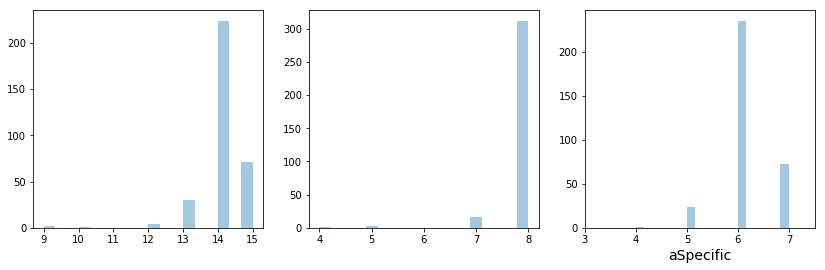

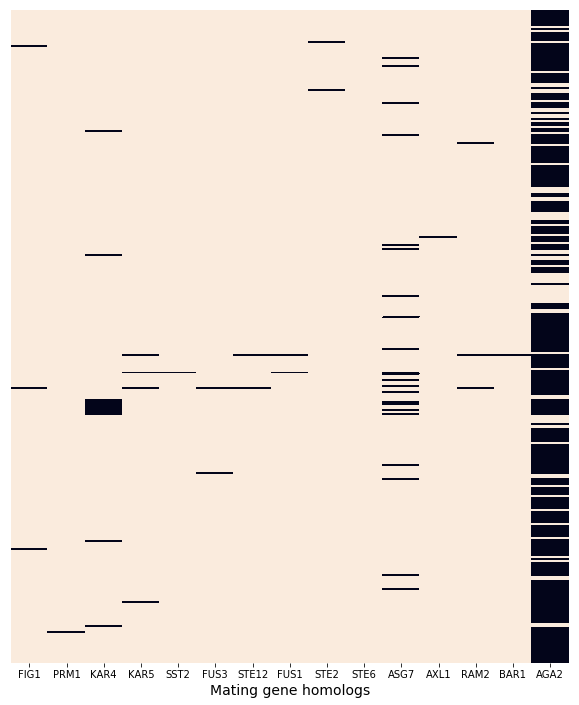

In [87]:
##Writing a quick script to read through the stats file for the identified promoters.
promoter_species_stats_file = os.path.join(data_dir, "matingGeneHomologPromoters", "promoters_stats.csv")
promoter_species_stats = pd.read_csv(promoter_species_stats_file, sep="\t", index_col=0)

#promoter_species_stats.head()
print(list(promoter_species_stats.columns))

fig1, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(14,4))
sns.distplot(promoter_species_stats['Total'], kde=False, axlabel=False, ax=ax1)
plt.xlim(8,15.5)

sns.distplot(promoter_species_stats['pheromoneActivated'], kde=False, axlabel=False, ax=ax2)
plt.xlim(3,8.5)
plt.xlabel("No. of mating gene homologs identified per genome", fontsize=14);

sns.distplot(promoter_species_stats['aSpecific'], kde=False, ax=ax3)
plt.xlim(3,7.5)
ax3.xaxis.set_major_locator(MaxNLocator(integer=True))

#savefig(os.path.join(figure_dir, '332yeast_species_promoters_210913.png'), dpi=300, transparent=True)

promoter_species_stats_heatmap = promoter_species_stats[['FIG1', 'PRM1', 'KAR4', 'KAR5', 'SST2', 'FUS3', 'STE12', 'FUS1', 'STE2', 'STE6', 'ASG7', 'AXL1', 'RAM2', 'BAR1', 'AGA2']]
fig2 = figure(figsize=(10,12))
ax2 = sns.heatmap(promoter_species_stats_heatmap, cbar=False, yticklabels=False)
plt.xlabel("Mating gene homologs", fontsize=14);
#savefig(os.path.join(figure_dir, '332yeast_species_promoters-byGene_210913.pdf'), dpi=300, transparent=True)

In [150]:
#Obsolete code since this functionality has been incorporated into the matingGeneHomologPromoters function/code-cell.
# ##Function to read through the fasta files of promoters in a folder and output the promoter FASTA files after stripping (") character in the sequence IDs.
# ##I am going to incorporate this replacement directly in the <pheromoneFinder/matingGeneHomologPromoters> function, tested here and now made changes to the function in the python script
# ##of the cluster and also in the corresponding code-block above.
# ##The input values into this function are:
#     ###promoter_dir = This is the folder that contains the FASTA files of the promoters of different species or different phyloGroups
# promoter_dir = os.path.join(tree_dir, "../promoters")
# promoter_fasta_file_list = [f for f in os.listdir(promoter_dir) if f.endswith(".fasta")]

# if not(os.path.isdir(os.path.join(tree_dir, "../promoters_corr"))):
#     os.mkdir(os.path.join(tree_dir, "../promoters_corr"))

# corrected_promoter_dir = os.path.join(tree_dir, "../promoters_corr")

# for promoter_fasta_file in promoter_fasta_file_list:
#     input_fasta_file_handle = open(os.path.join(promoter_dir, promoter_fasta_file), "r")
#     records = list(SeqIO.parse(input_fasta_file_handle, "fasta"))
#     input_fasta_file_handle.close()
    
#     output_fasta_file_hasndle = open(os.path.join(corrected_promoter_dir, promoter_fasta_file), "w")
#     for promoter in records:
#         output_fasta_file_hasndle.write(">"+str(promoter.id.replace('"', ''))+"\n"+str(promoter.seq)+"\n")
#     output_fasta_file_hasndle.close()

----
1. I've managed to write a decent bit of code blocks to parse the promoters of presumed (hmmsearch + tBLASTN) mating gene homologs from the 332 fungal genomes in Saccharomycotina that I started with. Additionally I estimated the time horizon of mating TF motif conservation to be 180 units along the rel_time tree from Shen XX et al, Cell (2018) corresponding to the time of the last common ancestor of the Saccharomyces lineage as described in Sorrells TR et al, Nature (2016). 
2. The promoters are now in different directories under the 'tree' folder and can be moved to the 'meme' folder for further analysis. Eventually I want all of these to be added as functions to the base <pheromoneFinder.py> code-base I have.
3. There are 37 phylogenetic groups identified with the Sorrells time-horizon that have at least 2 species within them.
----
----

### Using meme wrapper to identify motifs in promoters using MEME-5.1.1 locally
Started on [20200423], wrapper from Peter Culviner (github.com/peterculviner)
1. Initially wrote the function to loop through the promoters identified from S. cerevisiae and the Saccharomyces clade (phylogroup 27).
2. I have modified the wrapper from peter to ouput to directories with the name of the corresponding input_promoters_fasta_file in a new directory 'meme_temp' in the base folder (above the dir containing the fasta files.)
3. I need to figure out how to best output the motifs identified by MEME in order to use them for a MAST search against the promoters that I have found in the corresponding clades. I need to repeat the <pheromoneFinder/phyloGroupCandidates> function on species pheromone candidates (.fas.caax.asn files) with the phyloGroups made with regulation to see if I find the motifs upstream of the pheromone candidates identified in the clades where regulation is expected to be conserved.
  1. From the web-server there seems to be a form of output for each motif that is a .txt file that can be read in by MAST but from the 'meme -h' that I have run below there is no obvious command to get this output. So I am an idiot; the full .txt output file is what can read in by FIMO and other programs.
  
##### Functions in this code-section:
1. Running MEME-5.1.1 by using the wrapper from Peter Culviner. I've modified his wrapper to save outputs, one for each input promoter_fasta_file in the 'meme_temp' directory. This is especially important since the meme.txt output file is what I need to use as an input into FIMO.
2. Efforts to convert MEME output to the minimal MEME txt output are obsolete since I can use the full output file as the input to FIMO.
3. Function to analyze the MEME outputs and give me a CSV for further plotting and analysis.
  1. Function to plot results from MEME runs across species and phylogenetic groups.
4. Function to test FIMO locally is not great since the fimo binary seems to have a bug where I get a "buffer overflow; core dumped" error message. I have verified that the meme-suite module on Odyssey 2.0 (bio/meme-4.9.0_4) functions well, I am going to write code to run these on the server directly.
5. Function to analyze the results of FIMO run with the motifs from mating gene promoters against the promoters (upstream 1000bp) of candidates identified in the same species or phylogenetic group (where regulatory motifs are expected to be conserved, e.g. Saccharomyces)

In [160]:
##This is a quick code-block to test the meme run on S. cerevisiae mating promoters and also the phylogroup containing S. cerevisiae,
##(phyloGroup_27, this corresponds to Saccharomyces from Sorrells).
##I need to figure out what the ouput is to these functions.
meme_dir = os.path.join(data_dir, "meme")
meme_fasta_dir = os.path.join(meme_dir, "PhyloGroup_promoters")
meme_fasta_file_list = [f for f in os.listdir(meme_fasta_dir) if (f.endswith(".fasta"))]
print("The fasta files on which I need to run MEME are:")
print("\n".join(meme_fasta_file_list))

for meme_fasta_file in meme_fasta_file_list:
    if (meme_fasta_file.startswith("promoters_0_")):
        print("\nWorking on the promoters of "+meme_fasta_file.split(".fasta")[0].split("promoters_0_")[-1]+".")
    elif (meme_fasta_file.startswith("aSpec_promoters_0") or meme_fasta_file.startswith("pheroAct_promoters_0")):
        print("\nWorking on the "+meme_fasta_file.split(".fasta")[0].split("_")[0]+" promoters of "+meme_fasta_file.split(".fasta")[0].split("promoters_0_")[-1]+".")
    motif_details, motif_scores, motif_frequencies, motif_regex, counts, bg_frequencies = memewrapper(os.path.join(meme_fasta_dir, meme_fasta_file))
    print(motif_details)
    print(motif_regex)

The fasta files on which I need to run MEME are:
promoters_0_phyloGroup_1.fasta
promoters_0_phyloGroup_12.fasta
promoters_0_phyloGroup_13.fasta
promoters_0_phyloGroup_14.fasta
promoters_0_phyloGroup_15.fasta
promoters_0_phyloGroup_17.fasta
promoters_0_phyloGroup_19.fasta
promoters_0_phyloGroup_2.fasta
promoters_0_phyloGroup_20.fasta
promoters_0_phyloGroup_21.fasta
promoters_0_phyloGroup_24.fasta
promoters_0_phyloGroup_25.fasta
promoters_0_phyloGroup_26.fasta
promoters_0_phyloGroup_27.fasta
promoters_0_phyloGroup_28.fasta
promoters_0_phyloGroup_3.fasta
promoters_0_phyloGroup_30.fasta
promoters_0_phyloGroup_31.fasta
promoters_0_phyloGroup_32.fasta
promoters_0_phyloGroup_35.fasta
promoters_0_phyloGroup_36.fasta
promoters_0_phyloGroup_37.fasta
promoters_0_phyloGroup_38.fasta
promoters_0_phyloGroup_4.fasta
promoters_0_phyloGroup_42.fasta
promoters_0_phyloGroup_44.fasta
promoters_0_phyloGroup_46.fasta
promoters_0_phyloGroup_5.fasta
promoters_0_phyloGroup_50.fasta
promoters_0_phyloGroup_52.fa

In [15]:
##Function to test output of MEME by parsexml and use matrix2meme to produce a MOTIF txt file for use with FIMO.
meme_xml_base_dir = os.path.join(data_dir, "meme", "meme_output", "phyloGroup")
meme_output_dir_list = [d for d in os.listdir(meme_xml_base_dir) if (os.path.isdir(os.path.join(meme_xml_base_dir, d)) and not(d.startswith(".")))]

#print(meme_output_dir_list)
#for meme_output_dir in meme_output_dir_list:
meme_output_dir = "promoters_0_phyloGroup_1"
print("Scanning:\t", meme_output_dir)
motif_details, motif_scores, motif_frequencies, motif_regex, counts, bg_frequencies = parsememexml(os.path.join(meme_xml_base_dir, meme_output_dir, 'meme.xml'))
print([str(i) for i in (motif_frequencies[0])])
print(motif_regex)
print(motif_details)
    
##This was my attempt to output the freq matrix of motifs from the XML output of meme into ASCII files to use matrix2meme. Turns out FIMO can use the .txt output of MEME directly
##as a motif file. So this is not relevant.
#ouput_dir = meme_xml_base_dir
#output_handle = open(os.path.join(meme_xml_base_dir, "test.out"), "w")
#for row in motif_frequencies[0]:
#    for element in row:
#        output_handle.write(str(element)+"\t")
#    output_handle.write("\n")
#output_handle.close()

xml_path = os.path.join(meme_xml_base_dir, meme_output_dir, "meme.xml")
open_xml = ET.parse(xml_path)
found_motifs = open_xml.getroot().find('motifs')
for motif in found_motifs:
    print(motif.attrib['name']+"\t"+motif.attrib['width']+"\t"+motif.attrib['e_value'])
    ##+"\t"+motif.attrib['p_value'] No p_value attribute in MEME 4.9.0 (used on Odyssey)
    
    sys.exit()

('Scanning:\t', 'promoters_0_phyloGroup_1')
['[  nan   nan   nan 0.125]', '[nan nan nan  0.]', '[nan nan nan  0.]', '[nan nan nan  0.]', '[nan nan nan  0.]', '[nan nan nan  0.]', '[nan nan nan  1.]', '[nan nan nan  1.]', '[nan nan nan  0.]', '[nan nan nan  0.]']
['CCCGGGTTCG', '[AT]TCTGAAACA', 'C[TC][AT]G[CT]ACC[GA][TG]']
[['1', '10', '8.9e-001'], ['2', '10', '6.1e-001'], ['3', '10', '4.8e-002']]
1	10	8.9e-001


SystemExit: 

In [16]:
##On [201228], modifying the code below to generate the meme-stats.csv in my sager since the xps15 died. I think this should work with just a quick change of the input directory,
##while also modifying the name of the older phyloGroup run of 200428, to start with ".old-run_"

##Function to scan through the meme_output_dir, read through the meme.xml output in the directory for each meme run and outputting the relevant parameters into a csv file.
##The goal of this is to get appropriate statistics of the different meme_outputs from the mating gene promoter fasta files.
##Columns = ['PhylogeneticName', 'Category', 'Motif#', 'MotifName', 'MotifWidth', 'MotifeVal', 'MotifpVal', 'MotifRegex']
##The input files are the following:
    ###meme_output_dir = The base directory containing the outputs from MEME.
meme_output_dir = os.path.join(data_dir, "meme", "meme_output")
meme_cat_dir_list = [d for d in os.listdir(meme_output_dir) if (os.path.isdir(os.path.join(meme_output_dir, d)) and not(d.startswith(".")))]
#print(meme_cat_dir_list)

for meme_cat_dir in meme_cat_dir_list:
    ###Defining a dataframe for the statistics.
    meme_stats = pd.DataFrame()
    dict_key = ['PhylogeneticName', 'Category', 'Motif#', 'MotifName', 'MotifWidth', 'MotifeVal', 'MotifRegex']
    meme_promoter_stats_dict = collections.OrderedDict()
    for column in dict_key:
        meme_promoter_stats_dict[column] = 0
    
    meme_run_dir_list = [d for d in os.listdir(os.path.join(meme_output_dir, meme_cat_dir)) if (os.path.isdir(os.path.join(meme_output_dir, meme_cat_dir, d)))]
    #print(meme_run_dir_list)
    temp_cat_dir = os.path.join(meme_output_dir, meme_cat_dir)
    for meme_run_dir in meme_run_dir_list:
        ###Running the MEME XML parser to extract the motifs and their statistics.
        if os.path.isfile(os.path.join(temp_cat_dir, meme_run_dir, 'meme.xml')):
            motif_details, motif_scores, motif_frequencies, motif_regex, counts, bg_frequencies = parsememexml(os.path.join(temp_cat_dir, meme_run_dir, 'meme.xml'))
            
            #print(motif_details)
            for motif_number in range(len(motif_details)):
                ##Intializing empty dictionary for each motif.
                meme_promoter_stats_dict = collections.OrderedDict()
                for column in dict_key:
                    meme_promoter_stats_dict[column] = 0
                
                #print(motif_details[motif_number])
                ###Specifying all relevant values for dictionary.
                ####For 'PhylogeneticName' from the output directory name
                meme_promoter_stats_dict['PhylogeneticName'] = meme_run_dir.rstrip("/").split("promoters_0_")[-1]
                
                ####For the 'Category' from the start of the output directory name
                #print(meme_run_dir.rstrip("/").split("_")[0])
                if (meme_run_dir.rstrip("/").split("_")[0] == "promoters"):
                    meme_promoter_stats_dict['Category'] = "All"
                else:
                    meme_promoter_stats_dict['Category'] = meme_run_dir.rstrip("/").split("_")[0]
                
                ####For the 'Motif#', the loop number of the motif.
                meme_promoter_stats_dict['Motif#'] = motif_number
                
                ####For the 'MotifName', 'MotifWidth', 'MotifeVal', 'MotifpVal' & 'MotifRegex' the details from parsememexml
                meme_promoter_stats_dict['MotifName'] = motif_details[motif_number][0]
                meme_promoter_stats_dict['MotifWidth'] = motif_details[motif_number][1]
                meme_promoter_stats_dict['MotifeVal'] = motif_details[motif_number][2]
                #meme_promoter_stats_dict['MotifpVal'] = motif_details[motif_number][3] #Not present in the meme-4.9.0 run.
                meme_promoter_stats_dict['MotifRegex'] = motif_regex[motif_number]
                
                meme_stats = meme_stats.append(pd.DataFrame(meme_promoter_stats_dict, index=[0]), ignore_index=True)
                #print(meme_stats)
                
        else:
            print("Missing MEME output for "+str(meme_run_dir.rstrip("/"))+", no results will be saved.")
    
    ###The sorting is done by string sortin, this is unfortunate since phylogroup_10 is close to phylogroup_1, what I would ideally like is apparently called a "human sort" (https://stackoverflow.com/questions/5967500/how-to-correctly-sort-a-string-with-a-number-inside)
    ###I couldn't figure out a way to use my own sorting function in a dataframe and this doesn't seem like the thing I should spend my time on.
    meme_stats = meme_stats.sort_values(by=['PhylogeneticName', 'Category', 'Motif#']).reset_index(drop=True)
    
    output_csv_file = os.path.join(meme_output_dir, meme_cat_dir.rstrip("/")+"_meme-stats.csv")
    meme_stats.to_csv(output_csv_file, sep="\t", header=True)
    print("Done analyzing "+str(len(meme_stats))+" motif\'s from "+
          str(len([d for d in os.listdir(os.path.join(meme_output_dir, meme_cat_dir)) if (os.path.isdir(os.path.join(meme_output_dir, meme_cat_dir, d)) and d.startswith("promoters_0_"))]))+
          " group\'s promoters, also with "+
          str(len([d for d in os.listdir(os.path.join(meme_output_dir, meme_cat_dir)) if (os.path.isdir(os.path.join(meme_output_dir, meme_cat_dir, d)) and d.startswith("aSpec"))]))+
          " group\'s promoters of a-specific genes and "+
          str(len([d for d in os.listdir(os.path.join(meme_output_dir, meme_cat_dir)) if (os.path.isdir(os.path.join(meme_output_dir, meme_cat_dir, d)) and d.startswith("pheroAct"))]))+
          " group\'s promoters of pheromone-activated genes. All the data has been saved to the statstics file in the meme_output directory, "+output_csv_file.rstrip(".csv")+".")

Done analyzing 333 motif's from 37 group's promoters, also with 37 group's promoters of a-specific genes and 37 group's promoters of pheromone-activated genes. All the data has been saved to the statstics file in the meme_output directory, ../../../pheromoneFinder_data/Cluster/meme/meme_output/phyloGroup_meme-stat.
Done analyzing 2988 motif's from 332 group's promoters, also with 332 group's promoters of a-specific genes and 332 group's promoters of pheromone-activated genes. All the data has been saved to the statstics file in the meme_output directory, ../../../pheromoneFinder_data/Cluster/meme/meme_output/species_meme-stat.


In [11]:
##On [201228], modifying the code below to generate the meme-stats.csv in my sager since the xps15 died. I think this should work with just a quick change of the input directory,
##while also modifying the name of the older phyloGroup run of 200428, to start with ".old-run_"
##On [210620], modifying to run in xps15 but generate the stats file in the GoogleDrive folder. I am going to make a separate meme-stats file for only significant stats,
##i.e. those with the e-value < 0.01.

##Function to scan through the meme_output_dir, read through the meme.xml output in the directory for each meme run and outputting the relevant parameters into a csv file.
##The goal of this is to get appropriate statistics of the different meme_outputs from the mating gene promoter fasta files.
##Columns = ['PhylogeneticName', 'Category', 'Motif#', 'MotifName', 'MotifWidth', 'MotifeVal', 'MotifpVal', 'MotifRegex']
##The input files are the following:
    ###meme_output_dir = The base directory containing the outputs from MEME.
meme_output_dir = os.path.join(data_dir, "meme", "meme_output")
meme_cat_dir_list = [d for d in os.listdir(meme_output_dir) if (os.path.isdir(os.path.join(meme_output_dir, d)) and not(d.startswith(".")))]
#print(meme_cat_dir_list)

for meme_cat_dir in meme_cat_dir_list:
    ###Defining a dataframe for the statistics.
    meme_stats = pd.DataFrame()
    meme_significant_stats = pd.DataFrame()
    dict_key = ['PhylogeneticName', 'Category', 'Motif#', 'MotifName', 'MotifWidth', 'MotifeVal', 'MotifRegex']
    meme_promoter_stats_dict = collections.OrderedDict()
    for column in dict_key:
        meme_promoter_stats_dict[column] = 0
    
    meme_run_dir_list = [d for d in os.listdir(os.path.join(meme_output_dir, meme_cat_dir)) if (os.path.isdir(os.path.join(meme_output_dir, meme_cat_dir, d)))]
    #print(meme_run_dir_list)
    temp_cat_dir = os.path.join(meme_output_dir, meme_cat_dir)
    for meme_run_dir in meme_run_dir_list:
        ###Running the MEME XML parser to extract the motifs and their statistics.
        if os.path.isfile(os.path.join(temp_cat_dir, meme_run_dir, 'meme.xml')):
            motif_details, motif_scores, motif_frequencies, motif_regex, counts, bg_frequencies = parsememexml(os.path.join(temp_cat_dir, meme_run_dir, 'meme.xml'))
            
            #print(motif_details)
            for motif_number in range(len(motif_details)):
                ##Intializing empty dictionary for each motif.
                meme_promoter_stats_dict = collections.OrderedDict()
                for column in dict_key:
                    meme_promoter_stats_dict[column] = 0
                
                #print(motif_details[motif_number])
                ###Specifying all relevant values for dictionary.
                ####For 'PhylogeneticName' from the output directory name
                meme_promoter_stats_dict['PhylogeneticName'] = meme_run_dir.rstrip("/").split("promoters_0_")[-1]
                
                ####For the 'Category' from the start of the output directory name
                #print(meme_run_dir.rstrip("/").split("_")[0])
                if (meme_run_dir.rstrip("/").split("_")[0] == "promoters"):
                    meme_promoter_stats_dict['Category'] = "All"
                else:
                    meme_promoter_stats_dict['Category'] = meme_run_dir.rstrip("/").split("_")[0]
                
                ####For the 'Motif#', the loop number of the motif.
                meme_promoter_stats_dict['Motif#'] = motif_number
                
                ####For the 'MotifName', 'MotifWidth', 'MotifeVal', 'MotifpVal' & 'MotifRegex' the details from parsememexml
                meme_promoter_stats_dict['MotifName'] = motif_details[motif_number][0]
                meme_promoter_stats_dict['MotifWidth'] = motif_details[motif_number][1]
                meme_promoter_stats_dict['MotifeVal'] = motif_details[motif_number][2]
                #meme_promoter_stats_dict['MotifpVal'] = motif_details[motif_number][3] #Not present in the meme-4.9.0 run.
                meme_promoter_stats_dict['MotifRegex'] = motif_regex[motif_number]
                
                meme_stats = meme_stats.append(pd.DataFrame(meme_promoter_stats_dict, index=[0]), ignore_index=True)
                #print(meme_stats)
                
                #print(type(float(meme_promoter_stats_dict['MotifeVal'])))
                #sys.exit()
                
                if (float(meme_promoter_stats_dict['MotifeVal']) < 0.01):
                    meme_significant_stats = meme_significant_stats.append(pd.DataFrame(meme_promoter_stats_dict, index=[0]), ignore_index=True)
                
        else:
            print("Missing MEME output for "+str(meme_run_dir.rstrip("/"))+", no results will be saved.")
    
    ###The sorting is done by string sortin, this is unfortunate since phylogroup_10 is close to phylogroup_1, what I would ideally like is apparently called a "human sort" (https://stackoverflow.com/questions/5967500/how-to-correctly-sort-a-string-with-a-number-inside)
    ###I couldn't figure out a way to use my own sorting function in a dataframe and this doesn't seem like the thing I should spend my time on.
    meme_significant_stats = meme_significant_stats.sort_values(by=['PhylogeneticName', 'Category', 'Motif#']).reset_index(drop=True)
    
    output_csv_file = os.path.join(meme_output_dir, meme_cat_dir.rstrip("/")+"_meme-significant-stats.csv")
    meme_significant_stats.to_csv(output_csv_file, sep="\t", header=True)
    print("Done analyzing "+str(len(meme_significant_stats))+" motif\'s from "+
          str(len([d for d in os.listdir(os.path.join(meme_output_dir, meme_cat_dir)) if (os.path.isdir(os.path.join(meme_output_dir, meme_cat_dir, d)) and d.startswith("promoters_0_"))]))+
          " group\'s promoters, also with "+
          str(len([d for d in os.listdir(os.path.join(meme_output_dir, meme_cat_dir)) if (os.path.isdir(os.path.join(meme_output_dir, meme_cat_dir, d)) and d.startswith("aSpec"))]))+
          " group\'s promoters of a-specific genes and "+
          str(len([d for d in os.listdir(os.path.join(meme_output_dir, meme_cat_dir)) if (os.path.isdir(os.path.join(meme_output_dir, meme_cat_dir, d)) and d.startswith("pheroAct"))]))+
          " group\'s promoters of pheromone-activated genes. All the data has been saved to the statstics file in the meme_output directory, "+output_csv_file.rstrip(".csv")+".")

Done analyzing 133 motif's from 37 group's promoters, also with 37 group's promoters of a-specific genes and 37 group's promoters of pheromone-activated genes. All the data has been saved to the statstics file in the meme_output directory, /home/ssrikant/WindowsFiles/Fungi_pheromoneFinder/Cluster/meme/meme_output/phyloGroup_meme-significant-stat.
Done analyzing 13 motif's from 332 group's promoters, also with 332 group's promoters of a-specific genes and 332 group's promoters of pheromone-activated genes. All the data has been saved to the statstics file in the meme_output directory, /home/ssrikant/WindowsFiles/Fungi_pheromoneFinder/Cluster/meme/meme_output/species_meme-significant-stat.


In [17]:
motif_details, motif_scores, motif_frequencies, motif_regex, counts, bg_frequencies = parsememexml(os.path.join(temp_cat_dir, "aSpec_promoters_0_alloascoidea_hylecoeti", 'meme.xml'))
print(motif_regex)

['CACTTGCAT[GT]', 'GAG[CG]CACTG', '[GT]CC[TA][CG]GG[AT][GC]']


['PhylogeneticName', 'Category', 'Motif#', 'MotifName', 'MotifWidth', 'MotifeVal', 'MotifRegex']
['All' 'aSpec' 'pheroAct']
Number of regulatory motifs found in species, divided by all, pheroAct and aSpecifc mating genes:	996	996	996
['PhylogeneticName', 'Category', 'Motif#', 'MotifName', 'MotifWidth', 'MotifeVal', 'MotifRegex']
['All' 'aSpec' 'pheroAct']
Number of regulatory motifs found in regulation-based phylogroups:	333
Number of regulatory motifs found in mating-regulation phylogroups, divided by all, pheroAct and aSpecifc mating genes:	111	111	111
Number of regulatory motifs found in regulation-based phylogroups that are significant, e-value <= 1e-2:	133
   PhylogeneticName  Category  Motif#  MotifName  MotifWidth  MotifeVal  \
9     phyloGroup_12       All       0          1          10       25.0   
10    phyloGroup_12       All       1          2          10     4800.0   
11    phyloGroup_12       All       2          3          10   210000.0   
12    phyloGroup_12     aSpec 

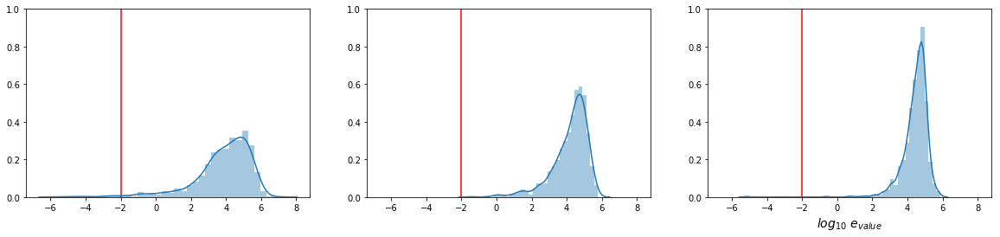

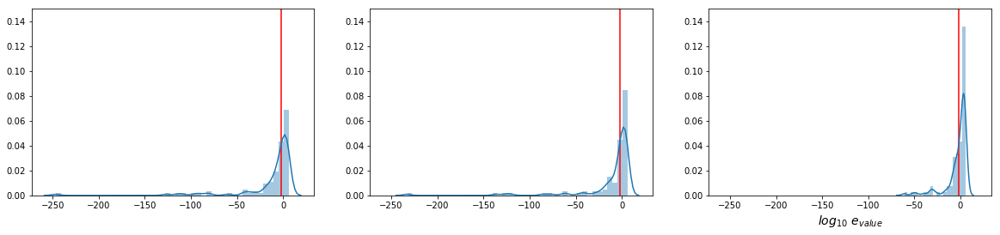

In [17]:
##Plotting some statistics from the MEME-4.9.0 run on Odyssey across species and phylogenetic groups.
meme_species_stats_file = os.path.join(data_dir, "meme", "meme_output", "species_meme-stats.csv")
meme_species_stats = pd.read_csv(meme_species_stats_file, sep="\t", index_col=0)
print(list(meme_species_stats.columns))
print(meme_species_stats['Category'].unique())
print("\t".join(["Number of regulatory motifs found in species, divided by all, pheroAct and aSpecifc mating genes:", 
                str(len(meme_species_stats[meme_species_stats['Category'] == 'All'])),
                str(len(meme_species_stats[meme_species_stats['Category'] == 'pheroAct'])),
                str(len(meme_species_stats[meme_species_stats['Category'] == 'aSpec']))]))

#meme_species_stats.head()
fig1 = figure(figsize=(20,4))
ax1 = subplot(131)
ax1 = sns.distplot(np.log10(meme_species_stats[meme_species_stats['Category'] == 'All']['MotifeVal']), axlabel=False)
ax1.vlines(-2, 0, 1, colors="red", linestyles="solid")
ax1.set_ylim([0, 1])
plot_limits = plt.xlim()

ax2 = subplot(132)
ax2 = sns.distplot(np.log10(meme_species_stats[meme_species_stats['Category'] == 'pheroAct']['MotifeVal']), axlabel=False)
ax2.vlines(-2, 0, 1, colors="red", linestyles="solid")
ax2.set_ylim([0, 1])
plt.xlim(plot_limits)

ax3 = subplot(133)
ax3 = sns.distplot(np.log10(meme_species_stats[meme_species_stats['Category'] == 'aSpec']['MotifeVal']))
ax3.vlines(-2, 0, 1, colors="red", linestyles="solid")
ax3.set_ylim([0, 1])
plt.xlim(plot_limits)
plt.xlabel(r'$log_{10}\ e_{value}$', fontsize=14);
savefig(os.path.join(figure_dir, '332yeast_species_MEME-eValues_211005.pdf'), dpi=300, transparent=True)

meme_phylogroup_stats_file = os.path.join(data_dir, "meme", "meme_output", "phyloGroup_meme-stats.csv")
meme_phylogroup_stats = pd.read_csv(meme_phylogroup_stats_file, sep="\t", index_col=0)
print(list(meme_phylogroup_stats.columns))
print(meme_phylogroup_stats['Category'].unique())
print("Number of regulatory motifs found in regulation-based phylogroups:\t"+str(len(meme_phylogroup_stats)))
print("\t".join(["Number of regulatory motifs found in mating-regulation phylogroups, divided by all, pheroAct and aSpecifc mating genes:", 
                str(len(meme_phylogroup_stats[meme_phylogroup_stats['Category'] == 'All'])),
                str(len(meme_phylogroup_stats[meme_phylogroup_stats['Category'] == 'pheroAct'])),
                str(len(meme_phylogroup_stats[meme_phylogroup_stats['Category'] == 'aSpec']))]))
print("Number of regulatory motifs found in regulation-based phylogroups that are significant, e-value <= 1e-2:\t"
      +str(len(meme_phylogroup_stats[meme_phylogroup_stats['MotifeVal'] <= 1e-2])))

print(meme_phylogroup_stats[meme_phylogroup_stats['PhylogeneticName'] == 'phyloGroup_12'])
#meme_phylogroup_stats.head()
fig2 = figure(figsize=(20, 4))
ax21 = subplot(131)
ax21 = sns.distplot(np.log10(meme_phylogroup_stats[meme_phylogroup_stats['Category'] == 'All']['MotifeVal']), axlabel=False)
ax21.vlines(-2, 0, 0.15, colors="red", linestyles="solid")
ax21.set_ylim([0, 0.15])
plot_limits = plt.xlim()

ax22 = subplot(132)
ax22 = sns.distplot(np.log10(meme_phylogroup_stats[meme_phylogroup_stats['Category'] == 'pheroAct']['MotifeVal']), axlabel=False)
ax22.vlines(-2, 0, 0.15, colors="red", linestyles="solid")
ax22.set_ylim([0, 0.15])
plt.xlim(plot_limits)

ax23 = subplot(133)
ax23 = sns.distplot(np.log10(meme_phylogroup_stats[meme_phylogroup_stats['Category'] == 'aSpec']['MotifeVal']))
ax23.vlines(-2, 0, 0.15, colors="red", linestyles="solid")
ax23.set_ylim([0, 0.15])
plt.xlim(plot_limits)
plt.xlabel(r'$log_{10}\ e_{value}$', fontsize=14);
savefig(os.path.join(figure_dir, '332yeast_phylogroup_MEME-eValues_211005.pdf'), dpi=300, transparent=True)

['PhylogeneticName', 'Category', 'Motif#', 'MotifName', 'MotifWidth', 'MotifeVal', 'MotifRegex']
['All' 'aSpec']
Number of significant regulatory motifs found in species, divided by all, pheroAct and aSpecifc mating genes:	12	0	1
['PhylogeneticName', 'Category', 'Motif#', 'MotifName', 'MotifWidth', 'MotifeVal', 'MotifRegex']
['aSpec' 'pheroAct' 'All']
Number of significant regulatory motifs found in mating-regulation phylogroups, divided by all, pheroAct and aSpecifc mating genes:	52	44	37
Number of regulatory motifs found in regulation-based phylogroups that are significant, e-value <= 1e-2:	133
Number of phylogroups for which significant motifs are found, divided by all, pheroAct and aSpecifc mating genes:	23	21	16
Empty DataFrame
Columns: [PhylogeneticName, Category, Motif#, MotifName, MotifWidth, MotifeVal, MotifRegex]
Index: []


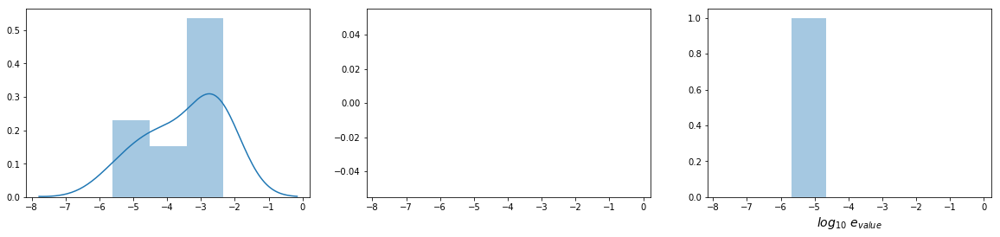

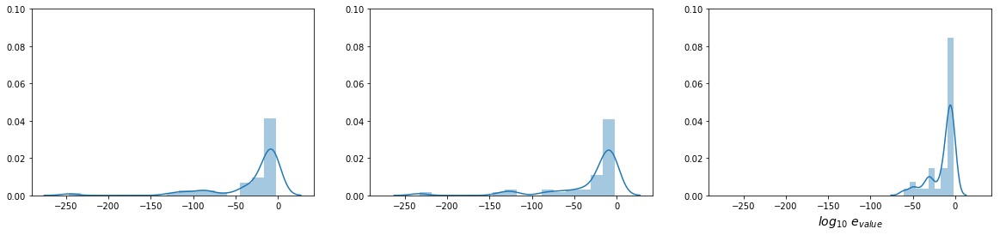

In [19]:
##Plotting some statistics from the MEME-4.9.0 run on Odyssey across species and phylogenetic groups.
meme_species_stats_file = os.path.join(data_dir, "meme", "meme_output", "species_meme-significant-stats.csv")
meme_species_stats = pd.read_csv(meme_species_stats_file, sep="\t", index_col=0)
print(list(meme_species_stats.columns))
print(meme_species_stats['Category'].unique())
print("\t".join(["Number of significant regulatory motifs found in species, divided by all, pheroAct and aSpecifc mating genes:", 
                str(len(meme_species_stats[meme_species_stats['Category'] == 'All'])),
                str(len(meme_species_stats[meme_species_stats['Category'] == 'pheroAct'])),
                str(len(meme_species_stats[meme_species_stats['Category'] == 'aSpec']))]))

#meme_species_stats.head()
fig1 = figure(figsize=(20,4))
ax1 = subplot(131)
ax1 = sns.distplot(np.log10(meme_species_stats[meme_species_stats['Category'] == 'All']['MotifeVal']), axlabel=False)
plot_limits = plt.xlim()

ax2 = subplot(132)
ax2 = sns.distplot(np.log10(meme_species_stats[meme_species_stats['Category'] == 'pheroAct']['MotifeVal']), axlabel=False)
plt.xlim(plot_limits)

ax3 = subplot(133)
ax3 = sns.distplot(np.log10(meme_species_stats[meme_species_stats['Category'] == 'aSpec']['MotifeVal']))
plt.xlim(plot_limits)
plt.xlabel(r'$log_{10}\ e_{value}$', fontsize=14);
#savefig(os.path.join(figure_dir, '332yeast_species_MEME-significant-hits-eValues_210620.pdf'), dpi=300, transparent=True)

meme_phylogroup_stats_file = os.path.join(data_dir, "meme", "meme_output", "phyloGroup_meme-significant-stats.csv")
meme_phylogroup_stats = pd.read_csv(meme_phylogroup_stats_file, sep="\t", index_col=0)
print(list(meme_phylogroup_stats.columns))
print(meme_phylogroup_stats['Category'].unique())
print("\t".join(["Number of significant regulatory motifs found in mating-regulation phylogroups, divided by all, pheroAct and aSpecifc mating genes:", 
                str(len(meme_phylogroup_stats[meme_phylogroup_stats['Category'] == 'All'])),
                str(len(meme_phylogroup_stats[meme_phylogroup_stats['Category'] == 'pheroAct'])),
                str(len(meme_phylogroup_stats[meme_phylogroup_stats['Category'] == 'aSpec']))]))
print("Number of regulatory motifs found in regulation-based phylogroups that are significant, e-value <= 1e-2:\t"
      +str(len(meme_phylogroup_stats[meme_phylogroup_stats['MotifeVal'] <= 1e-2])))

significant_meme_phylogroup_stats = meme_phylogroup_stats[meme_phylogroup_stats['MotifeVal'] <= 1e-2].copy()
print("\t".join(["Number of phylogroups for which significant motifs are found, divided by all, pheroAct and aSpecifc mating genes:", 
                str(len(meme_phylogroup_stats[meme_phylogroup_stats['Category'] == 'All']['PhylogeneticName'].unique())),
                str(len(meme_phylogroup_stats[meme_phylogroup_stats['Category'] == 'pheroAct']['PhylogeneticName'].unique())),
                str(len(meme_phylogroup_stats[meme_phylogroup_stats['Category'] == 'aSpec']['PhylogeneticName'].unique()))]))

print(meme_phylogroup_stats[meme_phylogroup_stats['PhylogeneticName'] == 'phyloGroup_12'])
#meme_phylogroup_stats.head()
fig2 = figure(figsize=(20, 4))
ax21 = subplot(131)
ax21 = sns.distplot(np.log10(meme_phylogroup_stats[meme_phylogroup_stats['Category'] == 'All']['MotifeVal']), axlabel=False)
ax21.set_ylim([0, 0.10])
plot_limits = plt.xlim()

ax22 = subplot(132)
ax22 = sns.distplot(np.log10(meme_phylogroup_stats[meme_phylogroup_stats['Category'] == 'pheroAct']['MotifeVal']), axlabel=False)
ax22.set_ylim([0, 0.10])
plt.xlim(plot_limits)

ax23 = subplot(133)
ax23 = sns.distplot(np.log10(meme_phylogroup_stats[meme_phylogroup_stats['Category'] == 'aSpec']['MotifeVal']))
ax23.set_ylim([0, 0.10])
plt.xlim(plot_limits)
plt.xlabel(r'$log_{10}\ e_{value}$', fontsize=14);
#savefig(os.path.join(figure_dir, '332yeast_phylogroup_MEME-significant-hits-eValues_211005.pdf'), dpi=300, transparent=True)

In [5]:
significant_meme_phylogroup_stats.head()

,PhylogeneticName,Category,Motif#,MotifName,MotifWidth,MotifeVal,MotifRegex
0,phyloGroup_1,aSpec,0,1,10,1.200000e-04,T[CG]GA[CG]TCC[CT]G
1,phyloGroup_1,aSpec,1,2,10,2.800000e-03,GTGC[AT][AG]GCCG
2,phyloGroup_1,aSpec,2,3,10,3.000000e-04,C[GT][CA]TTTC[AT]CC
3,phyloGroup_1,pheroAct,0,1,10,9.200000e-14,[AG]TGTTTCA[GA]A
4,phyloGroup_1,pheroAct,1,2,10,5.800000e-03,CTCT[AG]GCACC


In [31]:
##Function to run FIMO on candidate promoters with the MEME ouput of the mating gene promoters from the same phylogroups. The code-cell will be written to loop through the directory
##of the candidate promoters and find the appropriate MEME output for the mating gene promoters from the species or phyloGroup. I need to figure out what the output for this code will
##be, either the raw output of FIMO or ingest it and convert to a DataFrame that gives motifs-per-candidate-promoter.
##I am going to write wrappers for running FIMO and also to parse the outputs from the FIMO run (following what I borrowed from Peter for MEME).
###Input variables are:
    ###meme_input_base_dir = This is the directory that contains all the meme_outputs (meme.txt) with the directory names corresponding to the mating gene promoter groups.
    ###candidate_promoter_dir = This is the directory that contains all the FASTA files of candidate promoters from species OR phyloGroups.
fimo_dir = os.path.join(data_dir, "fimo")
if not(os.path.join(fimo_dir, "fimo_output")):
    os.mkdir(os.path.join(fimo_dir, "fimo_output"))
fimo_base_output_dir = os.path.join(fimo_dir, "fimo_output")

meme_input_base_dir = os.path.join(data_dir, "meme", "meme_output") ##Used only for local run since I don't want to replicate the meme_output folder. On the cluster I can use the MEME folder directly.
if not(os.path.isdir(meme_input_base_dir)):
    print("Make sure the directory with MEME outputs is present in the base directory as "+str(meme_input_base_dir)+"!")
candidate_promoter_dir = os.path.join(fimo_dir, "PromoterExtract") ##Used only the local run, provided as input on the cluster script.
if not(os.path.isdir(candidate_promoter_dir)):
    print("Make sure the directory with candidate promoter inputes is present in the base directory as "+str(candidate_promoter_dir)+"!")

candidate_promoter_file_list = [f for f in os.listdir(candidate_promoter_dir) if (f.endswith(".fasta") or f.endswith(".promoters"))]
print("Working on "+str(len(candidate_promoter_file_list))+" promoter files in "+str(candidate_promoter_dir)+".")
for candidate_promoter_file in candidate_promoter_file_list:
    ###Motifs from all mating gene promoters.
    ###Identifying input directory as containing species or phyloGroup candidate promoters
    ###Check the meme.txt file exists for the input candidate promoter file of species or phyloGroup.
    if (candidate_promoter_dir.split("_")[0] == "PhyloGroup"):
        category = "phyloGroup"
        if not(os.path.isfile(os.path.join(meme_input_base_dir, category, candidate_promoter_file.split(".")[0], "meme.txt"))):
            print("MEME motif file "+str(os.path.join(meme_input_base_dir, category, candidate_promoter_file.split(".")[0], "meme.txt"))+" is missing!")
        meme_motif_input_file = os.path.join(meme_input_base_dir, category, candidate_promoter_file.split(".")[0], "meme.txt")
    else:
        category = "species"
        if not(os.path.isfile(os.path.join(meme_input_base_dir, category, "promoters_0_"+str(candidate_promoter_file.split(".")[0]), "meme.txt"))):
            print("MEME motif file "+str(os.path.join(meme_input_base_dir, category, "promoters_0_"+str(candidate_promoter_file.split(".")[0]), "meme.txt"))+" is missing!")
        meme_motif_input_file = os.path.join(meme_input_base_dir, category, "promoters_0_"+str(candidate_promoter_file.split(".")[0]), "meme.txt")
    
    ###Running FIMO command.
    print("#-#-#-")
    print("Running FIMO on "+str(os.path.join(candidate_promoter_dir, candidate_promoter_file))+" with MEME motif file "+str(meme_motif_input_file)+"!")
    fimo_stderr, fimo_stdout = fimowrapper(os.path.join(candidate_promoter_dir, candidate_promoter_file), meme_motif_input_file)
    print("Standard error of FIMO run:\t")
    print(fimo_stderr.decode('utf-8'))
    print("Standard output of FIMO run:\t")
    print(fimo_stdout.decode('utf-8'))
    print("------\n")
    
    ###Motifs from pheroAct mating gene promoters.
    ###Identifying input directory as containing species or phyloGroup candidate promoters
    ###Check the meme.txt file exists for the input candidate promoter file of species or phyloGroup.
    if (candidate_promoter_dir.split("_")[0] == "PhyloGroup"):
        category = "phyloGroup"
        if not(os.path.isfile(os.path.join(meme_input_base_dir, category, "pheroAct_"+candidate_promoter_file.split(".")[0], "meme.txt"))):
            print("MEME motif file "+str(os.path.join(meme_input_base_dir, category, "pheroAct_"+candidate_promoter_file.split(".")[0], "meme.txt"))+" is missing!")
        meme_motif_input_file = os.path.join(meme_input_base_dir, category, "pheroAct_"+candidate_promoter_file.split(".")[0], "meme.txt")
    else:
        category = "species"
        if not(os.path.isfile(os.path.join(meme_input_base_dir, category, "pheroAct_promoters_0_"+candidate_promoter_file.split(".")[0], "meme.txt"))):
            print("MEME motif file "+str(os.path.join(meme_input_base_dir, category, "pheroAct_promoters_0_"+candidate_promoter_file.split(".")[0], "meme.txt"))+" is missing!")
        meme_motif_input_file = os.path.join(meme_input_base_dir, category, "pheroAct_promoters_0_"+candidate_promoter_file.split(".")[0], "meme.txt")
    
    ###
    print("Running FIMO on "+str(os.path.join(candidate_promoter_dir, candidate_promoter_file))+" with MEME motif file "+str(meme_motif_input_file)+"!")
    fimo_stderr, fimo_stdout = fimowrapper(os.path.join(candidate_promoter_dir, candidate_promoter_file), meme_motif_input_file)
    print("Standard error of FIMO run:\t")
    print(fimo_stderr.decode('utf-8'))
    print("Standard output of FIMO run:\t")
    print(fimo_stdout.decode('utf-8'))
    print("------\n")
    
    ###Motifs from aSpec mating gene promoters.
    ###Identifying input directory as containing species or phyloGroup candidate promoters
    ###Check the meme.txt file exists for the input candidate promoter file of species or phyloGroup.
    if (candidate_promoter_dir.split("_")[0] == "PhyloGroup"):
        category = "phyloGroup"
        if not(os.path.isfile(os.path.join(meme_input_base_dir, category, "aSpec_"+candidate_promoter_file.split(".")[0], "meme.txt"))):
            print("MEME motif file "+str(os.path.join(meme_input_base_dir, category, "aSpec_"+candidate_promoter_file.split(".")[0], "meme.txt"))+" is missing!")
        meme_motif_input_file = os.path.join(meme_input_base_dir, category, "aSpec_"+candidate_promoter_file.split(".")[0], "meme.txt")
    else:
        category = "species"
        if not(os.path.isfile(os.path.join(meme_input_base_dir, category, "aSpec_promoters_0_"+candidate_promoter_file.split(".")[0], "meme.txt"))):
            print("MEME motif file "+str(os.path.join(meme_input_base_dir, category, "aSpec_promoters_0_"+candidate_promoter_file.split(".")[0], "meme.txt"))+" is missing!")
        meme_motif_input_file = os.path.join(meme_input_base_dir, category, "aSpec_promoters_0_"+candidate_promoter_file.split(".")[0], "meme.txt")
    
    ###
    print("Running FIMO on "+str(os.path.join(candidate_promoter_dir, candidate_promoter_file))+" with MEME motif file "+str(meme_motif_input_file)+"!")
    fimo_stderr, fimo_stdout = fimowrapper(os.path.join(candidate_promoter_dir, candidate_promoter_file), meme_motif_input_file)
    print("Standard error of FIMO run:\t")
    print(fimo_stderr.decode('utf-8'))
    print("Standard output of FIMO run:\t")
    print(fimo_stdout.decode('utf-8'))
    print("------\n")
    sys.exit()

Working on 332 promoter files in ../fimo/PromoterExtract.
#-#-#-
Running FIMO on ../fimo/PromoterExtract/alloascoidea_hylecoeti.fas.caax.asn.promoters with MEME motif file ../meme/meme_output/species/promoters_0_alloascoidea_hylecoeti/meme.txt!
Standard error of FIMO run:	

Standard output of FIMO run:	
Using motif +1 of width 10.
Using motif -1 of width 10.
Computing q-values.
  Estimating pi_0 from a uniformly sampled set of 10000 p-values.
  Estimating pi_0.
  Estimated pi_0=1
Using motif +2 of width 10.
Using motif -2 of width 10.
Computing q-values.
  Estimating pi_0 from a uniformly sampled set of 10000 p-values.
  Estimating pi_0.
  Estimated pi_0=0.970692
Using motif +3 of width 10.
Using motif -3 of width 10.
Computing q-values.
  Estimating pi_0 from a uniformly sampled set of 10000 p-values.
  Estimating pi_0.
  Estimated pi_0=0.955921

------

Running FIMO on ../fimo/PromoterExtract/alloascoidea_hylecoeti.fas.caax.asn.promoters with MEME motif file ../meme/meme_output/speci

SystemExit: 

In [4]:
##Function to read in FIMO output from the run on the cluster to score candidates based on shared mating regulatory motifs.
##This function is going to read-in the tab-separated output file from FIMO (fimo-4.9.0 run on Odyssey) as pd.DataFrames and then pool motif hits into a scoring schema. The goal will 
##be to cycle through all the candidates from the FASTA file of candidates promoters and record the occurence of motifs identified as significant (with a particular p_value (<1e-04))
##in a new pd.DataFrame.
    ###candidate_promoter_dir = Directory containing the FASTA files of candidate promoters from either species or phylogenetic groups with conserved mating regulation
    ###meme_motif_base_dir = Base directory containing the outputs of the MEME runs on mating gene promoters in order read in the motifs that are tested.
    ###fimo_output_base_dir = Base directory containing the outputs of the FIMO runs of motifs from mating gene promoters against candidate promoters.
####Defining input variable directories for the function, and testing their existence
candidate_promoter_dir = os.path.join(data_dir, "fimo", "PromoterExtract") ####OR run on "PhyloGroup_PromoterExtract"
if not(os.path.isdir(candidate_promoter_dir)):
    print("Directory containing candidate promoter FASTA files is missing at: "+str(candidate_promoter_dir))
    sys.exit()

meme_motif_base_dir = os.path.join(data_dir, "meme", "meme_output")
if not(os.path.isdir(meme_motif_base_dir)):
    print("Directory containing the outputs of MEME to identify motifs in mating gene promoters is missing at: "+str(meme_motif_base_dir))
    sys.exit()
    
fimo_output_base_dir = os.path.join(data_dir, "fimo", "fimo_output")
if not(os.path.isdir(fimo_output_base_dir)):
    print("Directory containing outputs of FIMO to find mating gene motifs in pheromone candidate promoters is missing at: "+str(fimo_output_base_dir))
    sys.exit()
    
####Looping through species OR phylogenetic groups of candidate promoter FASTA files to analyze the results one at a time.
candidate_promoter_file_list = [f for f in os.listdir(candidate_promoter_dir) if (f.endswith(".promoters") or f.endswith(".fasta"))]
for candidate_promoter_file in candidate_promoter_file_list:
    ###Reading in FASTA file to setup a SeqIO record list.
    input_file_handle = open(os.path.join(candidate_promoter_dir, candidate_promoter_file), "r")
    promoter_records = list(SeqIO.parse(input_file_handle, "fasta"))
    input_file_handle.close()
    
    ####Reading MEME motif files from the MEME output directories. Checking category of input candidate pheromones and also checking presence of MEME run output files.
    if (candidate_promoter_dir.split("/")[-1].split("_")[0] == "PhyloGroup"):
        category = "phyloGroup"
        if not(os.path.isfile(os.path.join(meme_motif_base_dir, category, candidate_promoter_file.split(".")[0], "meme.xml"))):
            print("MEME motif file "+str(os.path.join(meme_motif_base_dir, category, candidate_promoter_file.split(".")[0], "meme.xml"))+" is missing!")
        all_meme_motif_input_file = os.path.join(meme_motif_base_dir, category, candidate_promoter_file.split(".")[0], "meme.xml")
        if not(os.path.isfile(os.path.join(meme_motif_base_dir, category, "pheroAct_"+candidate_promoter_file.split(".")[0], "meme.xml"))):
            print("MEME motif file "+str(os.path.join(meme_motif_base_dir, category, "pheroAct_"+candidate_promoter_file.split(".")[0], "meme.xml"))+" is missing!")
        pheroAct_meme_motif_input_file = os.path.join(meme_motif_base_dir, category, "pheroAct_"+candidate_promoter_file.split(".")[0], "meme.xml")
        if not(os.path.isfile(os.path.join(meme_motif_base_dir, category, "aSpec_"+candidate_promoter_file.split(".")[0], "meme.xml"))):
            print("MEME motif file "+str(os.path.join(meme_motif_base_dir, category, "aSpec_"+candidate_promoter_file.split(".")[0], "meme.xml"))+" is missing!")
        aSpec_meme_motif_input_file = os.path.join(meme_motif_base_dir, category, "aSpec_"+candidate_promoter_file.split(".")[0], "meme.xml")
    else:
        category = "species"
        if not(os.path.isfile(os.path.join(meme_motif_base_dir, category, "promoters_0_"+candidate_promoter_file.split(".")[0], "meme.xml"))):
            print("MEME motif file "+str(os.path.join(meme_motif_base_dir, category, "promoters_0_"+candidate_promoter_file.split(".")[0], "meme.xml"))+" is missing!")
        all_meme_motif_input_file = os.path.join(meme_motif_base_dir, category, "promoters_0_"+candidate_promoter_file.split(".")[0], "meme.xml")
        if not(os.path.isfile(os.path.join(meme_motif_base_dir, category, "pheroAct_promoters_0_"+candidate_promoter_file.split(".")[0], "meme.xml"))):
            print("MEME motif file "+str(os.path.join(meme_motif_base_dir, category, "pheroAct_promoters_0_"+candidate_promoter_file.split(".")[0], "meme.xml"))+" is missing!")
        pheroAct_meme_motif_input_file = os.path.join(meme_motif_base_dir, category, "pheroAct_promoters_0_"+candidate_promoter_file.split(".")[0], "meme.xml")
        if not(os.path.isfile(os.path.join(meme_motif_base_dir, category, "aSpec_promoters_0_"+candidate_promoter_file.split(".")[0], "meme.xml"))):
            print("MEME motif file "+str(os.path.join(meme_motif_base_dir, category, "aSpec_promoters_0_"+candidate_promoter_file.split(".")[0], "meme.xml"))+" is missing!")
        aSpec_meme_motif_input_file = os.path.join(meme_motif_base_dir, category, "aSpec_promoters_0_"+candidate_promoter_file.split(".")[0], "meme.xml")
    
    ####Reading FIMO output files from the FIMO output directories. Checking category of input candidate pheromones and also checking presence of FIMO run output files.
    if (candidate_promoter_dir.split("/")[-1].split("_")[0] == "PhyloGroup"):
        category = "phyloGroup"
        if not(os.path.isfile(os.path.join(fimo_output_base_dir, category, candidate_promoter_file.split(".")[0], "fimo.txt"))):
            print("FIMO output file "+str(os.path.join(fimo_output_base_dir, category, candidate_promoter_file.split(".")[0], "fimo.txt"))+" is missing!")
        all_fimo_output_file = os.path.join(fimo_output_base_dir, category, candidate_promoter_file.split(".")[0], "fimo.txt")
        if not(os.path.isfile(os.path.join(fimo_output_base_dir, category, "pheroAct_"+candidate_promoter_file.split(".")[0], "fimo.txt"))):
            print("FIMO output file "+str(os.path.join(fimo_output_base_dir, category, "pheroAct_"+candidate_promoter_file.split(".")[0], "fimo.txt"))+" is missing!")
        pheroAct_fimo_output_file = os.path.join(fimo_output_base_dir, category, "pheroAct_"+candidate_promoter_file.split(".")[0], "fimo.txt")
        if not(os.path.isfile(os.path.join(fimo_output_base_dir, category, "aSpec_"+candidate_promoter_file.split(".")[0], "fimo.txt"))):
            print("FIMO output file "+str(os.path.join(fimo_output_base_dir, category, "aSpec_"+candidate_promoter_file.split(".")[0], "fimo.txt"))+" is missing!")
        aSpec_fimo_output_file = os.path.join(fimo_output_base_dir, category, "aSpec_"+candidate_promoter_file.split(".")[0], "fimo.txt")
    else:
        category = "species"
        if not(os.path.isfile(os.path.join(fimo_output_base_dir, category, "promoters_0_"+candidate_promoter_file.split(".")[0], "fimo.txt"))):
            print("FIMO output file "+str(os.path.join(fimo_output_base_dir, category, "promoters_0_"+candidate_promoter_file.split(".")[0], "fimo.txt"))+" is missing!")
        all_fimo_output_file = os.path.join(fimo_output_base_dir, category, "promoters_0_"+candidate_promoter_file.split(".")[0], "fimo.txt")
        if not(os.path.isfile(os.path.join(fimo_output_base_dir, category, "pheroAct_promoters_0_"+candidate_promoter_file.split(".")[0], "fimo.txt"))):
            print("FIMO output file "+str(os.path.join(fimo_output_base_dir, category, "pheroAct_promoters_0_"+candidate_promoter_file.split(".")[0], "fimo.txt"))+" is missing!")
        pheroAct_fimo_output_file = os.path.join(fimo_output_base_dir, category, "pheroAct_promoters_0_"+candidate_promoter_file.split(".")[0], "fimo.txt")
        if not(os.path.isfile(os.path.join(fimo_output_base_dir, category, "aSpec_promoters_0_"+candidate_promoter_file.split(".")[0], "fimo.txt"))):
            print("FIMO output file "+str(os.path.join(fimo_output_base_dir, category, "aSpec_promoters_0_"+candidate_promoter_file.split(".")[0], "fimo.txt"))+" is missing!")
        aSpec_fimo_output_file = os.path.join(fimo_output_base_dir, category, "aSpec_promoters_0_"+candidate_promoter_file.split(".")[0], "fimo.txt")
    
    ####Scanning in FIMO outputs into pd.DataFrames.
    all_fimo_output = pd.read_csv(all_fimo_output_file, sep="\t", index_col=None)
    pheroAct_fimo_output = pd.read_csv(pheroAct_fimo_output_file, sep="\t", index_col=None)
    aSpec_fimo_output = pd.read_csv(aSpec_fimo_output_file, sep="\t", index_col=None)
    print("Reading FIMO output table from:\n\t"+all_fimo_output_file+"\n\t"+pheroAct_fimo_output_file+"\n\t"+aSpec_fimo_output_file)
    #print(all_fimo_output.iloc[:5])
    print("Found "+str(len(all_fimo_output))+", "+str(len(pheroAct_fimo_output))+", and "+str(len(aSpec_fimo_output))+" records from the FIMO runs on "+
          os.path.join(candidate_promoter_dir, candidate_promoter_file)+" with motifs from the "+category+
          "'s mating gene promoters considering all, pheromone-activated and a-specific genes respectively.")
    print("\nFIMO run was on:\t"+candidate_promoter_file)
    
    ####Reading the motifs from the MEME output files on the mating gene promoters considered in groups of all, pheromone-activated and a-specific mating genes.
    all_motif_details, motif_scores, motif_frequencies, all_motif_regex, counts, bg_frequencies = parsememexml(all_meme_motif_input_file)
    pheroAct_motif_details, motif_scores, motif_frequencies, pheroAct_motif_regex, counts, bg_frequencies = parsememexml(pheroAct_meme_motif_input_file)
    aSpec_motif_details, motif_scores, motif_frequencies, aSpec_motif_regex, counts, bg_frequencies = parsememexml(aSpec_meme_motif_input_file)
    
    ####On [200607], I noticed that there is an error in how I was reading in the eValues of the MEME runs because I was trying to select columns from a list of lists.
    ####I need to convert to an ndarray before doing this.
    ####print(np.array(all_motif_details)[:, 2])
    
    print("\nThe motifs identified by MEME that were found in candidate promoters by FIMO are:")
    print("\tMotifs from all mating gene promoters.")
    print("\t"+str("\t".join(all_motif_regex))+"\t"+str("\t".join(np.array(all_motif_details)[:, 2])))
    print("\tMotifs from pheromone-activated mating gene promoters.")
    print("\t"+str("\t".join(pheroAct_motif_regex))+"\t"+str("\t".join(np.array(pheroAct_motif_details)[:, 2])))
    print("\tMotifs from a-specific mating gene promoters.")
    print("\t"+str("\t".join(aSpec_motif_regex))+"\t"+str("\t".join(np.array(aSpec_motif_details)[:, 2])))
    
    ####Intitiallizing OrderedDictionary of motifs found in a candidate pheromone promoter.
    dict_key = ['PheromoneCandidateName', 
                'all_motif_regex', 'all_motif_evalue',
                'pheroAct_motif_regex', 'pheroAct_motif_evalue',
                'aSpec_motif_regex', 'aSpec_motif_evalue',
                '#all_motif_1_sites', 'all_motif_1_pvalues', 
                '#all_motif_2_sites', 'all_motif_2_pvalues', 
                '#all_motif_3_sites', 'all_motif_3_pvalues', 
                '#pheroAct_motif_1_sites', 'pheroAct_motif_1_pvalues', 
                '#pheroAct_motif_2_sites', 'pheroAct_motif_2_pvalues', 
                '#pheroAct_motif_3_sites', 'pheroAct_motif_3_pvalues', 
                '#aSpec_motif_1_sites', 'aSpec_motif_1_pvalues',
                '#aSpec_motif_2_sites', 'aSpec_motif_2_pvalues',
                '#aSpec_motif_3_sites', 'aSpec_motif_3_pvalues']
    fimo_candidate_promoter_stats_dict = collections.OrderedDict()
    for column in dict_key:
        fimo_candidate_promoter_stats_dict[column] = 0
        
    ####Intitializing pandas dataframe to save motif details per candidate.
    fimo_candidate_promoter_stats = pd.DataFrame()
        
    ####Looping through the candidates in the promoter FASTA file.
    for promoter in promoter_records:
        ####Initializing the dictionary of results for each candidate while looping.
        fimo_candidate_promoter_stats_dict = collections.OrderedDict()
        for column in dict_key:
            fimo_candidate_promoter_stats_dict[column] = 0
        
        ####Identifying promoters
        candidate_promoter_id = promoter.id
        all_motif_regex_string = ";".join(all_motif_regex)
        all_motif_evalue_string = ";".join(np.array(all_motif_details)[:, 2])
        pheroAct_motif_regex_string = ";".join(pheroAct_motif_regex)
        pheroAct_motif_evalue_string = ";".join(np.array(pheroAct_motif_details)[:, 2])
        aSpec_motif_regex_string = ";".join(aSpec_motif_regex)
        aSpec_motif_evalue_string = ";".join(np.array(aSpec_motif_details)[:, 2])
        
        ####Narrowing down FIMO hits in each candidate promoter. Complicated by the fact that the field is truncatde in the fimo.txt output file.
        candidate_promoter_all_fimo_hits = all_fimo_output[all_fimo_output['sequence name'] == candidate_promoter_id.split("[Translate")[0]+"[Translate"]
        print("Number of hits of all mating gene motifs in:\t"+candidate_promoter_id+"\t"+str(len(candidate_promoter_all_fimo_hits)))
        candidate_promoter_pheroAct_fimo_hits = pheroAct_fimo_output[pheroAct_fimo_output['sequence name'] == candidate_promoter_id.split("[Translate")[0]+"[Translate"]
        print("Number of hits of pheromone-activated mating gene motifs in:\t"+candidate_promoter_id+"\t"+str(len(candidate_promoter_pheroAct_fimo_hits)))
        candidate_promoter_aSpec_fimo_hits = aSpec_fimo_output[aSpec_fimo_output['sequence name'] == candidate_promoter_id.split("[Translate")[0]+"[Translate"]
        print("Number of hits of a-specific mating gene motifs in:\t"+candidate_promoter_id+"\t"+str(len(candidate_promoter_aSpec_fimo_hits)))
        
        ####Saving the hits for each candidate promoter to the dictionary.
        fimo_candidate_promoter_stats_dict['PheromoneCandidateName'] = candidate_promoter_id
        fimo_candidate_promoter_stats_dict['all_motif_regex'] = all_motif_regex_string
        fimo_candidate_promoter_stats_dict['all_motif_evalue'] = all_motif_evalue_string
        fimo_candidate_promoter_stats_dict['pheroAct_motif_regex'] = pheroAct_motif_regex_string
        fimo_candidate_promoter_stats_dict['pheroAct_motif_evalue'] = pheroAct_motif_evalue_string
        fimo_candidate_promoter_stats_dict['aSpec_motif_regex'] = aSpec_motif_regex_string
        fimo_candidate_promoter_stats_dict['aSpec_motif_evalue'] = aSpec_motif_evalue_string
        
        ####Sites mating motifs 1,2,3 from all mating genes.
        fimo_candidate_promoter_stats_dict['#all_motif_1_sites'] = len(candidate_promoter_all_fimo_hits[candidate_promoter_all_fimo_hits['#pattern name'] == 1])
        fimo_candidate_promoter_stats_dict['all_motif_1_pvalues'] = ";".join(candidate_promoter_all_fimo_hits[candidate_promoter_all_fimo_hits['#pattern name'] == 1]['p-value'].astype(str).values)
#         if (len(candidate_promoter_all_fimo_hits) != 0):
#             print("\n"+str(fimo_candidate_promoter_stats_dict['#all_motif_1_sites'])+"\t"+fimo_candidate_promoter_stats_dict['all_motif_1_pvalues'])
#             print(candidate_promoter_all_fimo_hits)
#             sys.exit()
        fimo_candidate_promoter_stats_dict['#all_motif_2_sites'] = len(candidate_promoter_all_fimo_hits[candidate_promoter_all_fimo_hits['#pattern name'] == 2])
        fimo_candidate_promoter_stats_dict['all_motif_2_pvalues'] = ";".join(candidate_promoter_all_fimo_hits[candidate_promoter_all_fimo_hits['#pattern name'] == 2]['p-value'].astype(str).values)
        fimo_candidate_promoter_stats_dict['#all_motif_3_sites'] = len(candidate_promoter_all_fimo_hits[candidate_promoter_all_fimo_hits['#pattern name'] == 3])
        fimo_candidate_promoter_stats_dict['all_motif_3_pvalues'] = ";".join(candidate_promoter_all_fimo_hits[candidate_promoter_all_fimo_hits['#pattern name'] == 3]['p-value'].astype(str).values)
        ####Sites mating motifs 1,2,3 from pheromone-activated mating genes.
        fimo_candidate_promoter_stats_dict['#pheroAct_motif_1_sites'] = len(candidate_promoter_pheroAct_fimo_hits[candidate_promoter_pheroAct_fimo_hits['#pattern name'] == 1])
        fimo_candidate_promoter_stats_dict['pheroAct_motif_1_pvalues'] = ";".join(candidate_promoter_pheroAct_fimo_hits[candidate_promoter_pheroAct_fimo_hits['#pattern name'] == 1]['p-value'].astype(str).values)
        fimo_candidate_promoter_stats_dict['#pheroAct_motif_2_sites'] = len(candidate_promoter_pheroAct_fimo_hits[candidate_promoter_pheroAct_fimo_hits['#pattern name'] == 2])
        fimo_candidate_promoter_stats_dict['pheroAct_motif_2_pvalues'] = ";".join(candidate_promoter_pheroAct_fimo_hits[candidate_promoter_pheroAct_fimo_hits['#pattern name'] == 2]['p-value'].astype(str).values)
        fimo_candidate_promoter_stats_dict['#pheroAct_motif_3_sites'] = len(candidate_promoter_pheroAct_fimo_hits[candidate_promoter_pheroAct_fimo_hits['#pattern name'] == 3])
        fimo_candidate_promoter_stats_dict['pheroAct_motif_3_pvalues'] = ";".join(candidate_promoter_pheroAct_fimo_hits[candidate_promoter_pheroAct_fimo_hits['#pattern name'] == 3]['p-value'].astype(str).values)
        ####Sites mating motifs 1,2,3 from pheromone-activated mating genes.
        fimo_candidate_promoter_stats_dict['#aSpec_motif_1_sites'] = len(candidate_promoter_aSpec_fimo_hits[candidate_promoter_aSpec_fimo_hits['#pattern name'] == 1])
        fimo_candidate_promoter_stats_dict['aSpec_motif_1_pvalues'] = ";".join(candidate_promoter_aSpec_fimo_hits[candidate_promoter_aSpec_fimo_hits['#pattern name'] == 1]['p-value'].astype(str).values)
        fimo_candidate_promoter_stats_dict['#aSpec_motif_2_sites'] = len(candidate_promoter_aSpec_fimo_hits[candidate_promoter_aSpec_fimo_hits['#pattern name'] == 2])
        fimo_candidate_promoter_stats_dict['aSpec_motif_2_pvalues'] = ";".join(candidate_promoter_aSpec_fimo_hits[candidate_promoter_aSpec_fimo_hits['#pattern name'] == 2]['p-value'].astype(str).values)
        fimo_candidate_promoter_stats_dict['#aSpec_motif_3_sites'] = len(candidate_promoter_aSpec_fimo_hits[candidate_promoter_aSpec_fimo_hits['#pattern name'] == 3])
        fimo_candidate_promoter_stats_dict['aSpec_motif_3_pvalues'] = ";".join(candidate_promoter_aSpec_fimo_hits[candidate_promoter_aSpec_fimo_hits['#pattern name'] == 3]['p-value'].astype(str).values)
        
        ####Appending the dictionary to the pandas dataframe for each species or phylogenetic group.
        fimo_candidate_promoter_stats = fimo_candidate_promoter_stats.append(pd.DataFrame(fimo_candidate_promoter_stats_dict, index=[0]), ignore_index=True)
#         if (fimo_candidate_promoter_stats_dict['#all_motif_2_sites'] > 0):
#             print(fimo_candidate_promoter_stats_dict)
#             print(len(fimo_candidate_promoter_stats))
#             print(fimo_candidate_promoter_stats.iloc[-1])
#             sys.exit()
        
    ####Sorting values based on the total number of motifs found.
    fimo_candidate_promoter_stats = fimo_candidate_promoter_stats.sort_values(by=['#all_motif_1_sites', '#all_motif_2_sites', '#all_motif_3_sites', 
                                                                                  '#pheroAct_motif_1_sites', '#pheroAct_motif_2_sites', '#pheroAct_motif_3_sites',
                                                                                  '#aSpec_motif_1_sites', '#aSpec_motif_2_sites', '#aSpec_motif_3_sites'], ascending=False).reset_index(drop=True)
#     print(fimo_candidate_promoter_stats.iloc[:5])
#     sys.exit()
    
    ####Making output directory per species or phylogenetic group, and a single stats file for each species or phylogenetic group.
    if not(os.path.isdir(os.path.join(data_dir, "fimo", "fimo_stats"))):
        os.mkdir(os.path.join(data_dir, "fimo", "fimo_stats"))
    if not(os.path.isdir(os.path.join(data_dir, "fimo", "fimo_stats", category))):
        os.mkdir(os.path.join(data_dir, "fimo", "fimo_stats", category))
    stats_output_file = os.path.join(data_dir, "fimo", "fimo_stats", category, candidate_promoter_file.split(".")[0].split("promoters_0_")[-1]+"_fimo-stats.csv")
    
    fimo_candidate_promoter_stats.to_csv(stats_output_file, sep="\t", header=True, index=True, index_label='index')
    
    print("Done analyzing "+str(len(promoter_records))+" candidates in the promoter file of "+candidate_promoter_file.split(".")[0].split("promoters_0_")[-1]+
          " and tabulated data saved to "+stats_output_file+". Good luck!")
    #sys.exit()

Reading FIMO output table from:
	../fimo/fimo_output/species/promoters_0_alloascoidea_hylecoeti/fimo.txt
	../fimo/fimo_output/species/pheroAct_promoters_0_alloascoidea_hylecoeti/fimo.txt
	../fimo/fimo_output/species/aSpec_promoters_0_alloascoidea_hylecoeti/fimo.txt
Found 642, 249, and 228 records from the FIMO runs on ../fimo/PromoterExtract/alloascoidea_hylecoeti.fas.caax.asn.promoters with motifs from the species's mating gene promoters considering all, pheromone-activated and a-specific genes respectively.

FIMO run was on:	alloascoidea_hylecoeti.fas.caax.asn.promoters

The motifs identified by MEME that were found in candidate promoters by FIMO are:
	Motifs from all mating gene promoters.
	[TC]GGCAGTTGA	[TC]CA[CT]TT[GC]CA[TA]	TG[GT][GAT]TT[GT]G[GA]T	1.6e+003	4.8e+003	3.1e+004
	Motifs from pheromone-activated mating gene promoters.
	[CG][GT]GT[CG][CA][GA]G[CG][CA]	[GC]CCA[AG]AGGG	[GT]TGG[TA]GTT[TC]	8.4e+003	2.6e+004	1.5e+004
	Motifs from a-specific mating gene promoters.
	CACTTGCAT[

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Number of hits of all mating gene motifs in:	metschnikowia_bicuspidata|/|scaffold_9||[reverse][1][118112-117971-117959][Translate:MKLSSISTWVNSGCRSARRSSSLKHLAIWKYRENPELIKICLYCCGDCGSA*]	0
Number of hits of pheromone-activated mating gene motifs in:	metschnikowia_bicuspidata|/|scaffold_9||[reverse][1][118112-117971-117959][Translate:MKLSSISTWVNSGCRSARRSSSLKHLAIWKYRENPELIKICLYCCGDCGSA*]	0
Number of hits of a-specific mating gene motifs in:	metschnikowia_bicuspidata|/|scaffold_9||[reverse][1][118112-117971-117959][Translate:MKLSSISTWVNSGCRSARRSSSLKHLAIWKYRENPELIKICLYCCGDCGSA*]	0
Number of hits of all mating gene motifs in:	metschnikowia_bicuspidata|/|scaffold_9||[reverse][1][107659-107590-107578][Translate:MKNDRGVISGDMTILANNSNTIHCGHI*]	2
Number of hits of pheromone-activated mating gene motifs in:	metschnikowia_bicuspidata|/|scaffold_9||[reverse][1][107659-107590-107578][Translate:MKNDRGVISGDMTILANNSNTIHCGHI*]	2
Number of hits of a-specific mating gene motifs in:	metschnikowia_bicuspidata|/

IOError: [Errno 2] File ../fimo/fimo_output/species/pheroAct_promoters_0_yHMPu5000034594_starmera_quercuum_160519/fimo.txt does not exist: '../fimo/fimo_output/species/pheroAct_promoters_0_yHMPu5000034594_starmera_quercuum_160519/fimo.txt'

In [8]:
##Function to read in FIMO output from the run on the cluster to score candidates based on shared mating regulatory motifs.
##This function is going to read-in the tab-separated output file from FIMO (fimo-4.9.0 run on Odyssey) as pd.DataFrames and then pool motif hits into a scoring schema. The goal will 
##be to cycle through all the candidates from the FASTA file of candidates promoters and record the occurence of motifs identified as significant (with a particular p_value (<1e-04))
##in a new pd.DataFrame.
##On [210822], I am going to modify a copy of the code to also output the results of the MEME/FIMO search restricted to significant motifs (MEME e-value < 0.01) and 
##FIMO-hits that are significant (FIMO e-value<0.01). I am going to make two extra outputs for all FIMO-hits of significant MEME-motifs and the most stringent one for significant FIMO-hits
##of significant MEME-motifs.
##On [210824], I commented out a number of stdout print statements in the loop that report hits since the notebook crashes Jupyter lab 
    ###candidate_promoter_dir = Directory containing the FASTA files of candidate promoters from either species or phylogenetic groups with conserved mating regulation
    ###meme_motif_base_dir = Base directory containing the outputs of the MEME runs on mating gene promoters in order read in the motifs that are tested.
    ###fimo_output_base_dir = Base directory containing the outputs of the FIMO runs of motifs from mating gene promoters against candidate promoters.
####Defining input variable directories for the function, and testing their existence
candidate_promoter_dir = os.path.join(data_dir, "fimo", "PhyloGroup_PromoterExtract") ####OR run on "PhyloGroup_PromoterExtract"
if not(os.path.isdir(candidate_promoter_dir)):
    print("Directory containing candidate promoter FASTA files is missing at: "+str(candidate_promoter_dir))
    sys.exit()

meme_motif_base_dir = os.path.join(data_dir, "meme", "meme_output")
if not(os.path.isdir(meme_motif_base_dir)):
    print("Directory containing the outputs of MEME to identify motifs in mating gene promoters is missing at: "+str(meme_motif_base_dir))
    sys.exit()
    
fimo_output_base_dir = os.path.join(data_dir, "fimo", "fimo_output")
if not(os.path.isdir(fimo_output_base_dir)):
    print("Directory containing outputs of FIMO to find mating gene motifs in pheromone candidate promoters is missing at: "+str(fimo_output_base_dir))
    sys.exit()
    
####Looping through species OR phylogenetic groups of candidate promoter FASTA files to analyze the results one at a time.
candidate_promoter_file_list = [f for f in os.listdir(candidate_promoter_dir) if (f.endswith(".promoters") or f.endswith(".fasta"))]
for candidate_promoter_file in candidate_promoter_file_list:
    ###Reading in FASTA file to setup a SeqIO record list.
    input_file_handle = open(os.path.join(candidate_promoter_dir, candidate_promoter_file), "r")
    promoter_records = list(SeqIO.parse(input_file_handle, "fasta"))
    input_file_handle.close()
    
    ####Reading MEME motif files from the MEME output directories. Checking category of input candidate pheromones and also checking presence of MEME run output files.
    if (candidate_promoter_dir.split("/")[-1].split("_")[0] == "PhyloGroup"):
        category = "phyloGroup"
        if not(os.path.isfile(os.path.join(meme_motif_base_dir, category, candidate_promoter_file.split(".")[0], "meme.xml"))):
            print("MEME motif file "+str(os.path.join(meme_motif_base_dir, category, candidate_promoter_file.split(".")[0], "meme.xml"))+" is missing!")
        all_meme_motif_input_file = os.path.join(meme_motif_base_dir, category, candidate_promoter_file.split(".")[0], "meme.xml")
        if not(os.path.isfile(os.path.join(meme_motif_base_dir, category, "pheroAct_"+candidate_promoter_file.split(".")[0], "meme.xml"))):
            print("MEME motif file "+str(os.path.join(meme_motif_base_dir, category, "pheroAct_"+candidate_promoter_file.split(".")[0], "meme.xml"))+" is missing!")
        pheroAct_meme_motif_input_file = os.path.join(meme_motif_base_dir, category, "pheroAct_"+candidate_promoter_file.split(".")[0], "meme.xml")
        if not(os.path.isfile(os.path.join(meme_motif_base_dir, category, "aSpec_"+candidate_promoter_file.split(".")[0], "meme.xml"))):
            print("MEME motif file "+str(os.path.join(meme_motif_base_dir, category, "aSpec_"+candidate_promoter_file.split(".")[0], "meme.xml"))+" is missing!")
        aSpec_meme_motif_input_file = os.path.join(meme_motif_base_dir, category, "aSpec_"+candidate_promoter_file.split(".")[0], "meme.xml")
    else:
        category = "species"
        if not(os.path.isfile(os.path.join(meme_motif_base_dir, category, "promoters_0_"+candidate_promoter_file.split(".")[0], "meme.xml"))):
            print("MEME motif file "+str(os.path.join(meme_motif_base_dir, category, "promoters_0_"+candidate_promoter_file.split(".")[0], "meme.xml"))+" is missing!")
        all_meme_motif_input_file = os.path.join(meme_motif_base_dir, category, "promoters_0_"+candidate_promoter_file.split(".")[0], "meme.xml")
        if not(os.path.isfile(os.path.join(meme_motif_base_dir, category, "pheroAct_promoters_0_"+candidate_promoter_file.split(".")[0], "meme.xml"))):
            print("MEME motif file "+str(os.path.join(meme_motif_base_dir, category, "pheroAct_promoters_0_"+candidate_promoter_file.split(".")[0], "meme.xml"))+" is missing!")
        pheroAct_meme_motif_input_file = os.path.join(meme_motif_base_dir, category, "pheroAct_promoters_0_"+candidate_promoter_file.split(".")[0], "meme.xml")
        if not(os.path.isfile(os.path.join(meme_motif_base_dir, category, "aSpec_promoters_0_"+candidate_promoter_file.split(".")[0], "meme.xml"))):
            print("MEME motif file "+str(os.path.join(meme_motif_base_dir, category, "aSpec_promoters_0_"+candidate_promoter_file.split(".")[0], "meme.xml"))+" is missing!")
        aSpec_meme_motif_input_file = os.path.join(meme_motif_base_dir, category, "aSpec_promoters_0_"+candidate_promoter_file.split(".")[0], "meme.xml")
    
    ####Reading FIMO output files from the FIMO output directories. Checking category of input candidate pheromones and also checking presence of FIMO run output files.
    if (candidate_promoter_dir.split("/")[-1].split("_")[0] == "PhyloGroup"):
        category = "phyloGroup"
        if not(os.path.isfile(os.path.join(fimo_output_base_dir, category, candidate_promoter_file.split(".")[0], "fimo.txt"))):
            print("FIMO output file "+str(os.path.join(fimo_output_base_dir, category, candidate_promoter_file.split(".")[0], "fimo.txt"))+" is missing!")
        all_fimo_output_file = os.path.join(fimo_output_base_dir, category, candidate_promoter_file.split(".")[0], "fimo.txt")
        if not(os.path.isfile(os.path.join(fimo_output_base_dir, category, "pheroAct_"+candidate_promoter_file.split(".")[0], "fimo.txt"))):
            print("FIMO output file "+str(os.path.join(fimo_output_base_dir, category, "pheroAct_"+candidate_promoter_file.split(".")[0], "fimo.txt"))+" is missing!")
        pheroAct_fimo_output_file = os.path.join(fimo_output_base_dir, category, "pheroAct_"+candidate_promoter_file.split(".")[0], "fimo.txt")
        if not(os.path.isfile(os.path.join(fimo_output_base_dir, category, "aSpec_"+candidate_promoter_file.split(".")[0], "fimo.txt"))):
            print("FIMO output file "+str(os.path.join(fimo_output_base_dir, category, "aSpec_"+candidate_promoter_file.split(".")[0], "fimo.txt"))+" is missing!")
        aSpec_fimo_output_file = os.path.join(fimo_output_base_dir, category, "aSpec_"+candidate_promoter_file.split(".")[0], "fimo.txt")
    else:
        category = "species"
        if not(os.path.isfile(os.path.join(fimo_output_base_dir, category, "promoters_0_"+candidate_promoter_file.split(".")[0], "fimo.txt"))):
            print("FIMO output file "+str(os.path.join(fimo_output_base_dir, category, "promoters_0_"+candidate_promoter_file.split(".")[0], "fimo.txt"))+" is missing!")
        all_fimo_output_file = os.path.join(fimo_output_base_dir, category, "promoters_0_"+candidate_promoter_file.split(".")[0], "fimo.txt")
        if not(os.path.isfile(os.path.join(fimo_output_base_dir, category, "pheroAct_promoters_0_"+candidate_promoter_file.split(".")[0], "fimo.txt"))):
            print("FIMO output file "+str(os.path.join(fimo_output_base_dir, category, "pheroAct_promoters_0_"+candidate_promoter_file.split(".")[0], "fimo.txt"))+" is missing!")
        pheroAct_fimo_output_file = os.path.join(fimo_output_base_dir, category, "pheroAct_promoters_0_"+candidate_promoter_file.split(".")[0], "fimo.txt")
        if not(os.path.isfile(os.path.join(fimo_output_base_dir, category, "aSpec_promoters_0_"+candidate_promoter_file.split(".")[0], "fimo.txt"))):
            print("FIMO output file "+str(os.path.join(fimo_output_base_dir, category, "aSpec_promoters_0_"+candidate_promoter_file.split(".")[0], "fimo.txt"))+" is missing!")
        aSpec_fimo_output_file = os.path.join(fimo_output_base_dir, category, "aSpec_promoters_0_"+candidate_promoter_file.split(".")[0], "fimo.txt")
    
    ####Scanning in FIMO outputs into pd.DataFrames.
    all_fimo_output = pd.read_csv(all_fimo_output_file, sep="\t", index_col=None)
    pheroAct_fimo_output = pd.read_csv(pheroAct_fimo_output_file, sep="\t", index_col=None)
    aSpec_fimo_output = pd.read_csv(aSpec_fimo_output_file, sep="\t", index_col=None)
    print("Reading FIMO output table from:\n\t"+all_fimo_output_file+"\n\t"+pheroAct_fimo_output_file+"\n\t"+aSpec_fimo_output_file)
    #print(all_fimo_output.iloc[:5])
    print("Found "+str(len(all_fimo_output))+", "+str(len(pheroAct_fimo_output))+", and "+str(len(aSpec_fimo_output))+" records from the FIMO runs on "+
          os.path.join(candidate_promoter_dir, candidate_promoter_file)+" with motifs from the "+category+
          "'s mating gene promoters considering all, pheromone-activated and a-specific genes respectively.")
    print("\nFIMO run was on:\t"+candidate_promoter_file)
    
    ####Reading the motifs from the MEME output files on the mating gene promoters considered in groups of all, pheromone-activated and a-specific mating genes.
    all_motif_details, motif_scores, motif_frequencies, all_motif_regex, counts, bg_frequencies = parsememexml(all_meme_motif_input_file)
    pheroAct_motif_details, motif_scores, motif_frequencies, pheroAct_motif_regex, counts, bg_frequencies = parsememexml(pheroAct_meme_motif_input_file)
    aSpec_motif_details, motif_scores, motif_frequencies, aSpec_motif_regex, counts, bg_frequencies = parsememexml(aSpec_meme_motif_input_file)
    
    ####On [200607], I noticed that there is an error in how I was reading in the eValues of the MEME runs because I was trying to select columns from a list of lists.
    ####I need to convert to an ndarray before doing this.
    ####print(np.array(all_motif_details)[:, 2])
    
    print("\nThe motifs identified by MEME that were found in candidate promoters by FIMO are:")
    print("\tMotifs from all mating gene promoters.")
    print("\t"+str("\t".join(all_motif_regex))+"\t"+str("\t".join(np.array(all_motif_details)[:, 2])))
    print("\tMotifs from pheromone-activated mating gene promoters.")
    print("\t"+str("\t".join(pheroAct_motif_regex))+"\t"+str("\t".join(np.array(pheroAct_motif_details)[:, 2])))
    print("\tMotifs from a-specific mating gene promoters.")
    print("\t"+str("\t".join(aSpec_motif_regex))+"\t"+str("\t".join(np.array(aSpec_motif_details)[:, 2])))
    
    ####Intitiallizing OrderedDictionary of motifs found in a candidate pheromone promoter.
    dict_key = ['PheromoneCandidateName', 
                'all_motif_regex', 'all_motif_evalue',
                'pheroAct_motif_regex', 'pheroAct_motif_evalue',
                'aSpec_motif_regex', 'aSpec_motif_evalue',
                '#all_motif_1_sites', 'all_motif_1_pvalues', 
                '#all_motif_2_sites', 'all_motif_2_pvalues', 
                '#all_motif_3_sites', 'all_motif_3_pvalues', 
                '#pheroAct_motif_1_sites', 'pheroAct_motif_1_pvalues', 
                '#pheroAct_motif_2_sites', 'pheroAct_motif_2_pvalues', 
                '#pheroAct_motif_3_sites', 'pheroAct_motif_3_pvalues', 
                '#aSpec_motif_1_sites', 'aSpec_motif_1_pvalues',
                '#aSpec_motif_2_sites', 'aSpec_motif_2_pvalues',
                '#aSpec_motif_3_sites', 'aSpec_motif_3_pvalues']
    fimo_candidate_promoter_stats_dict = collections.OrderedDict()
    significant_fimo_candidate_promoter_stats_dict = collections.OrderedDict()
    super_significant_fimo_candidate_promoter_stats_dict = collections.OrderedDict()
    for column in dict_key:
        fimo_candidate_promoter_stats_dict[column] = 0
        significant_fimo_candidate_promoter_stats_dict[column] = 0
        super_significant_fimo_candidate_promoter_stats_dict[column] = 0
        
    ####Intitializing pandas dataframe to save motif details per candidate.
    fimo_candidate_promoter_stats = pd.DataFrame() ##For all hits
    significant_fimo_candidate_promoter_stats = pd.DataFrame() ##All FIMO hits of signficant MEME motifs
    super_significant_fimo_candidate_promoter_stats = pd.DataFrame() ##All significant FIMO hits of significant MEME motifs.
        
    ####Looping through the candidates in the promoter FASTA file.
    for promoter in promoter_records:
        ####Initializing the dictionary of results for each candidate while looping.
        fimo_candidate_promoter_stats_dict = collections.OrderedDict()
        significant_fimo_candidate_promoter_stats_dict = collections.OrderedDict()
        super_significant_fimo_candidate_promoter_stats_dict = collections.OrderedDict()
        for column in dict_key:
            fimo_candidate_promoter_stats_dict[column] = 0
            significant_fimo_candidate_promoter_stats_dict[column] = 0
            super_significant_fimo_candidate_promoter_stats_dict[column] = 0
        
        ####Identifying promoters
        candidate_promoter_id = promoter.id
        all_motif_regex_string = ";".join(all_motif_regex)
        all_motif_evalue_string = ";".join(np.array(all_motif_details)[:, 2])
        pheroAct_motif_regex_string = ";".join(pheroAct_motif_regex)
        pheroAct_motif_evalue_string = ";".join(np.array(pheroAct_motif_details)[:, 2])
        aSpec_motif_regex_string = ";".join(aSpec_motif_regex)
        aSpec_motif_evalue_string = ";".join(np.array(aSpec_motif_details)[:, 2])
        
        ##Listing e-value of identified motifs from homologous mating genes, to be used with np.where to extract details of significant hits.
        all_motif_evalue = np.array(all_motif_details)[:, 2].astype(np.float)
        pheroAct_motif_evalue = np.array(pheroAct_motif_details)[:, 2].astype(np.float)
        aSpec_motif_evalue = np.array(aSpec_motif_details)[:, 2].astype(np.float)
        
        ####Segment of loop that generates dataframe with MEME motifs + FIMO hits, i.e. all hits####
        ####Narrowing down FIMO hits in each candidate promoter. Complicated by the fact that the field is truncatde in the fimo.txt output file.
        motif_label_list = np.array([1, 2, 3])
        candidate_promoter_all_fimo_hits = all_fimo_output[all_fimo_output['sequence name'] == candidate_promoter_id.split("[Translate")[0]+"[Translate"]
        #print("Number of hits of all mating gene motifs in:\t"+candidate_promoter_id+"\t"+str(len(candidate_promoter_all_fimo_hits)))
        candidate_promoter_pheroAct_fimo_hits = pheroAct_fimo_output[pheroAct_fimo_output['sequence name'] == candidate_promoter_id.split("[Translate")[0]+"[Translate"]
        #print("Number of hits of pheromone-activated mating gene motifs in:\t"+candidate_promoter_id+"\t"+str(len(candidate_promoter_pheroAct_fimo_hits)))
        candidate_promoter_aSpec_fimo_hits = aSpec_fimo_output[aSpec_fimo_output['sequence name'] == candidate_promoter_id.split("[Translate")[0]+"[Translate"]
        #print("Number of hits of a-specific mating gene motifs in:\t"+candidate_promoter_id+"\t"+str(len(candidate_promoter_aSpec_fimo_hits)))
        
        ####Saving the hits for each candidate promoter to the dictionary.
        fimo_candidate_promoter_stats_dict['PheromoneCandidateName'] = candidate_promoter_id
        fimo_candidate_promoter_stats_dict['all_motif_regex'] = all_motif_regex_string
        fimo_candidate_promoter_stats_dict['all_motif_evalue'] = all_motif_evalue_string
        fimo_candidate_promoter_stats_dict['pheroAct_motif_regex'] = pheroAct_motif_regex_string
        fimo_candidate_promoter_stats_dict['pheroAct_motif_evalue'] = pheroAct_motif_evalue_string
        fimo_candidate_promoter_stats_dict['aSpec_motif_regex'] = aSpec_motif_regex_string
        fimo_candidate_promoter_stats_dict['aSpec_motif_evalue'] = aSpec_motif_evalue_string
        
        ####Sites mating motifs 1,2,3 from all mating genes.
        for motif_label in motif_label_list:
            fimo_candidate_promoter_stats_dict['#all_motif_'+str(motif_label)+'_sites'] = len(candidate_promoter_all_fimo_hits[candidate_promoter_all_fimo_hits['#pattern name'] == motif_label])
            fimo_candidate_promoter_stats_dict['all_motif_'+str(motif_label)+'_pvalues'] = ";".join(candidate_promoter_all_fimo_hits[candidate_promoter_all_fimo_hits['#pattern name'] == motif_label]['p-value'].astype(str).values)
#         if (len(candidate_promoter_all_fimo_hits) != 0):
#             print("\n"+str(fimo_candidate_promoter_stats_dict['#all_motif_1_sites'])+"\t"+fimo_candidate_promoter_stats_dict['all_motif_1_pvalues'])
#             print(candidate_promoter_all_fimo_hits)
#             sys.exit()
        ####Sites mating motifs 1,2,3 from pheromone-activated mating genes.
        for motif_label in motif_label_list:
            fimo_candidate_promoter_stats_dict['#pheroAct_motif_'+str(motif_label)+'_sites'] = len(candidate_promoter_pheroAct_fimo_hits[candidate_promoter_pheroAct_fimo_hits['#pattern name'] == motif_label])
            fimo_candidate_promoter_stats_dict['pheroAct_motif_'+str(motif_label)+'_pvalues'] = ";".join(candidate_promoter_pheroAct_fimo_hits[candidate_promoter_pheroAct_fimo_hits['#pattern name'] == motif_label]['p-value'].astype(str).values)
        ####Sites mating motifs 1,2,3 from pheromone-activated mating genes.
        for motif_label in motif_label_list:
            fimo_candidate_promoter_stats_dict['#aSpec_motif_'+str(motif_label)+'_sites'] = len(candidate_promoter_aSpec_fimo_hits[candidate_promoter_aSpec_fimo_hits['#pattern name'] == motif_label])
            fimo_candidate_promoter_stats_dict['aSpec_motif_'+str(motif_label)+'_pvalues'] = ";".join(candidate_promoter_aSpec_fimo_hits[candidate_promoter_aSpec_fimo_hits['#pattern name'] == motif_label]['p-value'].astype(str).values)
        
        ####Appending the dictionary to the pandas dataframe for each species or phylogenetic group.
        fimo_candidate_promoter_stats = fimo_candidate_promoter_stats.append(pd.DataFrame(fimo_candidate_promoter_stats_dict, index=[0]), ignore_index=True)
#         if (fimo_candidate_promoter_stats_dict['#all_motif_2_sites'] > 0):
#             print(fimo_candidate_promoter_stats_dict)
#             print(len(fimo_candidate_promoter_stats))
#             print(fimo_candidate_promoter_stats.iloc[-1])
#             sys.exit()

        ##Finally figure out the deprecation warning was showing up because the all_motif_evalue was output as a string, and I had to convert it to a float. Modified it at the definition of
        ##e-value above.
#         print(all_motif_evalue)
#         print(all_motif_evalue.astype(np.float))
#         print(type(all_motif_evalue))
#         print(np.where(all_motif_evalue.astype(np.float)<=0.01, motif_label_list, 0))
#         print(type(np.where(all_motif_evalue.astype(np.float)<=0.01, motif_label_list, 0)[0]))
#         print(candidate_promoter_all_fimo_hits['#pattern name'])
#         print(type(candidate_promoter_all_fimo_hits['#pattern name']))
#         sys.exit()

        ##Check type of p-value from FIMO output pandas DataFrame. Confirmed that this is ingested as float.
#         print(candidate_promoter_all_fimo_hits['p-value'])
#         print(type(candidate_promoter_all_fimo_hits['p-value']))
#         sys.exit()

        ##Check if ['#pattern name'] contains int type entries. Confirmed it is int64.
#         print(candidate_promoter_all_fimo_hits['#pattern name'])
#         print(type(candidate_promoter_all_fimo_hits['#pattern name']))
#         sys.exit()

        ####Segment of loop that generates dataframe with significant MEME motifs + all FIMO hits, i.e. significant hits.####
        ####Narrowing down FIMO hits in each candidate promoter. Complicated by the fact that the field is truncatde in the fimo.txt output file.
        motif_label_list = np.array([1, 2, 3])
        candidate_promoter_all_fimo_hits = all_fimo_output[all_fimo_output['sequence name'] == candidate_promoter_id.split("[Translate")[0]+"[Translate"]
        candidate_promoter_significant_all_fimo_hits = candidate_promoter_all_fimo_hits.loc[candidate_promoter_all_fimo_hits['#pattern name'].isin(np.where(all_motif_evalue<=0.01, motif_label_list, 0))]
        #print("Number of hits of signficant all mating gene motifs in:\t"+candidate_promoter_id+"\t"+str(len(candidate_promoter_significant_all_fimo_hits)))
        candidate_promoter_pheroAct_fimo_hits = pheroAct_fimo_output[pheroAct_fimo_output['sequence name'] == candidate_promoter_id.split("[Translate")[0]+"[Translate"]
        candidate_promoter_significant_pheroAct_fimo_hits = candidate_promoter_pheroAct_fimo_hits.loc[candidate_promoter_pheroAct_fimo_hits['#pattern name'].isin(np.where(pheroAct_motif_evalue<=0.01, motif_label_list, 0))]
        #print("Number of hits of signficant pheromone-activated mating gene motifs in:\t"+candidate_promoter_id+"\t"+str(len(candidate_promoter_significant_pheroAct_fimo_hits)))
        candidate_promoter_aSpec_fimo_hits = aSpec_fimo_output[aSpec_fimo_output['sequence name'] == candidate_promoter_id.split("[Translate")[0]+"[Translate"]
        candidate_promoter_significant_aSpec_fimo_hits = candidate_promoter_aSpec_fimo_hits.loc[candidate_promoter_aSpec_fimo_hits['#pattern name'].isin(np.where(aSpec_motif_evalue<=0.01, motif_label_list, 0))]
        #print("Number of hits of signficant a-specific mating gene motifs in:\t"+candidate_promoter_id+"\t"+str(len(candidate_promoter_significant_aSpec_fimo_hits)))
        
        ####Saving the hits for each candidate promoter to the dictionary.
        significant_fimo_candidate_promoter_stats_dict['PheromoneCandidateName'] = candidate_promoter_id
        significant_fimo_candidate_promoter_stats_dict['all_motif_regex'] = ";".join(np.where(all_motif_evalue<=0.01, all_motif_regex, 0))
        significant_fimo_candidate_promoter_stats_dict['all_motif_evalue'] = all_motif_evalue_string
        significant_fimo_candidate_promoter_stats_dict['pheroAct_motif_regex'] = ";".join(np.where(pheroAct_motif_evalue<=0.01, pheroAct_motif_regex, 0))
        significant_fimo_candidate_promoter_stats_dict['pheroAct_motif_evalue'] = pheroAct_motif_evalue_string
        significant_fimo_candidate_promoter_stats_dict['aSpec_motif_regex'] = ";".join(np.where(aSpec_motif_evalue<=0.01, aSpec_motif_regex, 0))
        significant_fimo_candidate_promoter_stats_dict['aSpec_motif_evalue'] = aSpec_motif_evalue_string
        
        ####Sites mating motifs 1,2,3 from all mating genes, for only the significant MEME motifs.
        for motif_label in motif_label_list[all_motif_evalue<=0.01]:
            significant_fimo_candidate_promoter_stats_dict['#all_motif_'+str(motif_label)+'_sites'] = len(candidate_promoter_significant_all_fimo_hits[candidate_promoter_significant_all_fimo_hits['#pattern name'] == motif_label])
            significant_fimo_candidate_promoter_stats_dict['all_motif_'+str(motif_label)+'_pvalues'] = ";".join(candidate_promoter_significant_all_fimo_hits[candidate_promoter_significant_all_fimo_hits['#pattern name'] == motif_label]['p-value'].astype(str).values)
#         if (len(candidate_promoter_all_fimo_hits) != 0):
#             print("\n"+str(fimo_candidate_promoter_stats_dict['#all_motif_1_sites'])+"\t"+fimo_candidate_promoter_stats_dict['all_motif_1_pvalues'])
#             print(candidate_promoter_all_fimo_hits)
#             sys.exit()
        ####Sites mating motifs 1,2,3 from pheromone-activated mating genes.
        for motif_label in motif_label_list[pheroAct_motif_evalue<=0.01]:
            significant_fimo_candidate_promoter_stats_dict['#pheroAct_motif_'+str(motif_label)+'_sites'] = len(candidate_promoter_significant_pheroAct_fimo_hits[candidate_promoter_significant_pheroAct_fimo_hits['#pattern name'] == motif_label])
            significant_fimo_candidate_promoter_stats_dict['pheroAct_motif_'+str(motif_label)+'_pvalues'] = ";".join(candidate_promoter_significant_pheroAct_fimo_hits[candidate_promoter_significant_pheroAct_fimo_hits['#pattern name'] == motif_label]['p-value'].astype(str).values)
        ####Sites mating motifs 1,2,3 from pheromone-activated mating genes.
        for motif_label in motif_label_list[aSpec_motif_evalue<=0.01]:
            significant_fimo_candidate_promoter_stats_dict['#aSpec_motif_'+str(motif_label)+'_sites'] = len(candidate_promoter_significant_aSpec_fimo_hits[candidate_promoter_significant_aSpec_fimo_hits['#pattern name'] == motif_label])
            significant_fimo_candidate_promoter_stats_dict['aSpec_motif_'+str(motif_label)+'_pvalues'] = ";".join(candidate_promoter_significant_aSpec_fimo_hits[candidate_promoter_significant_aSpec_fimo_hits['#pattern name'] == motif_label]['p-value'].astype(str).values)
        
        ####Appending the dictionary to the pandas dataframe for each species or phylogenetic group.
        significant_fimo_candidate_promoter_stats = significant_fimo_candidate_promoter_stats.append(pd.DataFrame(significant_fimo_candidate_promoter_stats_dict, index=[0]), ignore_index=True)
        
        ####Segment of loop that generates dataframe with significant MEME motifs + significant FIMO hits, i.e. super significant hits####
        ####Narrowing down FIMO hits in each candidate promoter. Complicated by the fact that the field is truncated in the fimo.txt output file.
        motif_label_list = np.array([1, 2, 3])
        candidate_promoter_all_fimo_hits = all_fimo_output[all_fimo_output['sequence name'] == candidate_promoter_id.split("[Translate")[0]+"[Translate"]
        candidate_promoter_significant_all_fimo_hits = candidate_promoter_all_fimo_hits[candidate_promoter_all_fimo_hits['#pattern name'].isin(np.where(all_motif_evalue<=0.01, motif_label_list, 0))]
        candidate_promoter_super_significant_all_fimo_hits = candidate_promoter_significant_all_fimo_hits[candidate_promoter_significant_all_fimo_hits['p-value'] <= 0.01]
        #print("Number of significant hits of signficant all mating gene motifs in:\t"+candidate_promoter_id+"\t"+str(len(candidate_promoter_super_significant_all_fimo_hits)))
        candidate_promoter_pheroAct_fimo_hits = pheroAct_fimo_output[pheroAct_fimo_output['sequence name'] == candidate_promoter_id.split("[Translate")[0]+"[Translate"]
        candidate_promoter_significant_pheroAct_fimo_hits = candidate_promoter_pheroAct_fimo_hits[candidate_promoter_pheroAct_fimo_hits['#pattern name'].isin(np.where(pheroAct_motif_evalue<=0.01, motif_label_list, 0))]
        candidate_promoter_super_significant_pheroAct_fimo_hits = candidate_promoter_significant_pheroAct_fimo_hits[candidate_promoter_significant_pheroAct_fimo_hits['p-value'] <= 0.01]
        #print("Number of significant hits of signficant pheromone-activated mating gene motifs in:\t"+candidate_promoter_id+"\t"+str(len(candidate_promoter_super_significant_pheroAct_fimo_hits)))
        candidate_promoter_aSpec_fimo_hits = aSpec_fimo_output[aSpec_fimo_output['sequence name'] == candidate_promoter_id.split("[Translate")[0]+"[Translate"]
        candidate_promoter_significant_aSpec_fimo_hits = candidate_promoter_aSpec_fimo_hits[candidate_promoter_aSpec_fimo_hits['#pattern name'].isin(np.where(aSpec_motif_evalue<=0.01, motif_label_list, 0))]
        candidate_promoter_super_significant_aSpec_fimo_hits = candidate_promoter_significant_aSpec_fimo_hits[candidate_promoter_significant_aSpec_fimo_hits['p-value'] <= 0.01]
        #print("Number of significant hits of signficant a-specific mating gene motifs in:\t"+candidate_promoter_id+"\t"+str(len(candidate_promoter_super_significant_aSpec_fimo_hits)))
        
        ####Saving the hits for each candidate promoter to the dictionary.
        super_significant_fimo_candidate_promoter_stats_dict['PheromoneCandidateName'] = candidate_promoter_id
        super_significant_fimo_candidate_promoter_stats_dict['all_motif_regex'] = ";".join(np.where(all_motif_evalue<=0.01, all_motif_regex, 0))
        super_significant_fimo_candidate_promoter_stats_dict['all_motif_evalue'] = all_motif_evalue_string
        super_significant_fimo_candidate_promoter_stats_dict['pheroAct_motif_regex'] = ";".join(np.where(pheroAct_motif_evalue<=0.01, pheroAct_motif_regex, 0))
        super_significant_fimo_candidate_promoter_stats_dict['pheroAct_motif_evalue'] = pheroAct_motif_evalue_string
        super_significant_fimo_candidate_promoter_stats_dict['aSpec_motif_regex'] = ";".join(np.where(aSpec_motif_evalue<=0.01, aSpec_motif_regex, 0))
        super_significant_fimo_candidate_promoter_stats_dict['aSpec_motif_evalue'] = aSpec_motif_evalue_string
        
        ####Sites mating motifs 1,2,3 from all mating genes, for only the significant MEME motifs.
        for motif_label in motif_label_list[all_motif_evalue<=0.01]:
            super_significant_fimo_candidate_promoter_stats_dict['#all_motif_'+str(motif_label)+'_sites'] = len(candidate_promoter_super_significant_all_fimo_hits[candidate_promoter_super_significant_all_fimo_hits['#pattern name'] == motif_label])
            super_significant_fimo_candidate_promoter_stats_dict['all_motif_'+str(motif_label)+'_pvalues'] = ";".join(candidate_promoter_super_significant_all_fimo_hits[candidate_promoter_super_significant_all_fimo_hits['#pattern name'] == motif_label]['p-value'].astype(str).values)
#         if (len(candidate_promoter_all_fimo_hits) != 0):
#             print("\n"+str(fimo_candidate_promoter_stats_dict['#all_motif_1_sites'])+"\t"+fimo_candidate_promoter_stats_dict['all_motif_1_pvalues'])
#             print(candidate_promoter_all_fimo_hits)
#             sys.exit()
        ####Sites mating motifs 1,2,3 from pheromone-activated mating genes.
        for motif_label in motif_label_list[pheroAct_motif_evalue<=0.01]:
            super_significant_fimo_candidate_promoter_stats_dict['#pheroAct_motif_'+str(motif_label)+'_sites'] = len(candidate_promoter_super_significant_pheroAct_fimo_hits[candidate_promoter_super_significant_pheroAct_fimo_hits['#pattern name'] == motif_label])
            super_significant_fimo_candidate_promoter_stats_dict['pheroAct_motif_'+str(motif_label)+'_pvalues'] = ";".join(candidate_promoter_super_significant_pheroAct_fimo_hits[candidate_promoter_super_significant_pheroAct_fimo_hits['#pattern name'] == motif_label]['p-value'].astype(str).values)
        ####Sites mating motifs 1,2,3 from pheromone-activated mating genes.
        for motif_label in motif_label_list[aSpec_motif_evalue<=0.01]:
            super_significant_fimo_candidate_promoter_stats_dict['#aSpec_motif_'+str(motif_label)+'_sites'] = len(candidate_promoter_super_significant_aSpec_fimo_hits[candidate_promoter_super_significant_aSpec_fimo_hits['#pattern name'] == motif_label])
            super_significant_fimo_candidate_promoter_stats_dict['aSpec_motif_'+str(motif_label)+'_pvalues'] = ";".join(candidate_promoter_super_significant_aSpec_fimo_hits[candidate_promoter_super_significant_aSpec_fimo_hits['#pattern name'] == motif_label]['p-value'].astype(str).values)
        
        ####Appending the dictionary to the pandas dataframe for each species or phylogenetic group.
        super_significant_fimo_candidate_promoter_stats = super_significant_fimo_candidate_promoter_stats.append(pd.DataFrame(super_significant_fimo_candidate_promoter_stats_dict, index=[0]), ignore_index=True)
        
    ####Sorting values based on the total number of motifs found.
    fimo_candidate_promoter_stats = fimo_candidate_promoter_stats.sort_values(by=['#all_motif_1_sites', '#all_motif_2_sites', '#all_motif_3_sites', 
                                                                                  '#pheroAct_motif_1_sites', '#pheroAct_motif_2_sites', '#pheroAct_motif_3_sites',
                                                                                  '#aSpec_motif_1_sites', '#aSpec_motif_2_sites', '#aSpec_motif_3_sites'], ascending=False).reset_index(drop=True)
    significant_fimo_candidate_promoter_stats = significant_fimo_candidate_promoter_stats.sort_values(by=['#all_motif_1_sites', '#all_motif_2_sites', '#all_motif_3_sites', 
                                                                                                          '#pheroAct_motif_1_sites', '#pheroAct_motif_2_sites', '#pheroAct_motif_3_sites',
                                                                                                          '#aSpec_motif_1_sites', '#aSpec_motif_2_sites', '#aSpec_motif_3_sites'], ascending=False).reset_index(drop=True)
    super_significant_fimo_candidate_promoter_stats = super_significant_fimo_candidate_promoter_stats.sort_values(by=['#all_motif_1_sites', '#all_motif_2_sites', '#all_motif_3_sites', 
                                                                                                                      '#pheroAct_motif_1_sites', '#pheroAct_motif_2_sites', '#pheroAct_motif_3_sites',
                                                                                                                      '#aSpec_motif_1_sites', '#aSpec_motif_2_sites', '#aSpec_motif_3_sites'], ascending=False).reset_index(drop=True)
#     print(fimo_candidate_promoter_stats.iloc[:5])
#     sys.exit()
    
    ####Making output directory per species or phylogenetic group, and a single stats file for each species or phylogenetic group.
    if not(os.path.isdir(os.path.join(data_dir, "fimo", "fimo_stats"))):
        os.mkdir(os.path.join(data_dir, "fimo", "fimo_stats"))
    if not(os.path.isdir(os.path.join(data_dir, "fimo", "fimo_stats", category))):
        os.mkdir(os.path.join(data_dir, "fimo", "fimo_stats", category))
    stats_output_file = os.path.join(data_dir, "fimo", "fimo_stats", category, candidate_promoter_file.split(".")[0].split("promoters_0_")[-1]+"_fimo-stats.csv")
    fimo_candidate_promoter_stats.to_csv(stats_output_file, sep="\t", header=True, index=True, index_label='index')
    
    if not(os.path.isdir(os.path.join(data_dir, "fimo", "significant_fimo_stats"))):
        os.mkdir(os.path.join(data_dir, "fimo", "significant_fimo_stats"))
    if not(os.path.isdir(os.path.join(data_dir, "fimo", "significant_fimo_stats", category))):
        os.mkdir(os.path.join(data_dir, "fimo", "significant_fimo_stats", category))
    significant_stats_output_file = os.path.join(data_dir, "fimo", "significant_fimo_stats", category, candidate_promoter_file.split(".")[0].split("promoters_0_")[-1]+"_significant-fimo-stats.csv")
    significant_fimo_candidate_promoter_stats.to_csv(significant_stats_output_file, sep="\t", header=True, index=True, index_label='index')
    
    if not(os.path.isdir(os.path.join(data_dir, "fimo", "super_significant_fimo_stats"))):
        os.mkdir(os.path.join(data_dir, "fimo", "super_significant_fimo_stats"))
    if not(os.path.isdir(os.path.join(data_dir, "fimo", "super_significant_fimo_stats", category))):
        os.mkdir(os.path.join(data_dir, "fimo", "super_significant_fimo_stats", category))
    super_significant_stats_output_file = os.path.join(data_dir, "fimo", "super_significant_fimo_stats", category, candidate_promoter_file.split(".")[0].split("promoters_0_")[-1]+"_super-significant-fimo-stats.csv")
    super_significant_fimo_candidate_promoter_stats.to_csv(super_significant_stats_output_file, sep="\t", header=True, index=True, index_label='index')
    
    print("Done analyzing "+str(len(promoter_records))+" candidates in the promoter file of "+candidate_promoter_file.split(".")[0].split("promoters_0_")[-1]+
          " and tabulated data saved to "+stats_output_file+", "+significant_stats_output_file+", and "+super_significant_stats_output_file+". Good luck!")
    #sys.exit()

Reading FIMO output table from:
	/home/ssrikant/WindowsFiles/Fungi_pheromoneFinder/Cluster/fimo/fimo_output/phyloGroup/promoters_0_phyloGroup_1/fimo.txt
	/home/ssrikant/WindowsFiles/Fungi_pheromoneFinder/Cluster/fimo/fimo_output/phyloGroup/pheroAct_promoters_0_phyloGroup_1/fimo.txt
	/home/ssrikant/WindowsFiles/Fungi_pheromoneFinder/Cluster/fimo/fimo_output/phyloGroup/aSpec_promoters_0_phyloGroup_1/fimo.txt
Found 1088, 1797, and 1058 records from the FIMO runs on /home/ssrikant/WindowsFiles/Fungi_pheromoneFinder/Cluster/fimo/PhyloGroup_PromoterExtract/promoters_0_phyloGroup_1.fasta with motifs from the phyloGroup's mating gene promoters considering all, pheromone-activated and a-specific genes respectively.

FIMO run was on:	promoters_0_phyloGroup_1.fasta

The motifs identified by MEME that were found in candidate promoters by FIMO are:
	Motifs from all mating gene promoters.
	CCCGGGTTCG	[AT]TCTGAAACA	C[TC][AT]G[CT]ACC[GA][TG]	8.9e-001	6.1e-001	4.8e-002
	Motifs from pheromone-activated 

In [42]:
x = np.array([0.01, 0.1, 0.005])
a = np.array([2, 1, 5])
b = pd.Series([2, 1])
print(np.where(x<=0.01, a, 0))
print(type(b))
print(b[b.isin(np.where(x<=0.01, a, 0))])

[2 0 5]
<class 'pandas.core.series.Series'>
0    2
dtype: int64


### Code-cells to score pheromone candidates
The final step of my code which involves the scoring of pheromone candidates based on two metrics - (i) copy-numbers of the candidates as estimated by their conservation in phylogenetic groups within the time-horizon of 240 units, and (ii) occurence of MEME motifs from phylogenetic groups within the time-horizon of 180 units in the promoters of pheromone candidates.  

I have saved the sub-sets of pheromone candidates conserved across phylogenetic groups from Geneious in separate FASTA files and am going to injest them separately to score them here. I am going to injest the csv files that I have consolidated from the FIMO run in pheromoneFinder/fimoRun.

Functions available:
1. Read in all the FASTA files exported from Geneious and record the number of hits in a DataFrame based on the species name, the chromosome ID, the Cys position and the STOP position. This will help avoid overcounting based on the Met positions.
2. Read in all FIMO csv files to build a consistent DataFrame with the number and e-value of identified motifs from the MEME run on mating gene homolog promoters of the phylogenetic group or species.
3. Read in the FASTA files that are a result of the <pheromoneFinder/candidateCopyNumber> script. I am going to run this against the list of all unique Asn-CAAX candidates that have a unique loci.

In [13]:
##This is a function to read in the FASTA files from the Geneious exported candidates that are conserved in species within the phylogenetic groups (240 units).
    ###candidate_fasta_dir = Directory containing fasta files of the pheromone candidates.
###[210911] Updating with FASTA files from the >75% id candidate lists to ensure the known pheromones especially in the saccharomyces are at least accounted for.
###[211003] Modified geneious candidates to include the ogataea_polymorpha candidate that was found. Also including my search for the missing candidates from phylogroup_14 and phylogroup_17
candidate_fasta_dir = os.path.join(data_dir, "candidates_phyloGroups_Geneious")
if not(os.path.isdir(candidate_fasta_dir)):
    print("The folder containing the FASTA files of conserved candidates from Geneious are not found at "+candidate_fasta_dir)

###Defining the ordered dictionary
dict_key = ['species_name', 'phylogenetic_group','chromosome_id','cys_pos','stop_pos','aa_seq','dna_seq']
candidate_pheromone_geneious_dict = collections.OrderedDict()
for column in dict_key:
    candidate_pheromone_geneious_dict[column] = 0
    
###Defining the pandas DataFrame to store all the pheromone candidates.
candidate_pheromone_geneious = pd.DataFrame()

candidate_fasta_file_list = [f for f in os.listdir(candidate_fasta_dir) if f.endswith(".fasta")]
for candidate_fasta_file in candidate_fasta_file_list:
    ###reading in the fasta file.
    input_file_handle = open(os.path.join(candidate_fasta_dir, candidate_fasta_file), "r")
    candidate_geneious_records = list(SeqIO.parse(input_file_handle, "fasta"))
    input_file_handle.close()
    
    for record in candidate_geneious_records:
        ###Initializing the OrderedDict that will save the pheromones.
        candidate_pheromone_geneious_dict = collections.OrderedDict()
        for column in dict_key:
            candidate_pheromone_geneious_dict[column] = 0
            
#         print(record.id)
#         print(record.id.split("|/|")[0])
#         print(candidate_fasta_file.split(".fasta")[0])
#         print("_".join(candidate_fasta_file.split(".fasta")[0].split("_")[:2]))
#         print(record.id.split("|/|")[1].split("||")[0])
#         print(record.id.split("|/|")[1].split("||")[1].split("[Translate:")[0].split("[")[-1])
#         print(record.id.split("|/|")[1].split("||")[1].split("[Translate:")[0].split("[")[-1].split("-")[-2])
#         print(record.id.split("|/|")[1].split("||")[1].split("[Translate:")[0].split("[")[-1].split("-")[-1].split("]")[0])
#         print(record.seq.ungap("-").translate())
        
        ###Filling in the dictionary
        candidate_pheromone_geneious_dict['species_name'] = record.id.split("|/|")[0]
        candidate_pheromone_geneious_dict['phylogenetic_group'] = "_".join(candidate_fasta_file.split(".fasta")[0].split("_")[:2])
        candidate_pheromone_geneious_dict['chromosome_id'] = record.id.split("|/|")[1].split("||")[0]
        candidate_pheromone_geneious_dict['cys_pos'] = int(record.id.split("|/|")[1].split("||")[1].split("[Translate:")[0].split("[")[-1].split("-")[-2])
        candidate_pheromone_geneious_dict['stop_pos'] = int(record.id.split("|/|")[1].split("||")[1].split("[Translate:")[0].split("[")[-1].split("-")[-1].split("]")[0])
        candidate_pheromone_geneious_dict['aa_seq'] = str(record.seq.ungap("-").translate())
        candidate_pheromone_geneious_dict['dna_seq'] = str(record.seq.ungap("-"))
        
        #print(candidate_promoter_geneious_dict)
        ###Saving dictionary to the 
        candidate_pheromone_geneious = candidate_pheromone_geneious.append(pd.DataFrame(candidate_pheromone_geneious_dict, index=[0]), ignore_index=True)
    
    print("Done processing "+str(len(candidate_geneious_records))+" candidates from Geneious extracted FASTA file:\t"+candidate_fasta_file)
print("Done working on all "+str(len(candidate_pheromone_geneious))+" candidates extracted from Geneious in the folder:\t"+candidate_fasta_dir)

print(len(candidate_pheromone_geneious['species_name'].unique()))
print(candidate_pheromone_geneious[candidate_pheromone_geneious['species_name'] == "candida_albicans"])
###I have 'candidates' from 216 species, and 13 phylogenetic groups.
#candidate_pheromone_geneious.tail()

####Outputing the scoring table to a csv.
candidates_score_dir = os.path.join(data_dir, "scores")
candidate_pheromone_geneious.to_csv(os.path.join(candidates_score_dir, "candidates_geneious_scoring.csv"), sep="\t", header=True, index=True, index_label='index')

#print(len(candidate_pheromone_geneious.drop_duplicates()))

Done processing 204 candidates from Geneious extracted FASTA file:	phyloGroup_1_candida-Group4p1-alignment.fasta
Done processing 6 candidates from Geneious extracted FASTA file:	phyloGroup_1_candida-Group4p2-alignment.fasta
Done processing 11 candidates from Geneious extracted FASTA file:	phyloGroup_1_candida-Group4p3-alignment.fasta
Done processing 3 candidates from Geneious extracted FASTA file:	phyloGroup_1_candida-Group4p5-alignment.fasta
Done processing 11 candidates from Geneious extracted FASTA file:	phyloGroup_1_candida-Group4p6-alignment.fasta
Done processing 3 candidates from Geneious extracted FASTA file:	phyloGroup_1_candida-Group4p7-alignment.fasta
Done processing 3 candidates from Geneious extracted FASTA file:	phyloGroup_1_candida-Group4p8-alignment.fasta
Done processing 6 candidates from Geneious extracted FASTA file:	phyloGroup_1_candida-Group4p9-alignment.fasta
Done processing 2 candidates from Geneious extracted FASTA file:	phyloGroup_1_candida-Group4p10-alignment.fa

In [5]:
##Function to pool the results from FIMO and estimate the number of candidate promoters with at least one of the motifs enriched.
##I am going to run this analysis primarily for the MEME motifs identified from phylogenetic groups within a 180unit time-horizon of the reltime tree.
##Input variables:
    ###candidate_promoter_fimo_stats_dir = Directory containing the csv files that consolidated stats from the FIMO run on candidate promoters, accounting only for significant FIMO hits
    ### of significant MEME motifs found in regulatory phylogroups.
candidate_promoter_fimo_stats_dir = os.path.join(data_dir, "fimo", "super_significant_fimo_stats", "phyloGroup")
#candidate_promoter_fimo_stats_dir = os.path.join(data_dir, "candidatePromoters", "fimo_stats", "phyloGroup") ##This is the directory of all MEME motifs and all FIMO hits.
if not(os.path.isdir(candidate_promoter_fimo_stats_dir)):
    print("Directory containing the stats files from the FIMO run is missing at:\t"+candidate_promoter_fimo_stats_dir)

print("\t".join(["Pheromone phylogroup"]))
####Intitalizing a dataframe for all fimo stats.
candidate_promoter_stats_frame = pd.DataFrame()
candidate_promoter_fimo_stats_file_list = [f for f in os.listdir(candidate_promoter_fimo_stats_dir) if f.endswith(".csv")]
for candidate_promoter_fimo_stats_file in candidate_promoter_fimo_stats_file_list:
    candidate_promoter_stats_temp_frame = pd.read_csv(os.path.join(candidate_promoter_fimo_stats_dir, candidate_promoter_fimo_stats_file), sep="\t", index_col=0)
    
    #print("_".join(candidate_promoter_fimo_stats_file.split("_")[:2]))
    candidate_promoter_stats_temp_frame.insert(0, 'regulation_phylogenetic_group', 0)
    candidate_promoter_stats_temp_frame['regulation_phylogenetic_group'] = "_".join(candidate_promoter_fimo_stats_file.split("_")[:2])
    #print(candidate_promoter_stats_frame.iloc[:5])
    
#     #Added on 210720, can't do this since I haven't made lists of candidates by regulatory phylogroup.
#     #Checking candidate numbers of pheromone candidates that were analyzed for MEME motif presence by FIMO, versus the true number of Asn...CAAX candidates in each phylogroup.
#     input_file_handle = open(os.path.join(data_dir, "ORF-Locator", "PhyloGroup_All_Asn-CAAX-Candidates",
#                                           "_".join(candidate_promoter_fimo_stats_file.split("_")[:2])+".fas.caax.asn"), "r")
#     candidate_asn_caax = list(SeqIO.parse(input_file_handle, "fasta"))
#     input_file_handle.close()
#     candidate_asn_caax_count = len(candidate_asn_caax)
    
#     input_file_handle = open(os.path.join(data_dir, "ORF-Locator", "phyloGroups_unique_Asn-CAAX-Candidates",
#                                           "_".join(candidate_promoter_fimo_stats_file.split("_")[:2])+".fas.caax.asn.unique"), "r")
#     candidate_unique_asn_caax = list(SeqIO.parse(input_file_handle, "fasta"))
#     input_file_handle.close()
#     candidate_unique_asn_caax_count = len(candidate_unique_asn_caax)
    
#     print("\t".join(["_".join(candidate_promoter_fimo_stats_file.split("_")[:2]), 
#                      str(candidate_asn_caax_count), str(candidate_unique_asn_caax_count), str(len(candidate_promoter_stats_temp_frame))]))
    
    ####Appending the dataframe to the full data frame.
    candidate_promoter_stats_frame = candidate_promoter_stats_frame.append(candidate_promoter_stats_temp_frame, ignore_index=True)

print("Total number of candidates that have been run on FIMO for which I have stats:\t"+str(len(candidate_promoter_stats_frame)))
#print(candidate_promoter_stats_frame.iloc[:3])
column_order_list = list(candidate_promoter_stats_frame.columns.values)
#print(column_order_list[1:])

####Modifying the data frame to add some column details.
####Matching columns to above: ['species_name', 'phylogenetic_group','chromosome_id','cys_pos','stop_pos','aa_seq','dna_seq']
candidate_promoter_stats_frame.insert(0, 'species_name', 0)
candidate_promoter_stats_frame['species_name'] = candidate_promoter_stats_frame.apply(lambda row: fimostats_insert_species_name(row), axis=1)
candidate_promoter_stats_frame.insert(0, 'chromosome_id', 2)
candidate_promoter_stats_frame['chromosome_id'] = candidate_promoter_stats_frame.apply(lambda row: fimostats_insert_chr_id(row), axis=1)
candidate_promoter_stats_frame.insert(0, 'cys_pos', 3)
candidate_promoter_stats_frame['cys_pos'] = candidate_promoter_stats_frame.apply(lambda row: fimostats_insert_cys_pos(row), axis=1)
candidate_promoter_stats_frame.insert(0, 'stop_pos', 4)
candidate_promoter_stats_frame['stop_pos'] = candidate_promoter_stats_frame.apply(lambda row: fimostats_insert_stop_pos(row), axis=1)

column_order_list = ['species_name', 'regulation_phylogenetic_group','chromosome_id','cys_pos','stop_pos'] + column_order_list[1:]
candidate_promoter_stats_frame = candidate_promoter_stats_frame.reindex(columns=column_order_list)
print(candidate_promoter_stats_frame.iloc[:3])

####Outputing the scoring table to a csv.
candidates_score_dir = os.path.join(data_dir, "scores")
candidate_promoter_stats_frame.to_csv(os.path.join(candidates_score_dir, "candidates_super-significant-promoter-motif_scoring.csv"), sep="\t", header=True, index=True, index_label='index')

Pheromone phylogroup
Total number of candidates that have been run on FIMO for which I have stats:	108803
                                species_name regulation_phylogenetic_group  \
0  yHMPu5000034918_nakazawaea_holstii_160519                 phyloGroup_12   
1  yHMPu5000034918_nakazawaea_holstii_160519                 phyloGroup_12   
2  yHMPu5000034918_nakazawaea_holstii_160519                 phyloGroup_12   

      chromosome_id  cys_pos  stop_pos  \
0  flattened_line_0   109237    109249   
1  flattened_line_0   124489    124501   
2  flattened_line_0   139332    139344   

                              PheromoneCandidateName all_motif_regex  \
0  yHMPu5000034918_nakazawaea_holstii_160519|/|fl...           0;0;0   
1  yHMPu5000034918_nakazawaea_holstii_160519|/|fl...           0;0;0   
2  yHMPu5000034918_nakazawaea_holstii_160519|/|fl...           0;0;0   

             all_motif_evalue pheroAct_motif_regex  \
0  2.5e+001;4.8e+003;2.1e+005                0;0;0   
1  2.5e+001;4.8

In [18]:
##Modified to estimate copynumber based on >70%id instead of >85%id to identify known candidates in the saccharomyces. 3 differences in 10aa pheromones.

##Function to read in the FASTA files of pheromone candidates as a result of the copy number function in pheromoneFinder.
##This is to evaluate the number of "identical" candidate copies that exist per genome or phylogenetic group.
##In <pheromoneFinder/candidateCopyNumber>, I check the pairwise2.align.globalxx ouput of the "mature region" (Asn-2 position to STOP) of candidates and look for at least >85%
##identity. For phylogenetic groups (with candidates conserved), I ran this on the uniqueLoci and thus I should setup the list similar to above with
##['species_name', 'phylogenetic_group','chromosome_id','cys_pos','stop_pos'].
##The output is the "*.multicopy" file which is a FASTA list of candidates with >85% similarity with another candidate. I think I have to run the same analysis here if I want to
##identify how many copies exist for each candidate.
##On [201128], I noticed that the species name is not accurately read in from the copynumber file name when it contains "yHMP*_*_*_date" since I split away extension 
##and use the first two words (split("_")), which is not how the yHMP* files should define their species name. I think I should figure out a different way to do this?
##Input variables:
    ###copynumber_fasta_base_dir = Directory containing the species and phyloGroups directories that contain the '*.multicopy' FASTA files.

copynumber_fasta_base_dir = os.path.join(data_dir, "copynumberCandidates", "70thres")
if not(os.path.isdir(copynumber_fasta_base_dir)):
    print("\t".join(["The base directory of the copynumber analysis separated for species and phylogenetic groups not found at:", copynumber_fasta_base_dir]))
    
candidates_fasta_base_dir = os.path.join(data_dir, "ORF-Locator")
if not(os.path.isdir(candidates_fasta_base_dir)):
    print("\t".join(["The directory containing the FASTA files of Asn-CAAX candidates from species and phylogenetic groups not found at:", candidates_fasta_base_dir]))

copynumber_fasta_dir_list = [d for d in os.listdir(copynumber_fasta_base_dir) if (os.path.isdir(os.path.join(copynumber_fasta_base_dir, d)) and not(d.endswith("plots")) and not(d.endswith("all")))]
print(copynumber_fasta_dir_list)
for copynumber_fasta_dir in copynumber_fasta_dir_list:
    ####Create file list of all analysis files that are present in the subfolder, 'species' OR 'phyloGroups'
    copynumber_fasta_file_list = [f for f in os.listdir(os.path.join(copynumber_fasta_base_dir, copynumber_fasta_dir)) if f.endswith(".multicopy")]
    print(" ".join(["Analyzing", str(len(copynumber_fasta_file_list)), "FASTA files listing candidates with multiple copies in", copynumber_fasta_dir, "!"]))
    
    ####Creating a DataFrame for all uniqueLoci candidates in the phylogenetic group or species.
    candidate_pheromones_grouped_frame = pd.DataFrame()
    
    for copynumber_fasta_file in copynumber_fasta_file_list:
        ####Read in the FASTA file that is the output of the candidateCopyNumber function and parse the records.
        input_fasta_file_handle = open(os.path.join(copynumber_fasta_base_dir, copynumber_fasta_dir, copynumber_fasta_file), "r")
        candidate_records = list(SeqIO.parse(input_fasta_file_handle, "fasta"))
        input_fasta_file_handle.close()
        
        print(" ".join(["Analyzing", str(len(candidate_records)), " pheromone candidates with multiple copies in", copynumber_fasta_file.split(".")[0], "."]))
        
        if (len(candidate_records) > 0):
            ####Making a dataframe of pairScores for the candidates.
            pairscore_list = []
            align_scores = np.zeros((len(candidate_records), len(candidate_records)))
            for iterator in range(len(candidate_records)):
                for iterator2 in range(iterator):
                    ####This line uses the pairwise identity of candidates as measured with the region upstream of the found Asn/N to the end of the candidate, which is expected to be the mature pheromone + the CAAX motif.
                    align_scores[iterator, iterator2] = 100*pairwise2.align.globalxx(candidate_records[iterator].seq.translate()[max(candidate_records[iterator].seq.translate()[:-10].rfind("N")-2,0):], candidate_records[iterator2].seq.translate()[max(candidate_records[iterator2].seq.translate()[:-10].rfind("N")-2,0):], score_only=True)/max(len(candidate_records[iterator].seq.translate()[max(candidate_records[iterator].seq.translate()[:-10].rfind("N")-2,0):]), len(candidate_records[iterator2].seq.translate()[max(candidate_records[iterator2].seq.translate()[:-10].rfind("N")-2,0):]))
                    pairscore_list.append([candidate_records[iterator].id, candidate_records[iterator2].id, align_scores[iterator, iterator2]])
                    
            #print(alignScores)
            
            pairscores = pd.DataFrame.from_records(pairscore_list, columns=["candidate1", "candidate2", "pairwiseScore"])
            #print(pairscores[pairscores['pairwiseScore'] > 85])
            #print(len(pairscores[pairscores['pairwiseScore'] > 85]))
            #pairscores_threshold = pairscores[pairscores['pairwiseScore'] > 85]
            pairscores_threshold = pairscores[pairscores['pairwiseScore'] > 70]
            ####Printing the number of pair scores that have >85% identity .
            print(" ".join(["The number of candidate pairs that are more than 85% similar based on the 'pairwise2.align.globalxx' in", "_".join(copynumber_fasta_file.split(".")[0].split("_")[:2]),
                            "is:", str(len(pairscores_threshold))]))
            
            ####Recording the copy number of candidates with >85 pairscore per query. Slice the data frame looking for the name of each record, in both the first and second column.
            ####The length of the slice is the number of copies that exist in the genome. For the species measures this is going to inflate counts based on the multiples from the 
            ####same Cys-STOP. I might include the function from the <pherommoneFinder/candidateUniqueLoci>. The only thing to remember about the loop from uniqueLoci is that it depends
            ####on the order of the original FASTA file (i.e. the loci sharing the Cys-STOP follow one after another.)
            ####I've accounted for replicates showing up by running this only on the <pheromoneFinder/candidateuniqueLoci> + <pheromoneFinder/candidateCopyNumber> runs. I am simply
            ####going to check the number of occurences of the ID in both 'candidate1' and 'candidate2' and store that as the number of copies of a locus as measured across the 
            ####species or phylogenetic group.
            
            ####Check for existence of the FASTA file containing all the unique Loci candidates ("*.caax.asn.unique") and use that to build the scoring DataFrame.
            if (copynumber_fasta_dir.split("_")[1].split("-")[0] == "species"):
                if not(os.path.isfile(os.path.join(candidates_fasta_base_dir, copynumber_fasta_dir.split("_")[1].split("-")[0]+"_unique_Asn-CAAX", copynumber_fasta_file.split(".")[0]+".fas.caax.asn.unique"))):
                    print("\t".join(["Asn-CAAX unique candidates FASTA file missing at:", os.path.join(candidates_fasta_base_dir, copynumber_fasta_dir.split("_")[1].split("-")[0]+"_unique_Asn-CAAX", copynumber_fasta_file.split(".")[0]+".fas.caax.asn.unique")]))
                else:
                    input_fasta_file_handle = open(os.path.join(candidates_fasta_base_dir, copynumber_fasta_dir.split("_")[1].split("-")[0]+"_unique_Asn-CAAX", copynumber_fasta_file.split(".")[0]+".fas.caax.asn.unique"), "r")
                    asnCaax_candidate_records = list(SeqIO.parse(input_fasta_file_handle, "fasta"))
                    input_fasta_file_handle.close()
            elif (copynumber_fasta_dir.split("_")[1].split("-")[0] == "phyloGroups"):
                if not(os.path.isfile(os.path.join(candidates_fasta_base_dir, copynumber_fasta_dir.split("_")[1].split("-")[0]+"_unique_Asn-CAAX", copynumber_fasta_file.split(".")[0]+".fas.caax.asn.unique"))):
                    print("\t".join(["Asn-CAAX unique candidates FASTA file missing at:", os.path.join(candidates_fasta_base_dir, copynumber_fasta_dir.split("_")[1].split("-")[0]+"_unique_Asn-CAAX", copynumber_fasta_file.split(".")[0]+".fas.caax.asn.unique")]))
                else:
                    input_fasta_file_handle = open(os.path.join(candidates_fasta_base_dir, copynumber_fasta_dir.split("_")[1].split("-")[0]+"_unique_Asn-CAAX", copynumber_fasta_file.split(".")[0]+".fas.caax.asn.unique"), "r")
                    asnCaax_candidate_records = list(SeqIO.parse(input_fasta_file_handle, "fasta"))
                    input_fasta_file_handle.close()
            
            ####Defining the dictionary to store the details of all candidates in a final dataframe.
            dict_key = ['species_name', 'phylogenetic_group','chromosome_id','cys_pos','stop_pos','aa_seq','dna_seq','copynumber']
            candidate_pheromone_dict = collections.OrderedDict()
            for column in dict_key:
                candidate_pheromone_dict[column] = 0
                
            ####Initializing the dataframe for the unique locus pheromones.
            candidate_pheromones_frame = pd.DataFrame()
            
            for record in asnCaax_candidate_records:
                ####This is the loop to fill in the final scoring matrix in order to combine all the data I have.
                ####Intialize the dict for the candidates.
                for column in dict_key:
                    candidate_pheromone_dict[column] = 0
                
                ###Filling in the dictionary
                candidate_pheromone_dict['species_name'] = record.id.split("|/|")[0]
                ####For run on 'species' FASTA files phylogenetic_group is not a meaningful variable. I need to keep this in mind.
                candidate_pheromone_dict['phylogenetic_group'] = "_".join(copynumber_fasta_file.split(".")[0].split("_")[:2])
                candidate_pheromone_dict['chromosome_id'] = record.id.split("|/|")[1].split("||")[0]
                candidate_pheromone_dict['cys_pos'] = int(record.id.split("|/|")[1].split("||")[1].split("[Translate:")[0].split("[")[-1].split("-")[-2])
                candidate_pheromone_dict['stop_pos'] = int(record.id.split("|/|")[1].split("||")[1].split("[Translate:")[0].split("[")[-1].split("-")[-1].split("]")[0])
                candidate_pheromone_dict['aa_seq'] = str(record.seq.ungap("-").translate())
                candidate_pheromone_dict['dna_seq'] = str(record.seq.ungap("-"))
                ####Storing the copynumber of a candidate as the sum of records with this candidate id in both 'candidate1' and 'candidate2' since I don't double count in the original run.
                candidate_pheromone_dict['copynumber'] = len(pairscores_threshold[pairscores_threshold['candidate1'] == record.id]) + len(pairscores_threshold[pairscores_threshold['candidate2'] == record.id])
                
                ####Pooling into a single dataframe.
                candidate_pheromones_frame = candidate_pheromones_frame.append(pd.DataFrame(candidate_pheromone_dict, index=[0]), ignore_index=True)
            
            ####Sorting the frame to be descending based on copy number.
            candidate_pheromones_frame = candidate_pheromones_frame.sort_values(by=['copynumber'], ascending=False).reset_index(drop=True)
            #print(candidate_pheromones_frame.iloc[:3])
            print(" ".join(["The number of scored candidates in", "_".join(copynumber_fasta_file.split(".")[0].split("_")[:2]), "is:", str(len(candidate_pheromones_frame))]))
            
            ####Pooling all scoring DataFrames from each FASTA file of phylogenetic group or species together.
            candidate_pheromones_grouped_frame = candidate_pheromones_grouped_frame.append(candidate_pheromones_frame, ignore_index=True)
        
        ####This is make sure I record copynumber FASTA files that don't identify multicopy pheromone candidates.
        elif (len(candidate_records) == 0):
            print("\t".join(["No pheromone candidates with multiple copes are found in", "_".join(copynumber_fasta_file.split(".")[0].split("_")[:2])]))
    
    ####Outputing frame of candidates ingested from either all species or phylogenetic groups.
    print(" ".join(["The number of scored candidates in", copynumber_fasta_dir.split("_")[1].split("-")[0], "is:", str(len(candidate_pheromones_grouped_frame))]))
    
    ####Outputing the scoring table to a csv.
    candidates_score_dir = os.path.join(data_dir, "scores")
    candidate_pheromones_grouped_frame.to_csv(os.path.join(candidates_score_dir, copynumber_fasta_dir.split("_")[1].split("-")[0]+"_copynumber_scoring.csv"), sep="\t", header=True, index=True, index_label='index')
    print(" ".join(["DataFrame saved as csv for ", copynumber_fasta_dir.split("_")[1].split("-")[0]]))

['CopyNumber_phyloGroups-Unique_70thres']
Analyzing 23 FASTA files listing candidates with multiple copies in CopyNumber_phyloGroups-Unique_70thres !
Analyzing 7748  pheromone candidates with multiple copies in phyloGroup_1 .
The number of candidate pairs that are more than 85% similar based on the 'pairwise2.align.globalxx' in phyloGroup_1 is: 41253
The number of scored candidates in phyloGroup_1 is: 25673
Analyzing 2275  pheromone candidates with multiple copies in phyloGroup_10 .
The number of candidate pairs that are more than 85% similar based on the 'pairwise2.align.globalxx' in phyloGroup_10 is: 3018
The number of scored candidates in phyloGroup_10 is: 12561
Analyzing 19  pheromone candidates with multiple copies in phyloGroup_11 .
The number of candidate pairs that are more than 85% similar based on the 'pairwise2.align.globalxx' in phyloGroup_11 is: 11
The number of scored candidates in phyloGroup_11 is: 655
Analyzing 27  pheromone candidates with multiple copies in phyloGroup

In [25]:
##Function to pool the dataframe results from the 3 functions above to generate a master Frame with all the data and then sort based on the copy number of uniqueLoci candidates
##conserved in the phylogenetic group (based on time-horizon of pheromone conservation Scer to Klac), the number of regulatory motifs upstream of uniqueLoci candidates from the 
##regulatory motifs enriched upstream of mating genes in the phylogenetic group (based on time-horizon of motif conservation per Sorrells et al, 2015), and finally based on 
##manual curation of candidates that I consider likely based on conservation in the predicted mature region of the pheromone.
###Input variables:
    ###candidates_geneious_frame = CSV file from which the dataframe of candidates from Geneious is ingested
    ###columns = ['species_name', 'phylogenetic_group','chromosome_id','cys_pos','stop_pos','aa_seq','dna_seq'] Count occurence as a hit vs not.
    ###candidates_copynumber_frame = CSV file from which the dataframe of the results of <pheromoneFinder/candidateCopyNumber> run on uniqueLoci.
    ###columns = ['species_name', 'phylogenetic_group','chromosome_id','cys_pos','stop_pos','aa_seq','dna_seq','copynumber']
    ###candidates_promotermotif_frame = CSV file from which the dataframe of the results of <pheromoneFinder/fimoRun> run on MEME motifs found upstream of candidate pheromones.
    ###columns = 
candidate_score_dir = os.path.join(data_dir, "scores")
candidates_geneious_frame = pd.read_csv(os.path.join(candidate_score_dir, "candidates_geneious_scoring.csv"), sep="\t", index_col='index')
#print(len(candidates_geneious_frame))
candidates_copynumber_frame = pd.read_csv(os.path.join(candidate_score_dir, "phyloGroups_copynumber_scoring.csv"), sep="\t", index_col='index')
candidates_promotermotif_frame = pd.read_csv(os.path.join(candidate_score_dir, "candidates_super-significant-promoter-motif_scoring.csv"), sep="\t", index_col='index')
##Modified to only count the significant FIMO hits of significant MEME motifs from the regulatory phylogroups.
#candidates_promotermotif_frame = pd.read_csv(os.path.join(candidate_score_dir, "candidates_promoter-motif_scoring.csv"), sep="\t", index_col='index')

print("Working on the following scoring CSVs:")
print("\t".join([os.path.join(candidate_score_dir, "candidates_geneious_scoring.csv").split("/")[-1].split(".")[0], str(len(candidates_geneious_frame))]))
print(",".join(list(candidates_geneious_frame.columns.values)))
print("\t".join([os.path.join(candidate_score_dir, "phyloGroups_copynumber_scoring.csv").split("/")[-1].split(".")[0], str(len(candidates_copynumber_frame))]))
print(",".join(list(candidates_copynumber_frame.columns.values)))
print("\t".join([os.path.join(candidate_score_dir, "candidates_super-significant-promoter-motif_scoring.csv").split("/")[-1].split(".")[0], str(len(candidates_promotermotif_frame))]))
print(",".join(list(candidates_promotermotif_frame.columns.values)))

####The goal here is to combine all the dataframes with the common columns that describe the candidate ID.
####['species_name','chromosome_id','cys_pos','stop_pos']

####Specifically I need to collapse the promoter-motif dataframe to pool candidates from unique CAAX-Stop loci.
####In order to pool the results, I need to think of how to combine the data. I think the most prudent would be to just sum the #sites columns across the candidates?
reduced_candidates_promotermotif_frame = candidates_promotermotif_frame[['species_name','chromosome_id','cys_pos','stop_pos','regulation_phylogenetic_group']].drop_duplicates(inplace=False).reset_index(drop=True)
print(len(reduced_candidates_promotermotif_frame))

# temp_frame = reduced_candidates_promotermotif_frame.iloc[1].to_frame().transpose().merge(right=candidates_promotermotif_frame, validate="one_to_many")
# print(candidates_promotermotif_frame[:3])
# print(temp_frame)

#print(len(candidates_promotermotif_frame))
####Adding new columns to the reduced promoter-motif dataframe in order to assign the summed motif counts from all candidates of a unique locus.
reduced_candidates_promotermotif_frame['#all_motif_sites'] = 0
reduced_candidates_promotermotif_frame['#pheroAct_motif_sites'] = 0
reduced_candidates_promotermotif_frame['#aSpec_motif_sites'] = 0
print(",".join(list(reduced_candidates_promotermotif_frame.columns.values)))
temp_species_list = []
for index, row in reduced_candidates_promotermotif_frame.iterrows():
    temp_promotermotif_frame = row.to_frame().transpose().merge(right=candidates_promotermotif_frame, left_on=['species_name','chromosome_id','cys_pos','stop_pos'], right_on=['species_name','chromosome_id','cys_pos','stop_pos'], validate="one_to_many")
#     print(temp_promotermotif_frame)
#     print(row.values)
#     print("\t".join(["The number of candidates with FIMO outputs from the unique locus: "+"|".join(row.astype(str).values)+":", str(len(temp_promotermotif_frame))]))
#     print(temp_promotermotif_frame['#all_motif_1_sites'])
#     sys.exit()
    
    reduced_candidates_promotermotif_frame.at[index, '#all_motif_sites'] = temp_promotermotif_frame['#all_motif_1_sites'].max() + temp_promotermotif_frame['#all_motif_2_sites'].max() + temp_promotermotif_frame['#all_motif_3_sites'].max()
    reduced_candidates_promotermotif_frame.at[index, '#pheroAct_motif_sites'] = temp_promotermotif_frame['#pheroAct_motif_1_sites'].max() + temp_promotermotif_frame['#pheroAct_motif_2_sites'].max() + temp_promotermotif_frame['#pheroAct_motif_3_sites'].max()
    reduced_candidates_promotermotif_frame.at[index, '#aSpec_motif_sites'] = temp_promotermotif_frame['#aSpec_motif_1_sites'].max() + temp_promotermotif_frame['#aSpec_motif_2_sites'].max() + temp_promotermotif_frame['#aSpec_motif_3_sites'].max()
    
    ##Output to stdout the species counter as I loop through candidates.
    if temp_promotermotif_frame['species_name'].unique()[0] not in temp_species_list:
        print("\t".join(["Working on candidates from species:"] + temp_promotermotif_frame['species_name'].unique().tolist()))
        temp_species_list.append(temp_promotermotif_frame['species_name'].unique()[0])
    #print(temp_species_list)
    
    ##Print output once every 100 unique cys-pos loci are processed.
    if index%100 == 0:
        print("\t".join(["Processed set x100 of unique loci:", str(math.floor(index/100))]))
    
    #print(index)
#     print(reduced_candidates_promotermotif_frame.iloc[index])
#     if index > 2:
#         sys.exit()

####Outputing the scoring table to a csv.
print(index)
reduced_candidates_promotermotif_frame.to_csv(os.path.join(candidate_score_dir, "candidates_super-significant-promoter-motif_reduced-scoring.csv"), sep="\t", header=True, index=True, index_label='index')
print("\t".join(["The number of records in the reduced dataframe scoring for motifs in promoters:", str(len(reduced_candidates_promotermotif_frame))]))

#reduced_candidates_promotermotif_frame.to_csv(os.path.join(candidate_score_dir, "candidates_promoter-motif_reduced-scoring.csv"), sep="\t", header=True, index=True, index_label='index')
#print(reduced_candidates_promotermotif_frame.iloc[1])
#print(candidates_promotermotif_frame.iloc[1:3].values)

####I can now run a sequential merge with the copynumber sscoring frame as the base since it was built from all the uniqueLoci candidates, then promotermotif-scoring, and finally the geneious scoring
# middle_candidates_scoring_frame = candidates_copynumber_frame.merge(right=reduced_candidates_promotermotif_frame, on=['species_name','chromosome_id','cys_pos','stop_pos'])
# print(" ".join(["The dataframes are merged", "reduced_candidate_promotermotif_frame with", str(len(reduced_candidates_promotermotif_frame)), "candidates, into candidate_copynumber_frame with",
#                str(len(candidates_copynumber_frame)), "candidates, with a final frame having", str(len(middle_candidates_scoring_frame)), "candidates!"]))

Working on the following scoring CSVs:
candidates_geneious_scoring	814
species_name,phylogenetic_group,chromosome_id,cys_pos,stop_pos,aa_seq,dna_seq
phyloGroups_copynumber_scoring	78206
species_name,phylogenetic_group,chromosome_id,cys_pos,stop_pos,aa_seq,dna_seq,copynumber
candidates_super-significant-promoter-motif_scoring	108803
species_name,regulation_phylogenetic_group,chromosome_id,cys_pos,stop_pos,PheromoneCandidateName,all_motif_regex,all_motif_evalue,pheroAct_motif_regex,pheroAct_motif_evalue,aSpec_motif_regex,aSpec_motif_evalue,#all_motif_1_sites,all_motif_1_pvalues,#all_motif_2_sites,all_motif_2_pvalues,#all_motif_3_sites,all_motif_3_pvalues,#pheroAct_motif_1_sites,pheroAct_motif_1_pvalues,#pheroAct_motif_2_sites,pheroAct_motif_2_pvalues,#pheroAct_motif_3_sites,pheroAct_motif_3_pvalues,#aSpec_motif_1_sites,aSpec_motif_1_pvalues,#aSpec_motif_2_sites,aSpec_motif_2_pvalues,#aSpec_motif_3_sites,aSpec_motif_3_pvalues
75504
species_name,chromosome_id,cys_pos,stop_pos,regulation_ph

In [26]:
#reduced_candidates_promotermotif_frame.to_csv(os.path.join(candidate_score_dir, "candidates_super-significant-promoter-motif_reduced-scoring.csv"), sep="\t", header=True, index=True, index_label='index')
#print(reduced_candidates_promotermotif_frame.iloc[1])
#print(candidates_promotermotif_frame.iloc[1:3].values)

species_name                     yHMPu5000034918_nakazawaea_holstii_160519
chromosome_id                                             flattened_line_0
cys_pos                                                             124489
stop_pos                                                            124501
regulation_phylogenetic_group                                phyloGroup_12
#all_motif_sites                                                         0
#pheroAct_motif_sites                                                    0
#aSpec_motif_sites                                                       0
Name: 1, dtype: object
[['yHMPu5000034918_nakazawaea_holstii_160519' 'phyloGroup_12'
  'flattened_line_0' 124489 124501
  'yHMPu5000034918_nakazawaea_holstii_160519|/|flattened_line_0||[forward][1][124435-124489-124501][Translate:MINQTTIWRSGRFPNLIPCLQI*]'
  '0;0;0' '2.5e+001;4.8e+003;2.1e+005' '0;0;0'
  '2.4e+004;5.6e+004;1.5e+005' '0;0;0' '8.4e+003;1.5e+004;9.3e+004' 0 '0'
  0 '0' 0 '0' 0 '0' 0 '

In [14]:
##On 210904, making a copy of the analysis of the promoter-motif-scoring frame to include the counts of FIMO hits of each MEME motifs and also include the e-value of corresponding
##hits. The goal is to plot distribution of found hits based on the e-value scoring.
##On 210911, modifying this to accomodate the manual curated candidates to also include the >70%id candidates. Not modifying the copynumber dataframe since that will take time, but I may have to.
###[211003] Modified geneious candidates to include the ogataea_polymorpha candidate that was found.

##Function to pool the dataframe results from the 3 functions above to generate a master Frame with all the data and then sort based on the copy number of uniqueLoci candidates
##conserved in the phylogenetic group (based on time-horizon of pheromone conservation Scer to Klac), the number of regulatory motifs upstream of uniqueLoci candidates from the 
##regulatory motifs enriched upstream of mating genes in the phylogenetic group (based on time-horizon of motif conservation per Sorrells et al, 2015), and finally based on 
##manual curation of candidates that I consider likely based on conservation in the predicted mature region of the pheromone.
###Input variables:
    ###candidates_geneious_frame = CSV file from which the dataframe of candidates from Geneious is ingested
    ###columns = ['species_name', 'phylogenetic_group','chromosome_id','cys_pos','stop_pos','aa_seq','dna_seq'] Count occurence as a hit vs not.
    ###candidates_copynumber_frame = CSV file from which the dataframe of the results of <pheromoneFinder/candidateCopyNumber> run on uniqueLoci.
    ###columns = ['species_name', 'phylogenetic_group','chromosome_id','cys_pos','stop_pos','aa_seq','dna_seq','copynumber']
    ###candidates_promotermotif_frame = CSV file from which the dataframe of the results of <pheromoneFinder/fimoRun> run on MEME motifs found upstream of candidate pheromones.
    ###columns = 
candidate_score_dir = os.path.join(data_dir, "scores")
candidates_geneious_frame = pd.read_csv(os.path.join(candidate_score_dir, "candidates_geneious_scoring.csv"), sep="\t", index_col='index')
#print(len(candidates_geneious_frame))
candidates_copynumber_frame = pd.read_csv(os.path.join(candidate_score_dir, "phyloGroups_copynumber_scoring.csv"), sep="\t", index_col='index')
candidates_promotermotif_frame = pd.read_csv(os.path.join(candidate_score_dir, "candidates_super-significant-promoter-motif_scoring.csv"), sep="\t", index_col='index')
##Modified to only count the significant FIMO hits of significant MEME motifs from the regulatory phylogroups.
#candidates_promotermotif_frame = pd.read_csv(os.path.join(candidate_score_dir, "candidates_promoter-motif_scoring.csv"), sep="\t", index_col='index')

print("Working on the following scoring CSVs:")
print("\t".join([os.path.join(candidate_score_dir, "candidates_geneious_scoring.csv").split("/")[-1].split(".")[0], str(len(candidates_geneious_frame))]))
print(",".join(list(candidates_geneious_frame.columns.values)))
print("\t".join([os.path.join(candidate_score_dir, "phyloGroups_copynumber_scoring.csv").split("/")[-1].split(".")[0], str(len(candidates_copynumber_frame))]))
print(",".join(list(candidates_copynumber_frame.columns.values)))
print("\t".join([os.path.join(candidate_score_dir, "candidates_super-significant-promoter-motif_scoring.csv").split("/")[-1].split(".")[0], str(len(candidates_promotermotif_frame))]))
print(",".join(list(candidates_promotermotif_frame.columns.values)))

####The goal here is to combine all the dataframes with the common columns that describe the candidate ID.
####['species_name','chromosome_id','cys_pos','stop_pos']

####Specifically I need to collapse the promoter-motif dataframe to pool candidates from unique CAAX-Stop loci.
####In order to pool the results, I need to think of how to combine the data. I think the most prudent would be to just sum the #sites columns across the candidates?
reduced_candidates_promotermotif_frame = candidates_promotermotif_frame[['species_name','chromosome_id','cys_pos','stop_pos','regulation_phylogenetic_group']].drop_duplicates(inplace=False).reset_index(drop=True)
print(len(reduced_candidates_promotermotif_frame))

# temp_frame = reduced_candidates_promotermotif_frame.iloc[1].to_frame().transpose().merge(right=candidates_promotermotif_frame, validate="one_to_many")
# print(candidates_promotermotif_frame[:3])
# print(temp_frame)

#print(len(candidates_promotermotif_frame))
####Adding new columns to the reduced promoter-motif dataframe in order to assign the summed motif counts from all candidates of a unique locus.
reduced_candidates_promotermotif_frame['#all_motif_sites'] = 0
reduced_candidates_promotermotif_frame['#pheroAct_motif_sites'] = 0
reduced_candidates_promotermotif_frame['#aSpec_motif_sites'] = 0
print(",".join(list(reduced_candidates_promotermotif_frame.columns.values)))
temp_species_list = []
for index, row in reduced_candidates_promotermotif_frame.iterrows():
    temp_promotermotif_frame = row.to_frame().transpose().merge(right=candidates_promotermotif_frame, left_on=['species_name','chromosome_id','cys_pos','stop_pos'], right_on=['species_name','chromosome_id','cys_pos','stop_pos'], validate="one_to_many")
#     print(temp_promotermotif_frame)
#     print(row.values)
#     print("\t".join(["The number of candidates with FIMO outputs from the unique locus: "+"|".join(row.astype(str).values)+":", str(len(temp_promotermotif_frame))]))
#     print(temp_promotermotif_frame['#all_motif_1_sites'])
#     sys.exit()
    
    ##I am going to add more details and include the individual counts of motif sites and the corresponding MEME e-values of motifs to plot the identified hits.
    ##Importand caveat of this method is assuming MEME can identify 3 motifs for all regulatory phylogroups. I know this is only true for the phylogroups with more than 1 species
    ##and this analysis can't be performed on individual species.
#     print("\t".join([temp_promotermotif_frame['all_motif_evalue'].values[0],  
#                      str(float(temp_promotermotif_frame['all_motif_evalue'].values[0].split(";")[0]))]))
#     sys.exit()
    ##Motifs from all mating regulated genes
    reduced_candidates_promotermotif_frame.at[index, 'all_motif_1_evalue'] = float(temp_promotermotif_frame['all_motif_evalue'].values[0].split(";")[0])
    reduced_candidates_promotermotif_frame.at[index, '#all_motif_1_sites'] = temp_promotermotif_frame['#all_motif_1_sites'].max()
    reduced_candidates_promotermotif_frame.at[index, 'all_motif_2_evalue'] = float(temp_promotermotif_frame['all_motif_evalue'].values[0].split(";")[1])
    reduced_candidates_promotermotif_frame.at[index, '#all_motif_2_sites'] = temp_promotermotif_frame['#all_motif_2_sites'].max()
    reduced_candidates_promotermotif_frame.at[index, 'all_motif_3_evalue'] = float(temp_promotermotif_frame['all_motif_evalue'].values[0].split(";")[2])
    reduced_candidates_promotermotif_frame.at[index, '#all_motif_3_sites'] = temp_promotermotif_frame['#all_motif_3_sites'].max()
    reduced_candidates_promotermotif_frame.at[index, '#all_motif_sites'] = temp_promotermotif_frame['#all_motif_1_sites'].max() + temp_promotermotif_frame['#all_motif_2_sites'].max() + temp_promotermotif_frame['#all_motif_3_sites'].max()
    
    ##Motifs from all mating regulated genes, in either haploid induced by pheromone signaling
    reduced_candidates_promotermotif_frame.at[index, 'pheroAct_motif_1_evalue'] = float(temp_promotermotif_frame['pheroAct_motif_evalue'].values[0].split(";")[0])
    reduced_candidates_promotermotif_frame.at[index, '#pheroAct_motif_1_sites'] = temp_promotermotif_frame['#pheroAct_motif_1_sites'].max()
    reduced_candidates_promotermotif_frame.at[index, 'pheroAct_motif_2_evalue'] = float(temp_promotermotif_frame['pheroAct_motif_evalue'].values[0].split(";")[1])
    reduced_candidates_promotermotif_frame.at[index, '#pheroAct_motif_2_sites'] = temp_promotermotif_frame['#pheroAct_motif_2_sites'].max()
    reduced_candidates_promotermotif_frame.at[index, 'pheroAct_motif_3_evalue'] = float(temp_promotermotif_frame['pheroAct_motif_evalue'].values[0].split(";")[2])
    reduced_candidates_promotermotif_frame.at[index, '#pheroAct_motif_3_sites'] = temp_promotermotif_frame['#pheroAct_motif_3_sites'].max()
    reduced_candidates_promotermotif_frame.at[index, '#pheroAct_motif_sites'] = temp_promotermotif_frame['#pheroAct_motif_1_sites'].max() + temp_promotermotif_frame['#pheroAct_motif_2_sites'].max() + temp_promotermotif_frame['#pheroAct_motif_3_sites'].max()
    
    ##Motifs from all mating regulated genes, in MATa-type haploid
    reduced_candidates_promotermotif_frame.at[index, 'aSpec_motif_1_evalue'] = float(temp_promotermotif_frame['aSpec_motif_evalue'].values[0].split(";")[0])
    reduced_candidates_promotermotif_frame.at[index, '#aSpec_motif_1_sites'] = temp_promotermotif_frame['#aSpec_motif_1_sites'].max()
    reduced_candidates_promotermotif_frame.at[index, 'aSpec_motif_2_evalue'] = float(temp_promotermotif_frame['aSpec_motif_evalue'].values[0].split(";")[1])
    reduced_candidates_promotermotif_frame.at[index, '#aSpec_motif_2_sites'] = temp_promotermotif_frame['#aSpec_motif_2_sites'].max()
    reduced_candidates_promotermotif_frame.at[index, 'aSpec_motif_3_evalue'] = float(temp_promotermotif_frame['aSpec_motif_evalue'].values[0].split(";")[2])
    reduced_candidates_promotermotif_frame.at[index, '#aSpec_motif_3_sites'] = temp_promotermotif_frame['#aSpec_motif_3_sites'].max()
    reduced_candidates_promotermotif_frame.at[index, '#aSpec_motif_sites'] = temp_promotermotif_frame['#aSpec_motif_1_sites'].max() + temp_promotermotif_frame['#aSpec_motif_2_sites'].max() + temp_promotermotif_frame['#aSpec_motif_3_sites'].max()
    
    ##Output to stdout the species counter as I loop through candidates.
    if temp_promotermotif_frame['species_name'].unique()[0] not in temp_species_list:
        print("\t".join(["Working on candidates from species:"] + temp_promotermotif_frame['species_name'].unique().tolist()))
        temp_species_list.append(temp_promotermotif_frame['species_name'].unique()[0])
    #print(temp_species_list)
    
    ##Print output once every 100 unique cys-pos loci are processed.
    if index%100 == 0:
        print("\t".join(["Processed set x100 of unique loci:", str(math.floor(index/100))]))
    
    #print(index)
#     print(reduced_candidates_promotermotif_frame.iloc[index])
#     if index > 2:
#         sys.exit()

####Outputing the scoring table to a csv.
print(index)
reduced_candidates_promotermotif_frame.to_csv(os.path.join(candidate_score_dir, "candidates_super-significant-promoter-motif_reduced-scoring_expansion.csv"), sep="\t", header=True, index=True, index_label='index')
print("\t".join(["The number of records in the expanded reduced dataframe scoring for motifs in promoters:", str(len(reduced_candidates_promotermotif_frame))]))

#reduced_candidates_promotermotif_frame.to_csv(os.path.join(candidate_score_dir, "candidates_promoter-motif_reduced-scoring.csv"), sep="\t", header=True, index=True, index_label='index')
#print(reduced_candidates_promotermotif_frame.iloc[1])
#print(candidates_promotermotif_frame.iloc[1:3].values)

####I can now run a sequential merge with the copynumber sscoring frame as the base since it was built from all the uniqueLoci candidates, then promotermotif-scoring, and finally the geneious scoring
# middle_candidates_scoring_frame = candidates_copynumber_frame.merge(right=reduced_candidates_promotermotif_frame, on=['species_name','chromosome_id','cys_pos','stop_pos'])
# print(" ".join(["The dataframes are merged", "reduced_candidate_promotermotif_frame with", str(len(reduced_candidates_promotermotif_frame)), "candidates, into candidate_copynumber_frame with",
#                str(len(candidates_copynumber_frame)), "candidates, with a final frame having", str(len(middle_candidates_scoring_frame)), "candidates!"]))

Working on the following scoring CSVs:
candidates_geneious_scoring	1475
species_name,phylogenetic_group,chromosome_id,cys_pos,stop_pos,aa_seq,dna_seq
phyloGroups_copynumber_scoring	78206
species_name,phylogenetic_group,chromosome_id,cys_pos,stop_pos,aa_seq,dna_seq,copynumber
candidates_super-significant-promoter-motif_scoring	108803
species_name,regulation_phylogenetic_group,chromosome_id,cys_pos,stop_pos,PheromoneCandidateName,all_motif_regex,all_motif_evalue,pheroAct_motif_regex,pheroAct_motif_evalue,aSpec_motif_regex,aSpec_motif_evalue,#all_motif_1_sites,all_motif_1_pvalues,#all_motif_2_sites,all_motif_2_pvalues,#all_motif_3_sites,all_motif_3_pvalues,#pheroAct_motif_1_sites,pheroAct_motif_1_pvalues,#pheroAct_motif_2_sites,pheroAct_motif_2_pvalues,#pheroAct_motif_3_sites,pheroAct_motif_3_pvalues,#aSpec_motif_1_sites,aSpec_motif_1_pvalues,#aSpec_motif_2_sites,aSpec_motif_2_pvalues,#aSpec_motif_3_sites,aSpec_motif_3_pvalues
75504
species_name,chromosome_id,cys_pos,stop_pos,regulation_p

In [15]:
##Since the reduction of the promoter-motif scoring Frame took almost the whole night, and I managed to output it to a save. I am going to start from that here.
##Function to pool the dataframe results from the 3 functions above to generate a master Frame with all the data and then sort based on the copy number of uniqueLoci candidates
##conserved in the phylogenetic group (based on time-horizon of pheromone conservation Scer to Klac), the number of regulatory motifs upstream of uniqueLoci candidates from the 
##regulatory motifs enriched upstream of mating genes in the phylogenetic group (based on time-horizon of motif conservation per Sorrells et al, 2015), and finally based on 
##manual curation of candidates that I consider likely based on conservation in the predicted mature region of the pheromone.
###Input variables:
    ###candidates_geneious_frame = CSV file from which the dataframe of candidates from Geneious is ingested
    ###columns = ['species_name', 'phylogenetic_group','chromosome_id','cys_pos','stop_pos','aa_seq','dna_seq'] Count occurence as a hit vs not.
    ###candidates_copynumber_frame = CSV file from which the dataframe of the results of <pheromoneFinder/candidateCopyNumber> run on uniqueLoci.
    ###columns = ['species_name', 'phylogenetic_group','chromosome_id','cys_pos','stop_pos','aa_seq','dna_seq','copynumber']
    ###candidates_promotermotif_frame = CSV file from which the dataframe of the results of <pheromoneFinder/fimoRun> run on MEME motifs found upstream of candidate pheromones.
    ###columns = 
candidate_score_dir = os.path.join(data_dir, "scores")
candidates_geneious_frame = pd.read_csv(os.path.join(candidate_score_dir, "candidates_geneious_scoring.csv"), sep="\t", index_col='index')
#print(len(candidates_geneious_frame))
candidates_copynumber_frame = pd.read_csv(os.path.join(candidate_score_dir, "phyloGroups_copynumber_scoring.csv"), sep="\t", index_col='index')
#candidates_copynumber_frame = pd.read_csv(os.path.join(candidate_score_dir, "phyloGroups_copynumber_scoring_85thres.csv"), sep="\t", index_col='index')
reduced_candidates_promotermotif_frame = pd.read_csv(os.path.join(candidate_score_dir, "candidates_super-significant-promoter-motif_reduced-scoring_expansion.csv"), sep="\t", index_col='index')
#reduced_candidates_promotermotif_frame = pd.read_csv(os.path.join(candidate_score_dir, "candidates_super-significant-promoter-motif_reduced-scoring.csv"), sep="\t", index_col='index')
#reduced_candidates_promotermotif_frame = pd.read_csv(os.path.join(candidate_score_dir, "candidates_promoter-motif_reduced-scoring.csv"), sep="\t", index_col='index')

print("Working on the following scoring CSVs:")
print("\t".join([os.path.join(candidate_score_dir, "candidates_geneious_scoring.csv").split("/")[-1].split(".")[0], str(len(candidates_geneious_frame))]))
print(",".join(list(candidates_geneious_frame.columns.values)))
##The candidate_geneious_frame has 109 replicate candidates as pulled out from groupings manually. These were dropped in final scoring and thus reduced to 705 candidates.
print("\t".join([os.path.join(candidate_score_dir, "phyloGroups_copynumber_scoring.csv").split("/")[-1].split(".")[0], str(len(candidates_copynumber_frame))]))
print(",".join(list(candidates_copynumber_frame.columns.values)))
print("\t".join([os.path.join(candidate_score_dir, "candidates_super-significant-promoter-motif_reduced-scoring_expansion.csv").split("/")[-1].split(".")[0], str(len(reduced_candidates_promotermotif_frame))]))
print(",".join(list(reduced_candidates_promotermotif_frame.columns.values)))
print("----\n")

####The goal here is to combine all the dataframes with the common columns that describe the candidate ID.
####['species_name','chromosome_id','cys_pos','stop_pos']
####I can now run a sequential merge with the copynumber sscoring frame as the base since it was built from all the uniqueLoci candidates, then promotermotif-scoring, and finally the geneious scoring
middle_candidates_scoring_frame = candidates_copynumber_frame.merge(right=reduced_candidates_promotermotif_frame, how="left", on=['species_name','chromosome_id','cys_pos','stop_pos'])
print(" ".join(["The dataframes are merged", "reduced_candidates_promotermotif_frame with", str(len(reduced_candidates_promotermotif_frame)), "candidates, into candidate_copynumber_frame with",
               str(len(candidates_copynumber_frame)), "candidates, with a final frame having", str(len(middle_candidates_scoring_frame)), "candidates!"]))
print(",".join(list(middle_candidates_scoring_frame.columns.values)))
print("----\n")

####Adding a "truth" value to the heuristic candidates_geneious_frame.
candidates_geneious_frame['curated_geneious_candidates'] = 1
candidates_geneious_frame.drop(axis=1, labels=['aa_seq','dna_seq'], inplace=True)
#print(",".join(list(candidates_geneious_frame.columns.values)))

####Final merge of the candidate_geneious_frame into the middle_candidates_scoring_frame, and then potentially change NaN to '0'.
final_candidates_scoring_frame = middle_candidates_scoring_frame.merge(right=candidates_geneious_frame.drop_duplicates(), how="left", on=['species_name','chromosome_id','cys_pos','stop_pos','phylogenetic_group'])
print(" ".join(["The dataframes are merged", "candidates_geneious_frame with", str(len(candidates_geneious_frame)), "candidates, into middle_candidates_scoring_frame with",
               str(len(middle_candidates_scoring_frame)), "candidates, with a final frame having", str(len(final_candidates_scoring_frame)), "candidates!"]))
print(",".join(list(final_candidates_scoring_frame.columns.values)))

####Replace nan with '0' in final_candidates_scoring_frame['curated_geneious_candidates'].
final_candidates_scoring_frame['curated_geneious_candidates'].replace(to_replace=np.nan, value=0, inplace=True);

#print(final_candidates_scoring_frame['curated_geneious_candidates'].unique())

####I now need to sort based on the scores in each of the three approaches. Going to go in the order of:
####['phylogenetic_group', 'species_name', 'copynumber', 'copynumber', 'curated_geneious_candidates', '#aSpec_motif_sites', '#pheroAct_motif_sites']
final_candidates_scoring_frame = final_candidates_scoring_frame.sort_values(by=['phylogenetic_group', 'species_name', 'copynumber', '#all_motif_sites', 'curated_geneious_candidates',
                                                                                '#aSpec_motif_sites', '#pheroAct_motif_sites'],
                                                                            ascending=[True, True, False, False, False, False, False]).reset_index(drop=True)
#final_candidates_scoring_frame.head()
####I am going to output the sorted candidates to a CSV.
final_candidates_scoring_frame.to_csv(os.path.join(candidate_score_dir, "candidates-super-significant_final-scoring_expansion.csv"), sep="\t", header=True, index=True, index_label='index')
#final_candidates_scoring_frame.to_csv(os.path.join(candidate_score_dir, "candidates-super-significant_final-scoring.csv"), sep="\t", header=True, index=True, index_label='index')

####I am going to output the candidates that have been curated in geneious and hope to see what that looks like.
final_candidates_scoring_frame[final_candidates_scoring_frame['curated_geneious_candidates'] == 1].to_csv(os.path.join(candidate_score_dir, "curated_candidates-super-significant_final-scoring_expansion.csv"), sep="\t", header=True, index=True, index_label='index')
#final_candidates_scoring_frame[final_candidates_scoring_frame['curated_geneious_candidates'] == 1].to_csv(os.path.join(candidate_score_dir, "curated_candidates-super-significant_final-scoring.csv"), sep="\t", header=True, index=True, index_label='index')

Working on the following scoring CSVs:
candidates_geneious_scoring	1475
species_name,phylogenetic_group,chromosome_id,cys_pos,stop_pos,aa_seq,dna_seq
phyloGroups_copynumber_scoring	78206
species_name,phylogenetic_group,chromosome_id,cys_pos,stop_pos,aa_seq,dna_seq,copynumber
candidates_super-significant-promoter-motif_reduced-scoring_expansion	75504
species_name,chromosome_id,cys_pos,stop_pos,regulation_phylogenetic_group,#all_motif_sites,#pheroAct_motif_sites,#aSpec_motif_sites,all_motif_1_evalue,#all_motif_1_sites,all_motif_2_evalue,#all_motif_2_sites,all_motif_3_evalue,#all_motif_3_sites,pheroAct_motif_1_evalue,#pheroAct_motif_1_sites,pheroAct_motif_2_evalue,#pheroAct_motif_2_sites,pheroAct_motif_3_evalue,#pheroAct_motif_3_sites,aSpec_motif_1_evalue,#aSpec_motif_1_sites,aSpec_motif_2_evalue,#aSpec_motif_2_sites,aSpec_motif_3_evalue,#aSpec_motif_3_sites
----

The dataframes are merged reduced_candidates_promotermotif_frame with 75504 candidates, into candidate_copynumber_frame with 7

In [16]:
###Analysis of scored candidates in each of methods, copynumber vs promoter-motif.
reduced_candidates_promotermotif_frame = pd.read_csv(os.path.join(candidate_score_dir, "candidates_super-significant-promoter-motif_reduced-scoring_expansion.csv"), sep="\t", index_col='index')

print("\t".join(["Total number of unique loci candidates analyzed", str(len(reduced_candidates_promotermotif_frame))]))
print("\t".join(["Total number species with of unique loci candidates analyzed", str(len(reduced_candidates_promotermotif_frame['species_name'].unique()))]))
print("\t".join(["Total number regulation phylogenetic groups of unique loci candidates analyzed", str(len(reduced_candidates_promotermotif_frame['regulation_phylogenetic_group'].unique()))]))
print("--\n")
significant_motifs_promoter_frame = reduced_candidates_promotermotif_frame[(reduced_candidates_promotermotif_frame['all_motif_1_evalue'] < 0.01) | (reduced_candidates_promotermotif_frame['all_motif_2_evalue'] < 0.01) | (reduced_candidates_promotermotif_frame['all_motif_3_evalue'] < 0.01) |
                                                                          (reduced_candidates_promotermotif_frame['pheroAct_motif_1_evalue'] < 0.01) | (reduced_candidates_promotermotif_frame['pheroAct_motif_2_evalue'] < 0.01) | (reduced_candidates_promotermotif_frame['pheroAct_motif_3_evalue'] < 0.01) | 
                                                                          (reduced_candidates_promotermotif_frame['aSpec_motif_1_evalue'] < 0.01) | (reduced_candidates_promotermotif_frame['aSpec_motif_2_evalue'] < 0.01) | (reduced_candidates_promotermotif_frame['aSpec_motif_3_evalue'] < 0.01)]

print("\t".join(["Total number of unique loci candidates with significant MEME motif", str(len(significant_motifs_promoter_frame))]))
print("\t".join(["Total number species with of unique loci candidates with significant MEME motif", str(len(significant_motifs_promoter_frame['species_name'].unique()))]))
print("\t".join(["Total number regulation phylogenetic groups of unique loci candidates with significant MEME motif", str(len(significant_motifs_promoter_frame['regulation_phylogenetic_group'].unique()))]))
print("--\n")
super_significant_motifs_promoter_frame = significant_motifs_promoter_frame[(reduced_candidates_promotermotif_frame['#all_motif_1_sites'] > 0) | (reduced_candidates_promotermotif_frame['#all_motif_2_sites'] > 0) | (reduced_candidates_promotermotif_frame['#all_motif_3_sites'] > 0) |
                                                                            (reduced_candidates_promotermotif_frame['#pheroAct_motif_1_sites'] > 0) | (reduced_candidates_promotermotif_frame['#pheroAct_motif_2_sites'] > 0) | (reduced_candidates_promotermotif_frame['#pheroAct_motif_3_sites'] > 0) | 
                                                                            (reduced_candidates_promotermotif_frame['#aSpec_motif_1_sites'] > 0) | (reduced_candidates_promotermotif_frame['#aSpec_motif_2_sites'] > 0) | (reduced_candidates_promotermotif_frame['#aSpec_motif_3_sites'] > 0)]

print("\t".join(["Total number of unique loci candidates with significant FIMO hits of MEME motif", str(len(super_significant_motifs_promoter_frame))]))
print("\t".join(["Total number species with of unique loci candidates with significant FIMO hits of MEME motif", str(len(super_significant_motifs_promoter_frame['species_name'].unique()))]))
print("\t".join(["Total number regulation phylogenetic groups of unique loci candidates with significant FIMO hits of MEME motif", str(len(super_significant_motifs_promoter_frame['regulation_phylogenetic_group'].unique()))]))
print("--\n")

Total number of unique loci candidates analyzed	75504
Total number species with of unique loci candidates analyzed	290
Total number regulation phylogenetic groups of unique loci candidates analyzed	37
--

Total number of unique loci candidates with significant MEME motif	69548
Total number species with of unique loci candidates with significant MEME motif	266
Total number regulation phylogenetic groups of unique loci candidates with significant MEME motif	25
--

Total number of unique loci candidates with significant FIMO hits of MEME motif	57573
Total number species with of unique loci candidates with significant FIMO hits of MEME motif	266
Total number regulation phylogenetic groups of unique loci candidates with significant FIMO hits of MEME motif	25
--



/home/ssrikant/anaconda3/envs/py27/lib/python2.7/site-packages/ipykernel_launcher.py:18: UserWarning: Boolean Series key will be reindexed to match DataFrame index.


In [4]:
##On [210912], updated the partitions to account for super-significant MEME-FIMO motifs and >75%id copynumber estimates, curation has pooled candidates from >85% and >70% sub-selection.
##On [211004], updated the geneious curation to include the ogataea_polymorpha known pheromone.

###Importing final candidate score csv.
candidate_score_dir = os.path.join(data_dir, "scores")
final_candidates_scoring_frame = pd.read_csv(os.path.join(candidate_score_dir, "candidates-super-significant_final-scoring_expansion.csv"), sep="\t", index_col='index')
#final_candidates_scoring_frame = pd.read_csv(os.path.join(candidate_score_dir, "candidates_final-scoring.csv"), sep="\t", index_col='index')

####Modifying the final_candidates_scoring_frame to include a column that is a sum of all types of motifs.
final_candidates_scoring_frame['#motif_sites'] = final_candidates_scoring_frame.apply(lambda row: candidates_score_sum_motifs(row), axis=1)

####Splitting the uniqueLocus candidates based on the presence in different categories.
temp_frame = final_candidates_scoring_frame[(final_candidates_scoring_frame['copynumber'] > 0) & (final_candidates_scoring_frame['#aSpec_motif_sites'] > 0)]
print("\t".join([str(len(temp_frame)), str(len(final_candidates_scoring_frame)), str(float(len(temp_frame[temp_frame['curated_geneious_candidates'] == 1]))/float(len(temp_frame)))]))
print("\t".join(["Total number of candidates with at least 1 copy:",
                 str(len(final_candidates_scoring_frame[final_candidates_scoring_frame['copynumber'] > 0])), 
                 str(len(final_candidates_scoring_frame))]))
print("\t".join(["Total number of candidates with at least 1 all_motif_site:",
                 str(len(final_candidates_scoring_frame[final_candidates_scoring_frame['#all_motif_sites'] > 0])), 
                 str(len(final_candidates_scoring_frame))]))
print("\t".join(["Total number of heauristically identified candidates:", str(len(final_candidates_scoring_frame[final_candidates_scoring_frame['curated_geneious_candidates'] == 1]))]))
print("----\n")

##I think I figured out why the numbers below are different from the notebook run on my XPS15 versus here. From what I can tell there are 75504 candidates that were scored to have 
##a regulatory site in their promoters. The way I have "sorted" for sites is >0 and ==0 so basically the remaining candidates (78206-75504) sites have no value in the columns for
##the regulatory sites. So if I add a line that makes all "blank cells" = 0, it should resolve this issue.####Changing 'Nan' to 0 in the columns I want to plot.
final_candidates_scoring_frame['#all_motif_sites'].replace(to_replace=np.nan, value=0, inplace=True);
final_candidates_scoring_frame['#pheroAct_motif_sites'].replace(to_replace=np.nan, value=0, inplace=True);
final_candidates_scoring_frame['#aSpec_motif_sites'].replace(to_replace=np.nan, value=0, inplace=True);
final_candidates_scoring_frame['#motif_sites'].replace(to_replace=np.nan, value=0, inplace=True);
##This fixed it! Glad it was a trivial error.

print("Number of candidates that have at least 1 copy and 1 #all_motif_sites that are identified heuristically:")
temp_frame = final_candidates_scoring_frame[(final_candidates_scoring_frame['copynumber'] > 0) & (final_candidates_scoring_frame['#all_motif_sites'] > 0)]
copynumber_temp_frame = final_candidates_scoring_frame[(final_candidates_scoring_frame['copynumber'] > 0) & (final_candidates_scoring_frame['#all_motif_sites'] == 0)]
promotermotif_temp_frame = final_candidates_scoring_frame[(final_candidates_scoring_frame['copynumber'] == 0) & (final_candidates_scoring_frame['#all_motif_sites'] > 0)]
negative_temp_frame = final_candidates_scoring_frame[(final_candidates_scoring_frame['copynumber'] == 0) & (final_candidates_scoring_frame['#all_motif_sites'] == 0)]
print("\t".join(["Total number of heauristically identified candidates that have at least 1 copy and 1 #all_motif_sites:",
                 str(len(temp_frame[temp_frame['curated_geneious_candidates'] == 1])),
                str(len(temp_frame))]))
print("\t".join(["Total number of heauristically identified candidates that have at least 1 copy and 0 #all_motif_sites:",
                 str(len(copynumber_temp_frame[copynumber_temp_frame['curated_geneious_candidates'] == 1])),
                str(len(copynumber_temp_frame))]))
print("\t".join(["Total number of heauristically identified candidates that have 0 copy and at least 1 #all_motif_sites:",
                 str(len(promotermotif_temp_frame[promotermotif_temp_frame['curated_geneious_candidates'] == 1])),
                str(len(promotermotif_temp_frame))]))
print("\t".join(["Total number of heauristically identified candidates that have 0 copy and 0 #all_motif_sites:",
                 str(len(negative_temp_frame[negative_temp_frame['curated_geneious_candidates'] == 1])),
                str(len(negative_temp_frame))]))
print("----\n")

print("Number of candidates that have at least 1 copy and 1 #pheroAct_motif_sites that are identified heuristically:")
temp_frame = final_candidates_scoring_frame[(final_candidates_scoring_frame['copynumber'] > 0) & (final_candidates_scoring_frame['#pheroAct_motif_sites'] > 0)]
copynumber_temp_frame = final_candidates_scoring_frame[(final_candidates_scoring_frame['copynumber'] > 0) & (final_candidates_scoring_frame['#pheroAct_motif_sites'] == 0)]
promotermotif_temp_frame = final_candidates_scoring_frame[(final_candidates_scoring_frame['copynumber'] == 0) & (final_candidates_scoring_frame['#pheroAct_motif_sites'] > 0)]
negative_temp_frame = final_candidates_scoring_frame[(final_candidates_scoring_frame['copynumber'] == 0) & (final_candidates_scoring_frame['#pheroAct_motif_sites'] == 0)]
print("\t".join(["Total number of heauristically identified candidates that have at least 1 copy and 1 #pheroAct_motif_sites:",
                 str(len(temp_frame[temp_frame['curated_geneious_candidates'] == 1])),
                str(len(temp_frame))]))
print("\t".join(["Total number of heauristically identified candidates that have at least 1 copy and 0 #pheroAct_motif_sites:",
                 str(len(copynumber_temp_frame[copynumber_temp_frame['curated_geneious_candidates'] == 1])),
                str(len(copynumber_temp_frame))]))
print("\t".join(["Total number of heauristically identified candidates that have 0 copy and at least 1 #pheroAct_motif_sites:",
                 str(len(promotermotif_temp_frame[promotermotif_temp_frame['curated_geneious_candidates'] == 1])),
                str(len(promotermotif_temp_frame))]))
print("\t".join(["Total number of heauristically identified candidates that have 0 copy and 0 #pheroAct_motif_sites:",
                 str(len(negative_temp_frame[negative_temp_frame['curated_geneious_candidates'] == 1])),
                str(len(negative_temp_frame))]))
print("----\n")

print("Number of candidates that have at least 1 copy and 1 #aSpec_motif_sites that are identified heuristically:")
temp_frame = final_candidates_scoring_frame[(final_candidates_scoring_frame['copynumber'] > 0) & (final_candidates_scoring_frame['#aSpec_motif_sites'] > 0)]
copynumber_temp_frame = final_candidates_scoring_frame[(final_candidates_scoring_frame['copynumber'] > 0) & (final_candidates_scoring_frame['#aSpec_motif_sites'] == 0)]
promotermotif_temp_frame = final_candidates_scoring_frame[(final_candidates_scoring_frame['copynumber'] == 0) & (final_candidates_scoring_frame['#aSpec_motif_sites'] > 0)]
negative_temp_frame = final_candidates_scoring_frame[(final_candidates_scoring_frame['copynumber'] == 0) & (final_candidates_scoring_frame['#aSpec_motif_sites'] == 0)]
print("\t".join(["Total number of heauristically identified candidates that have at least 1 copy and 1 #aSpec_motif_sites:",
                 str(len(temp_frame[temp_frame['curated_geneious_candidates'] == 1])),
                str(len(temp_frame))]))
print("\t".join(["Total number of heauristically identified candidates that have at least 1 copy and 0 #aSpec_motif_sites:",
                 str(len(copynumber_temp_frame[copynumber_temp_frame['curated_geneious_candidates'] == 1])),
                str(len(copynumber_temp_frame))]))
print("\t".join(["Total number of heauristically identified candidates that have 0 copy and at least 1 #aSpec_motif_sites:",
                 str(len(promotermotif_temp_frame[promotermotif_temp_frame['curated_geneious_candidates'] == 1])),
                str(len(promotermotif_temp_frame))]))
print("\t".join(["Total number of heauristically identified candidates that have 0 copy and 0 #aSpec_motif_sites:",
                 str(len(negative_temp_frame[negative_temp_frame['curated_geneious_candidates'] == 1])),
                str(len(negative_temp_frame))]))
print("----\n")

print("Number of candidates that have at least 1 copy and 1 #motif_sites that are identified heuristically:")
temp_frame = final_candidates_scoring_frame[(final_candidates_scoring_frame['copynumber'] > 0) & (final_candidates_scoring_frame['#motif_sites'] > 0)]
copynumber_temp_frame = final_candidates_scoring_frame[(final_candidates_scoring_frame['copynumber'] > 0) & (final_candidates_scoring_frame['#motif_sites'] == 0)]
promotermotif_temp_frame = final_candidates_scoring_frame[(final_candidates_scoring_frame['copynumber'] == 0) & (final_candidates_scoring_frame['#motif_sites'] > 0)]
negative_temp_frame = final_candidates_scoring_frame[(final_candidates_scoring_frame['copynumber'] == 0) & (final_candidates_scoring_frame['#motif_sites'] == 0)]
print("\t".join(["Total number of heauristically identified candidates that have at least 1 copy and 1 #motif_sites:",
                 str(len(temp_frame[temp_frame['curated_geneious_candidates'] == 1])),
                str(len(temp_frame))]))
print("\t".join(["Number of species represented with curated candidates with 1 copy an 1 #motif_site",
                 str(len(temp_frame[temp_frame['curated_geneious_candidates'] == 1]['species_name'].unique())),
                 str(len(temp_frame['species_name'].unique()))]))
print("\t".join(["Total number of heauristically identified candidates that have at least 1 copy and 0 #motif_sites:",
                 str(len(copynumber_temp_frame[copynumber_temp_frame['curated_geneious_candidates'] == 1])),
                str(len(copynumber_temp_frame))]))
print("\t".join(["Total number of heauristically identified candidates that have 0 copy and at least 1 #motif_sites:",
                 str(len(promotermotif_temp_frame[promotermotif_temp_frame['curated_geneious_candidates'] == 1])),
                str(len(promotermotif_temp_frame))]))
print("\t".join(["Total number of heauristically identified candidates that have 0 copy and 0 #motif_sites:",
                 str(len(negative_temp_frame[negative_temp_frame['curated_geneious_candidates'] == 1])),
                str(len(negative_temp_frame))]))
print("----\n")

9154	78206	0.0576797028621
Total number of candidates with at least 1 copy:	17125	78206
Total number of candidates with at least 1 all_motif_site:	42243	78206
Total number of heauristically identified candidates:	810
----

Number of candidates that have at least 1 copy and 1 #all_motif_sites that are identified heuristically:
Total number of heauristically identified candidates that have at least 1 copy and 1 #all_motif_sites:	628	10015
Total number of heauristically identified candidates that have at least 1 copy and 0 #all_motif_sites:	182	7110
Total number of heauristically identified candidates that have 0 copy and at least 1 #all_motif_sites:	0	32228
Total number of heauristically identified candidates that have 0 copy and 0 #all_motif_sites:	0	28853
----

Number of candidates that have at least 1 copy and 1 #pheroAct_motif_sites that are identified heuristically:
Total number of heauristically identified candidates that have at least 1 copy and 1 #pheroAct_motif_sites:	556	9577
T

In [22]:
##I am an idiot, and I changed from >85%id to >70%id, not a threshold of 75%. I am going to repeat this and just drop the 75% estimate since it is not really meaningful.
final_candidates_scoring_frame[(final_candidates_scoring_frame['copynumber'] == 0) & (final_candidates_scoring_frame['curated_geneious_candidates'] == 1)]

,species_name,phylogenetic_group,chromosome_id,cys_pos,stop_pos,aa_seq,dna_seq,copynumber,regulation_phylogenetic_group,#all_motif_sites,...,pheroAct_motif_3_evalue,#pheroAct_motif_3_sites,aSpec_motif_1_evalue,#aSpec_motif_1_sites,aSpec_motif_2_evalue,#aSpec_motif_2_sites,aSpec_motif_3_evalue,#aSpec_motif_3_sites,curated_geneious_candidates,#motif_sites
index,,,,,,,,,,,,,,,,,,,,,


Number of curated candidates:	810


/home/ssrikant/anaconda3/envs/py27/lib/python2.7/site-packages/matplotlib/font_manager.py:1331: UserWarning: findfont: Font family [u'sans-serif'] not found. Falling back to DejaVu Sans
  (prop.get_family(), self.defaultFamily[fontext]))


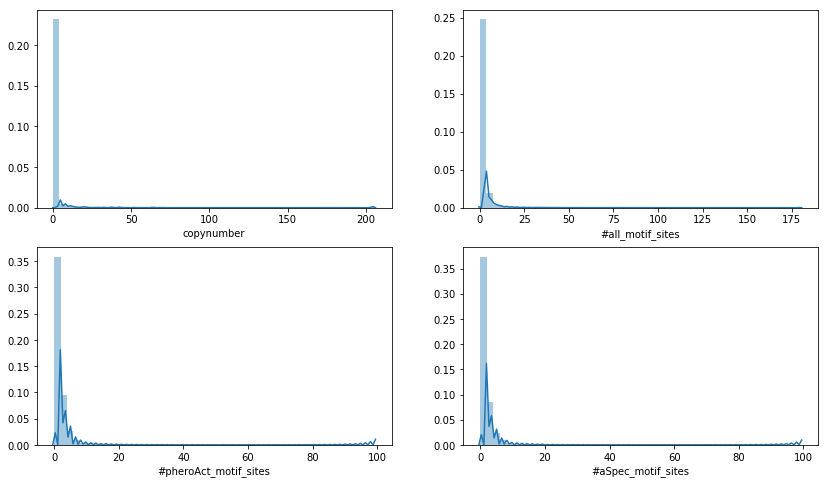

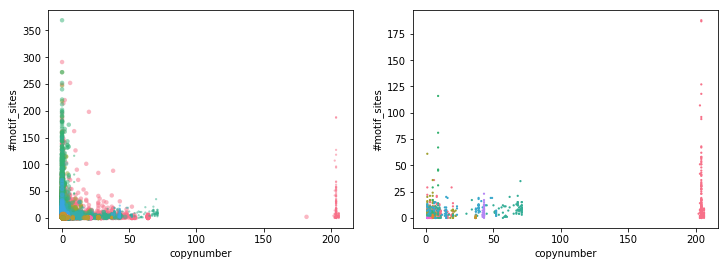

In [5]:
##Plotting the scores of candidates and see what I get.
candidate_score_dir = os.path.join(data_dir, "scores")
final_candidates_scoring_frame = pd.read_csv(os.path.join(candidate_score_dir, "candidates-super-significant_final-scoring_expansion.csv"), sep="\t", index_col='index')
#final_candidates_scoring_frame = pd.read_csv(os.path.join(candidate_score_dir, "candidates-super-significant_final-scoring.csv"), sep="\t", index_col='index')

####Modifying the final_candidates_scoring_frame to include a column that is a sum of all types of motifs.
final_candidates_scoring_frame['#motif_sites'] = final_candidates_scoring_frame.apply(lambda row: candidates_score_sum_motifs(row), axis=1)

print("\t".join(["Number of curated candidates:", str(len(final_candidates_scoring_frame[final_candidates_scoring_frame['curated_geneious_candidates'] == 1]))]))

####Changing 'Nan' to 0 in the columns I want to plot.
final_candidates_scoring_frame['#all_motif_sites'].replace(to_replace=np.nan, value=0, inplace=True);
final_candidates_scoring_frame['#pheroAct_motif_sites'].replace(to_replace=np.nan, value=0, inplace=True);
final_candidates_scoring_frame['#aSpec_motif_sites'].replace(to_replace=np.nan, value=0, inplace=True);

phylogenetic_group_label_order = final_candidates_scoring_frame['phylogenetic_group'].unique().tolist()
phylogenetic_group_label_order.sort(key=natural_keys)

fig1 = figure(figsize=(14,8))
ax1 = subplot(221)
ax1 = sns.distplot(final_candidates_scoring_frame['copynumber'])
#ax1.set_xscale('symlog')

ax2 = subplot(222)
ax2 = sns.distplot(final_candidates_scoring_frame['#all_motif_sites'])

ax3 = subplot(223)
ax3 = sns.distplot(final_candidates_scoring_frame['#pheroAct_motif_sites'])

ax4 = subplot(224)
ax4 = sns.distplot(final_candidates_scoring_frame['#aSpec_motif_sites'])


fig1, ax1 = plt.subplots(1, 2, figsize=(12,4))

phylogenetic_group_label_order = final_candidates_scoring_frame['phylogenetic_group'].unique().tolist()
phylogenetic_group_label_order.sort(key=natural_keys)

#ax5 = subplot(211)
sns.scatterplot(x="copynumber", y="#motif_sites", hue="phylogenetic_group", size="curated_geneious_candidates",
                data=final_candidates_scoring_frame, ax=ax1[0], legend=False, alpha=0.5, sizes=[20,5],
                hue_order=phylogenetic_group_label_order, edgecolor='none')
#lgd5 = ax5.legend(loc='center left', bbox_to_anchor=(-0.6, 0.5))
#ax5.set_xscale('symlog')
#ax5.set_yscale('symlog')

phylogenetic_group_label_order = final_candidates_scoring_frame[final_candidates_scoring_frame['curated_geneious_candidates'] == 1]['phylogenetic_group'].unique().tolist()
phylogenetic_group_label_order.sort(key=natural_keys)

#ax6 = subplot(221)
sns.scatterplot(x="copynumber", y="#motif_sites", hue="phylogenetic_group",
                data=final_candidates_scoring_frame[final_candidates_scoring_frame['curated_geneious_candidates']==1], ax=ax1[1], legend=False,
                hue_order=phylogenetic_group_label_order, s=5, edgecolor='none')
#ax6.legend(loc='center left', bbox_to_anchor=(1, 0.5))
#lgd6 = ax6.legend(loc='center left', bbox_to_anchor=(1, 0.5))
#plt.tight_layout()
#savefig(os.path.join(figure_dir, 'finalUniqueCandidate_score_scatter_210913.pdf'), dpi=300, transparent=True, bbox_extra_artists=(lgd5,lgd6), bbox_inches='tight')
#savefig(os.path.join(figure_dir, 'finalUniqueCandidate_score_scatter_211004.pdf'), dpi=300, transparent=True)

p-value between cumulative motif_sites of non-curated and curated by two-sample Kolmogorov-Smirnov test:	1.5182444361229736e-40
p-value between all mating gene motif_sites of non-curated and curated by two-sample Kolmogorov-Smirnov test:	4.053824295851379e-46
p-value between pheromone-activated motif_sites of non-curated and curated by two-sample Kolmogorov-Smirnov test:	1.6415357144003573e-30
p-value between a-specific motif_sites of non-curated and curated by two-sample Kolmogorov-Smirnov test:	4.241992734193701e-27


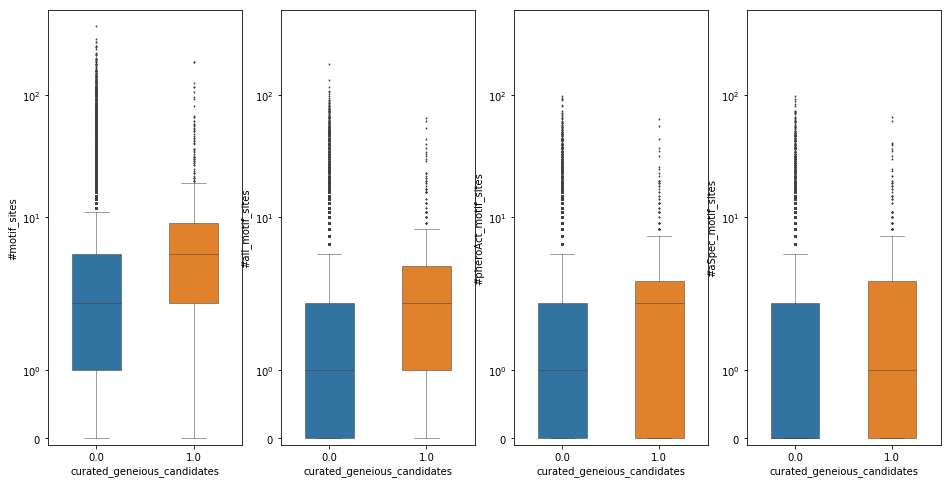

In [6]:
##Plotting the candidate, multicopy, #motif_sites, curated_candidate counts divided by phylogroups based on the expanded scoring csv.
candidate_score_dir = os.path.join(data_dir, "scores")
final_candidates_scoring_frame = pd.read_csv(os.path.join(candidate_score_dir, "candidates-super-significant_final-scoring_expansion.csv"), sep="\t", index_col='index')
#final_candidates_scoring_frame = pd.read_csv(os.path.join(candidate_score_dir, "candidates-super-significant_final-scoring.csv"), sep="\t", index_col='index')

final_candidates_scoring_frame['#motif_sites'] = final_candidates_scoring_frame.apply(lambda row: candidates_score_sum_motifs(row), axis=1)

#print(final_candidates_scoring_frame[final_candidates_scoring_frame['curated_geneious_candidates'] == 1]['#motif_sites'].values)
ks_stat, p_val = scp.stats.ks_2samp(final_candidates_scoring_frame[final_candidates_scoring_frame['curated_geneious_candidates'] == 1]['#motif_sites'].values,
                                    final_candidates_scoring_frame[final_candidates_scoring_frame['curated_geneious_candidates'] == 0]['#motif_sites'].values)
print("\t".join(["p-value between cumulative motif_sites of non-curated and curated by two-sample Kolmogorov-Smirnov test:", str(p_val)]))

ks_stat, p_val = scp.stats.ks_2samp(final_candidates_scoring_frame[final_candidates_scoring_frame['curated_geneious_candidates'] == 1]['#all_motif_sites'].values,
                                    final_candidates_scoring_frame[final_candidates_scoring_frame['curated_geneious_candidates'] == 0]['#all_motif_sites'].values)
print("\t".join(["p-value between all mating gene motif_sites of non-curated and curated by two-sample Kolmogorov-Smirnov test:", str(p_val)]))

ks_stat, p_val = scp.stats.ks_2samp(final_candidates_scoring_frame[final_candidates_scoring_frame['curated_geneious_candidates'] == 1]['#pheroAct_motif_sites'].values,
                                    final_candidates_scoring_frame[final_candidates_scoring_frame['curated_geneious_candidates'] == 0]['#pheroAct_motif_sites'].values)
print("\t".join(["p-value between pheromone-activated motif_sites of non-curated and curated by two-sample Kolmogorov-Smirnov test:", str(p_val)]))

ks_stat, p_val = scp.stats.ks_2samp(final_candidates_scoring_frame[final_candidates_scoring_frame['curated_geneious_candidates'] == 1]['#aSpec_motif_sites'].values,
                                    final_candidates_scoring_frame[final_candidates_scoring_frame['curated_geneious_candidates'] == 0]['#aSpec_motif_sites'].values)
print("\t".join(["p-value between a-specific motif_sites of non-curated and curated by two-sample Kolmogorov-Smirnov test:", str(p_val)]))
#sys.exit()

fig1, ax1 = plt.subplots(1, 4, figsize=(16,8))
sns.boxplot(x='curated_geneious_candidates', y='#motif_sites', data=final_candidates_scoring_frame, ax=ax1[0], width=0.5, linewidth=0.5, fliersize=1)
ax1[0].set_yscale('symlog')
ax1[0].set_ylim([-0.1, 500])

sns.boxplot(x='curated_geneious_candidates', y='#all_motif_sites', data=final_candidates_scoring_frame, ax=ax1[1], width=0.5, linewidth=0.5, fliersize=1)
ax1[1].set_yscale('symlog')
ax1[1].set_ylim([-0.1, 500])

sns.boxplot(x='curated_geneious_candidates', y='#pheroAct_motif_sites', data=final_candidates_scoring_frame, ax=ax1[2], width=0.5, linewidth=0.5, fliersize=1)
ax1[2].set_yscale('symlog')
ax1[2].set_ylim([-0.1, 500])

sns.boxplot(x='curated_geneious_candidates', y='#aSpec_motif_sites', data=final_candidates_scoring_frame, ax=ax1[3], width=0.5, linewidth=0.5, fliersize=1)
ax1[3].set_yscale('symlog')
ax1[3].set_ylim([-0.1, 500])

#savefig(os.path.join(figure_dir, 'motif-sites_binned-curation_211004.pdf'), dpi=300, transparent=True)

810


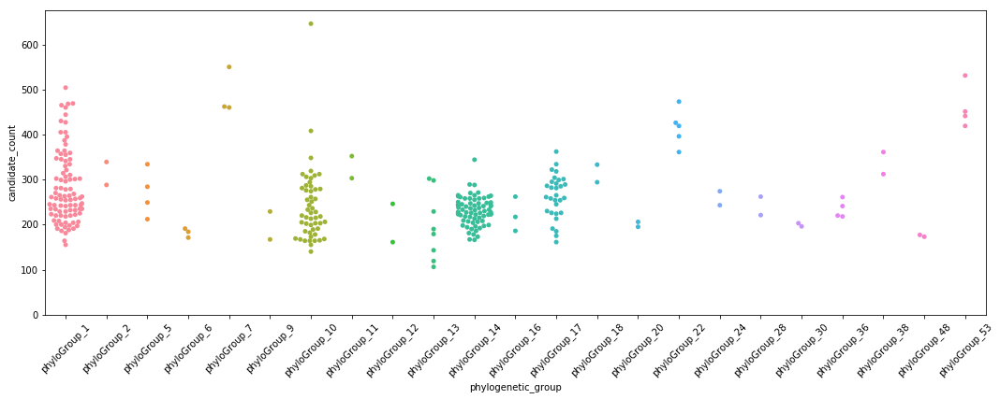

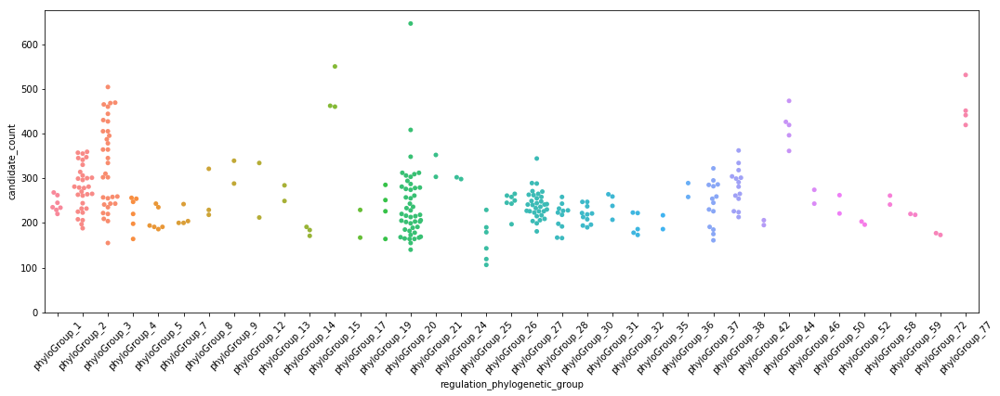

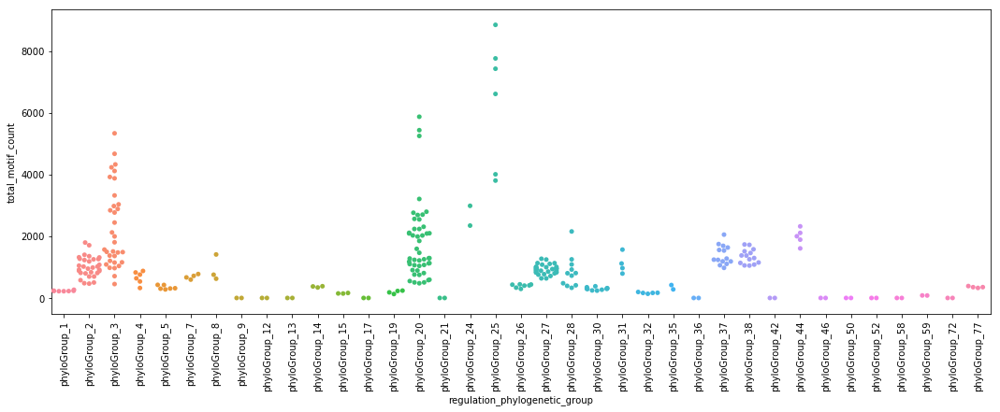

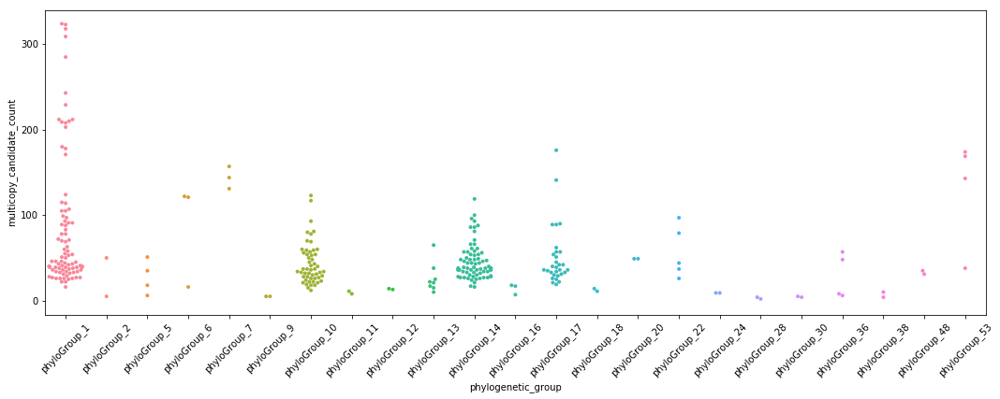

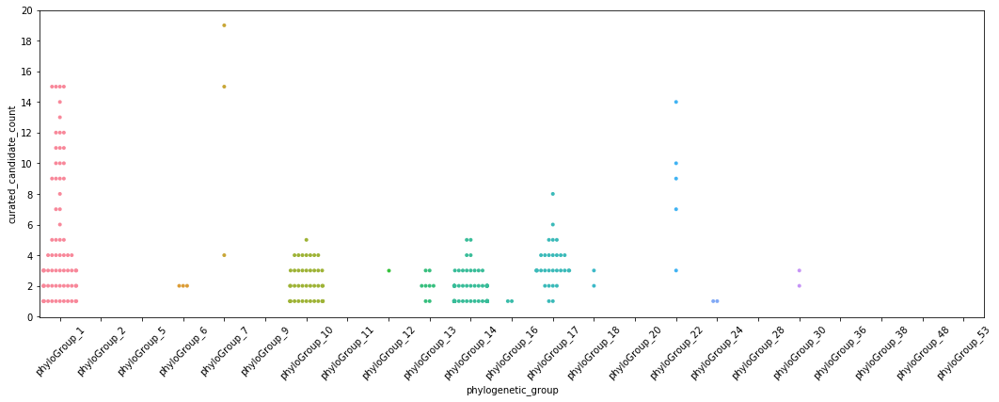

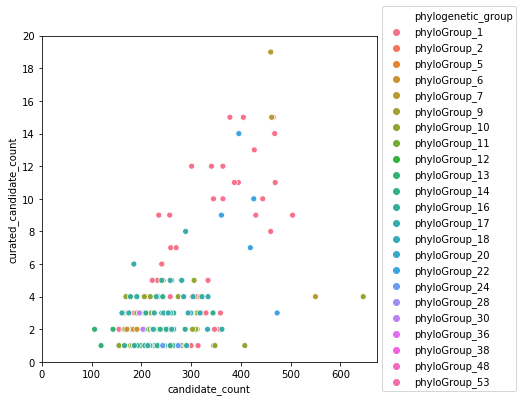

In [7]:
##Plotting the candidate, multicopy, #motif_sites, curated_candidate counts divided by phylogroups based on the expanded scoring csv.
candidate_score_dir = os.path.join(data_dir, "scores")
final_candidates_scoring_frame = pd.read_csv(os.path.join(candidate_score_dir, "candidates-super-significant_final-scoring_expansion.csv"), sep="\t", index_col='index')
#final_candidates_scoring_frame = pd.read_csv(os.path.join(candidate_score_dir, "candidates-super-significant_final-scoring_expansion_210905.csv"), sep="\t", index_col='index')
#final_candidates_scoring_frame = pd.read_csv(os.path.join(candidate_score_dir, "candidates-super-significant_final-scoring.csv"), sep="\t", index_col='index')

final_candidates_scoring_frame['#motif_sites'] = final_candidates_scoring_frame.apply(lambda row: candidates_score_sum_motifs(row), axis=1)

# print(final_candidates_scoring_frame[final_candidates_scoring_frame['species_name'] == 'saccharomyces_cerevisiae']['#motif_sites'].sum().astype(int))
# sys.exit()

phylogenetic_group_label_order = final_candidates_scoring_frame['phylogenetic_group'].unique().tolist()
phylogenetic_group_label_order.sort(key=natural_keys)
regulation_phylogenetic_group_label_order = final_candidates_scoring_frame['regulation_phylogenetic_group'].dropna().unique().tolist()
regulation_phylogenetic_group_label_order.sort(key=natural_keys)
# print(regulation_phylogenetic_group_label_order)
# print(len(regulation_phylogenetic_group_label_order))
# sys.exit()

temp_list = []
for species in final_candidates_scoring_frame['species_name'].unique():
    temp_list.append([species, final_candidates_scoring_frame[final_candidates_scoring_frame['species_name'] == species]['phylogenetic_group'].unique()[0], 
                     final_candidates_scoring_frame[final_candidates_scoring_frame['species_name'] == species]['regulation_phylogenetic_group'].unique()[0],
                     len(final_candidates_scoring_frame[final_candidates_scoring_frame['species_name'] == species]),
                     final_candidates_scoring_frame[final_candidates_scoring_frame['species_name'] == species]['#motif_sites'].sum().astype(int)])
#print(temp_list)
candidates_species_count = pd.DataFrame.from_records(temp_list, columns=["species_name", "phylogenetic_group", "regulation_phylogenetic_group", "candidate_count", 'total_motif_count'])
#curated_candidates_species_count.head()

fig4, ax = plt.subplots(1, 1, figsize=(18,6))
sns.swarmplot(x="phylogenetic_group", y="candidate_count", data=candidates_species_count, ax=ax, size=5, order=phylogenetic_group_label_order)
# sns.pointplot(x="phylogenetic_group", y="candidate_count", data=candidates_species_count, ax=ax,
#               estimator=mean, ci=None, join=False, markers='_', color='black', scale=2, order=phylogenetic_group_label_order)
plt.xticks(rotation=45);
plt.yticks(np.arange(0,700,step=100));
#savefig(os.path.join(figure_dir, 'candidates_per-species-count_210925.pdf'), dpi=300, transparent=True)

fig8, ax4 = plt.subplots(1, 1, figsize=(18,6))
sns.swarmplot(x="regulation_phylogenetic_group", y="candidate_count", data=candidates_species_count, ax=ax4, size=5, order=regulation_phylogenetic_group_label_order)
# sns.pointplot(x="regulation_phylogenetic_group", y="candidate_count", data=candidates_species_count, ax=ax4,
#               estimator=mean, ci=None, join=False, markers='_', color='black', scale=2, order=regulation_phylogenetic_group_label_order)
plt.xticks(rotation=45);
plt.yticks(np.arange(0,700,step=100));
#savefig(os.path.join(figure_dir, 'candidates_per-species-count_regulation-phylogroup_210912.pdf'), dpi=300, transparent=True)

fig9, ax5 = plt.subplots(1, 1, figsize=(18,6))
sns.swarmplot(x="regulation_phylogenetic_group", y="total_motif_count", data=candidates_species_count, ax=ax5, size=5, order=regulation_phylogenetic_group_label_order)
# sns.pointplot(x="regulation_phylogenetic_group", y="total_motif_count", data=candidates_species_count, ax=ax5,
#               estimator=mean, ci=None, join=False, markers='_', color='black', scale=2, order=regulation_phylogenetic_group_label_order)
plt.xticks(rotation=90);
plt.yticks(np.arange(0,9000,step=2000));
#savefig(os.path.join(figure_dir, 'motif-sites_per-species-count_regulation-phylogroup_210914.pdf'), dpi=300, transparent=True)


multicopy_final_candidates_scoring_frame = final_candidates_scoring_frame[final_candidates_scoring_frame['copynumber'] >= 1]
phylogenetic_group_label_order = multicopy_final_candidates_scoring_frame['phylogenetic_group'].unique().tolist()
phylogenetic_group_label_order.sort(key=natural_keys)

temp_list = []
for species in multicopy_final_candidates_scoring_frame['species_name'].unique():
    temp_list.append([species, multicopy_final_candidates_scoring_frame[multicopy_final_candidates_scoring_frame['species_name'] == species]['phylogenetic_group'].unique()[0], 
                     multicopy_final_candidates_scoring_frame[multicopy_final_candidates_scoring_frame['species_name'] == species]['regulation_phylogenetic_group'].unique()[0],
                     len(multicopy_final_candidates_scoring_frame[multicopy_final_candidates_scoring_frame['species_name'] == species])])
#print(temp_list)
multicopy_candidates_species_count = pd.DataFrame.from_records(temp_list, columns=["species_name", "phylogenetic_group", "regulation_phylogenetic_group", "multicopy_candidate_count"])
#multicopy_candidates_species_count.head()

fig5, ax1 = plt.subplots(1, 1, figsize=(18,6))
sns.swarmplot(x="phylogenetic_group", y="multicopy_candidate_count", data=multicopy_candidates_species_count, ax=ax1, size=4, order=phylogenetic_group_label_order)
# sns.pointplot(x="phylogenetic_group", y="multicopy_candidate_count", data=multicopy_candidates_species_count, ax=ax1,
#               estimator=mean, ci=None, join=False, markers='_', color='black', scale=2, order=phylogenetic_group_label_order)
plt.xticks(rotation=45);
plt.yticks(np.arange(0,310,step=100));
#savefig(os.path.join(figure_dir, 'multicopy-candidates_per-species-count_210925.pdf'), dpi=300, transparent=True)

curated_final_candidates_scoring_frame = final_candidates_scoring_frame[final_candidates_scoring_frame['curated_geneious_candidates'] == 1]
print(len(curated_final_candidates_scoring_frame))
#phylogenetic_group_label_order = curated_final_candidates_scoring_frame['phylogenetic_group'].unique().tolist()
#phylogenetic_group_label_order.sort(key=natural_keys)

temp_list = []
for species in curated_final_candidates_scoring_frame['species_name'].unique():
    temp_list.append([species, curated_final_candidates_scoring_frame[curated_final_candidates_scoring_frame['species_name'] == species]['phylogenetic_group'].unique()[0], 
                     curated_final_candidates_scoring_frame[curated_final_candidates_scoring_frame['species_name'] == species]['regulation_phylogenetic_group'].unique()[0],
                     len(curated_final_candidates_scoring_frame[curated_final_candidates_scoring_frame['species_name'] == species])])
#print(temp_list)
curated_candidates_species_count = pd.DataFrame.from_records(temp_list, columns=["species_name", "phylogenetic_group", "regulation_phylogenetic_group", "curated_candidate_count"])
#curated_candidates_species_count.head()

fig6, ax2 = plt.subplots(1, 1, figsize=(18,6))
sns.swarmplot(x="phylogenetic_group", y="curated_candidate_count", data=curated_candidates_species_count, ax=ax2, size=4, order=phylogenetic_group_label_order)
# sns.pointplot(x="phylogenetic_group", y="curated_candidate_count", data=curated_candidates_species_count, ax=ax2,
#               estimator=mean, ci=None, join=False, markers='_', color='black', scale=2, order=phylogenetic_group_label_order)
plt.xticks(rotation=45);
plt.yticks(np.arange(0,22,step=2));
#savefig(os.path.join(figure_dir, 'curated-candidates_per-species-count_211004.pdf'), dpi=300, transparent=True)
#savefig(os.path.join(figure_dir, 'curated-candidates-firstpass_per-species-count_210925.pdf'), dpi=300, transparent=True)

curated_candidates_species_count = curated_candidates_species_count.merge(candidates_species_count, how='inner', on=["species_name", "phylogenetic_group", "regulation_phylogenetic_group"])
fig7, ax3 = plt.subplots(1, 1, figsize=(6,6))
sns.scatterplot(x="candidate_count", y="curated_candidate_count", hue="phylogenetic_group", data=curated_candidates_species_count, ax=ax3, hue_order=phylogenetic_group_label_order)
plt.xticks(np.arange(0,700,step=100));
plt.yticks(np.arange(0,22,step=2));
lgd = ax3.legend(loc='center left', bbox_to_anchor=(1, 0.5))
#savefig(os.path.join(figure_dir, 'curated-candidates_candidates_scatter_211004.pdf'), dpi=300, transparent=True)

17931


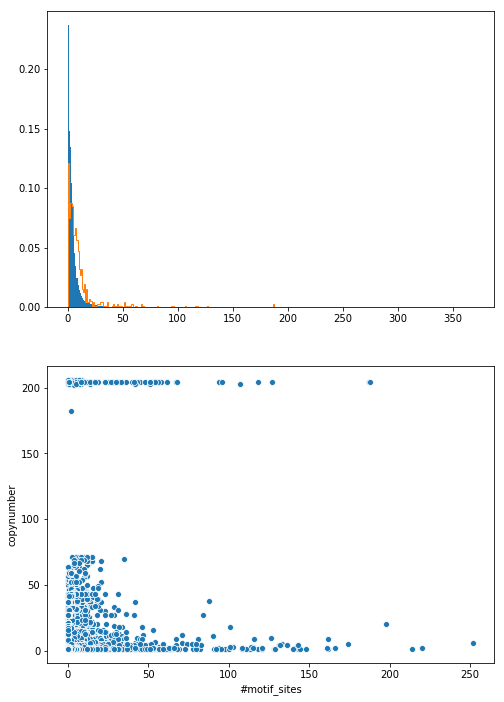

In [29]:
##Plotting the motif counts of candidates based on the expanded scoring csv.
candidate_score_dir = os.path.join(data_dir, "scores")
final_candidates_scoring_frame = pd.read_csv(os.path.join(candidate_score_dir, "candidates-super-significant_final-scoring_expansion.csv"), sep="\t", index_col='index')
#final_candidates_scoring_frame = pd.read_csv(os.path.join(candidate_score_dir, "candidates-super-significant_final-scoring.csv"), sep="\t", index_col='index')

####Modifying the final_candidates_scoring_frame to include a column that is a sum of all types of motifs.
final_candidates_scoring_frame['#motif_sites'] = final_candidates_scoring_frame.apply(lambda row: candidates_score_sum_motifs(row), axis=1)

####Changing 'Nan' to 0 in the columns I want to plot.
final_candidates_scoring_frame['#all_motif_sites'].replace(to_replace=np.nan, value=0, inplace=True);
final_candidates_scoring_frame['#pheroAct_motif_sites'].replace(to_replace=np.nan, value=0, inplace=True);
final_candidates_scoring_frame['#aSpec_motif_sites'].replace(to_replace=np.nan, value=0, inplace=True);
#final_candidates_scoring_frame['#motif_sites'].replace(to_replace=np.nan, value=0, inplace=True);

#final_candidates_scoring_frame.head()
print(len(final_candidates_scoring_frame[final_candidates_scoring_frame['#motif_sites'] == 0]))

fig2 = figure(figsize=(8,12))
ax5 = subplot(211)
ax5 = plt.hist(final_candidates_scoring_frame['#motif_sites'].values, bins=list(range(0, max(final_candidates_scoring_frame['#motif_sites'].values.astype(int))+1)), density=True)
ax5 = plt.hist(final_candidates_scoring_frame[final_candidates_scoring_frame['curated_geneious_candidates'] == 1]['#motif_sites'].values, 
               bins=list(range(0, max(final_candidates_scoring_frame[final_candidates_scoring_frame['curated_geneious_candidates'] == 1]['#motif_sites'].values.astype(int))+1)), 
               density=True, histtype='step')
#ax5 = sns.swarmplot(x="curated_geneious_candidates", y="#motif_sites", hue="regulation_phylogenetic_group", data=final_candidates_scoring_frame, alpha=0.5)
#lgd5 = ax5.legend(loc='center left', bbox_to_anchor=(1, 0.5))

ax6 = subplot(212)
ax6 = sns.scatterplot(x="#motif_sites", y="copynumber", data=final_candidates_scoring_frame[final_candidates_scoring_frame['copynumber'] > 0])
#ax6.legend(loc='center left', bbox_to_anchor=(1, 0.5))
#lgd6 = ax6.legend(loc='center left', bbox_to_anchor=(1, 0.5))

Index([u'species_name', u'phylogenetic_group', u'chromosome_id', u'cys_pos',
       u'stop_pos', u'aa_seq', u'dna_seq', u'copynumber',
       u'regulation_phylogenetic_group', u'#all_motif_sites',
       u'#pheroAct_motif_sites', u'#aSpec_motif_sites', u'all_motif_1_evalue',
       u'#all_motif_1_sites', u'all_motif_2_evalue', u'#all_motif_2_sites',
       u'all_motif_3_evalue', u'#all_motif_3_sites',
       u'pheroAct_motif_1_evalue', u'#pheroAct_motif_1_sites',
       u'pheroAct_motif_2_evalue', u'#pheroAct_motif_2_sites',
       u'pheroAct_motif_3_evalue', u'#pheroAct_motif_3_sites',
       u'aSpec_motif_1_evalue', u'#aSpec_motif_1_sites',
       u'aSpec_motif_2_evalue', u'#aSpec_motif_2_sites',
       u'aSpec_motif_3_evalue', u'#aSpec_motif_3_sites',
       u'curated_geneious_candidates'],
      dtype='object')
3.0999999999999963e-247


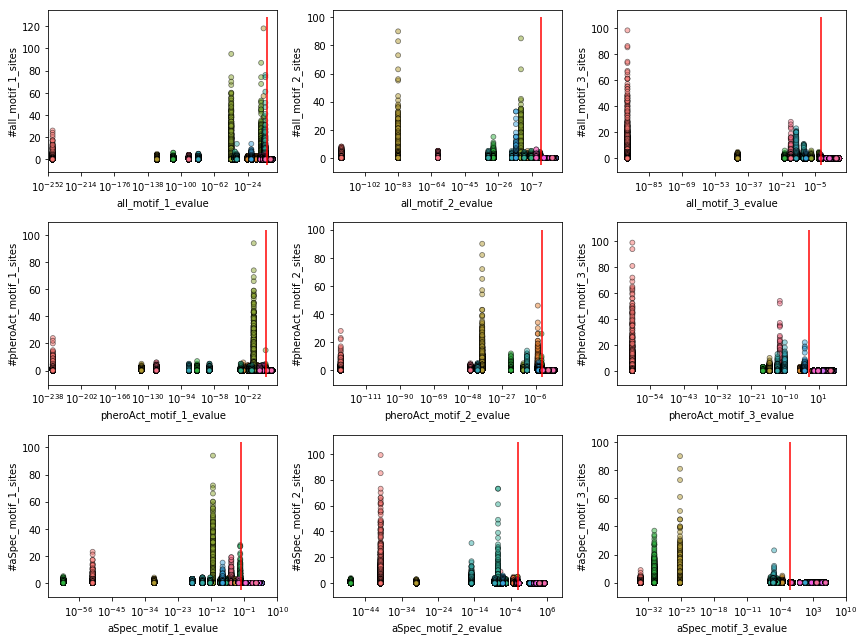

In [159]:
##Plotting the motif counts of candidates based on the expanded scoring csv.
candidate_score_dir = os.path.join(data_dir, "scores")
final_candidates_scoring_frame = pd.read_csv(os.path.join(candidate_score_dir, "candidates-super-significant_final-scoring_expansion.csv"), sep="\t", index_col='index')
#final_candidates_scoring_frame = pd.read_csv(os.path.join(candidate_score_dir, "candidates-super-significant_final-scoring.csv"), sep="\t", index_col='index')

print(final_candidates_scoring_frame.columns)
print(final_candidates_scoring_frame['all_motif_1_evalue'].min())

geneset_list = ["all", "pheroAct", "aSpec"]
motif_list = ["1", "2", "3"]

fig3, ax_array = plt.subplots(3, 3, figsize=(12,9))
for geneset in geneset_list:
    for motif in motif_list:
        #print(int(str(geneset_list.index(geneset)+1)+str(motif_list.index(motif)+1)+"9"))
        #sys.exit()
        #ax_array[] = subplot(str(geneset_list.index(geneset)+1)+str(motif_list.index(motif)+1)+"9")
        #print([geneset_list.index(geneset), motif_list.index(motif)])
#         sns.pointplot(x=geneset+"_motif_"+motif+"_evalue", y="#"+geneset+"_motif_"+motif+"_sites", hue="regulation_phylogenetic_group",
#                       data=final_candidates_scoring_frame, ax=ax_array[geneset_list.index(geneset), motif_list.index(motif)],
#                       join=False, estimator=np.mean, ci=95, legend=False, s=5, alpha=0.5, edgecolor='black')
        sns.scatterplot(x=geneset+"_motif_"+motif+"_evalue", y="#"+geneset+"_motif_"+motif+"_sites", hue="regulation_phylogenetic_group", 
                        data=final_candidates_scoring_frame, ax=ax_array[geneset_list.index(geneset), motif_list.index(motif)], legend=False, s=25, alpha=0.5, edgecolor='black')
        ax_array[geneset_list.index(geneset), motif_list.index(motif)].set_xscale('log')
        ax_array[geneset_list.index(geneset), motif_list.index(motif)].set_xlim([final_candidates_scoring_frame[geneset+"_motif_"+motif+"_evalue"].min()/1e5, 1e10])
        ax_array[geneset_list.index(geneset), motif_list.index(motif)].vlines(1e-2, -5, final_candidates_scoring_frame["#"+geneset+"_motif_"+motif+"_sites"].max()+10, colors="red", linestyles="solid")
        #sys.exit()
plt.tight_layout()

savefig(os.path.join(figure_dir, 'finalPromoterMotif_evalue-FIMOhits_210908.pdf'), dpi=300, transparent=True)

In [81]:
##Trying to incorporate pheromone phylogroup and regulation phylogroup information into candidateStats.
candidate_score_dir = os.path.join(data_dir, "scores")
final_candidates_scoring_frame = pd.read_csv(os.path.join(candidate_score_dir, "candidates-super-significant_final-scoring_expansion.csv"), sep="\t", index_col='index')
#final_candidates_scoring_frame = pd.read_csv(os.path.join(candidate_score_dir, "candidates-super-significant_final-scoring.csv"), sep="\t", index_col='index')

species_list = final_candidates_scoring_frame[['species_name', 'phylogenetic_group', 'regulation_phylogenetic_group']].copy()
print(len(species_list))
species_list = species_list.drop_duplicates()
species_list.columns = species_list.columns.str.replace('_', ' ')
species_list.columns = species_list.columns.str.replace('species name', 'Species')
print("No. of species in phylogenetic groups:\t", len(species_list))

candidate_stats = pd.read_csv(os.path.join(data_dir, "20210715_candidateStats_332yeasts.csv"), sep=",")
candidate_stats_total = pd.merge(candidate_stats, species_list, how="left", on='Species')
#candidate_stats_total.to_csv(os.path.join(data_dir, "20210905_332yeast_candidateStats_grouping.csv"), sep="\t", header=True, index=False)

78206
('No. of species in phylogenetic groups:\t', 300)


In [71]:
candidate_score_dir = os.path.join(data_dir, "scores")
final_candidates_scoring_frame = pd.read_csv(os.path.join(candidate_score_dir, "candidates-super-significant_final-scoring_expansion.csv"), sep="\t", index_col='index')
species_list = final_candidates_scoring_frame[['species_name', 'phylogenetic_group', 'regulation_phylogenetic_group']].copy().drop_duplicates()
print(len(species_list))
species_list.head()

300


,species_name,phylogenetic_group,regulation_phylogenetic_group
index,,,
0,candida_albicans,phyloGroup_1,phyloGroup_2
281,candida_auris,phyloGroup_1,phyloGroup_3
539,candida_carpophila,phyloGroup_1,phyloGroup_7
739,candida_dubliniensis,phyloGroup_1,phyloGroup_2
1020,candida_homilentoma,phyloGroup_1,phyloGroup_4


In [86]:
phylogroup_size = species_list.fillna('minor').pivot_table(index = ['phylogenetic_group'], aggfunc='size')
#print(species_list[species_list['phylogenetic_group'] == 'phyloGroup_1']['regulation_phylogenetic_group'].unique())
print(phylogroup_size)

regulation_phylogroup_size = species_list.fillna('minor').pivot_table(index = ['phylogenetic_group', 'regulation_phylogenetic_group'], aggfunc='size')
#print(species_list[species_list['phylogenetic_group'] == 'phyloGroup_1']['regulation_phylogenetic_group'].unique())
print(regulation_phylogroup_size)

phylogenetic_group
phyloGroup_1     91
phyloGroup_10    52
phyloGroup_11     2
phyloGroup_12     2
phyloGroup_13     8
phyloGroup_14    71
phyloGroup_16     3
phyloGroup_17    30
phyloGroup_18     2
phyloGroup_2      2
phyloGroup_20     2
phyloGroup_22     5
phyloGroup_24     2
phyloGroup_28     2
phyloGroup_30     2
phyloGroup_36     4
phyloGroup_38     2
phyloGroup_48     2
phyloGroup_5      4
phyloGroup_53     4
phyloGroup_6      3
phyloGroup_7      3
phyloGroup_9      2
dtype: int64
phylogenetic_group  regulation_phylogenetic_group
phyloGroup_1        minor                             1
                    phyloGroup_1                      7
                    phyloGroup_2                     31
                    phyloGroup_3                     33
                    phyloGroup_4                      6
                    phyloGroup_5                      6
                    phyloGroup_7                      4
                    phyloGroup_8                      3
phyloGroup

In [83]:
candidate_stats_total.head()

,Species,No. of scaffolds,Genome Size (bp),No. of protein models,No. of CAAX-Stop candidates,No. of Asn...CAAX-Stop candidates,No. of unique locus Asn...CAAX-Stop candidates,phylogenetic group,regulation phylogenetic group
0,yHAB160_kazachstania_kunashirensis_160519,353,10985687,5288,584,323,241,phyloGroup_14,phyloGroup_27
1,lachancea_fantastica,7,11336659,5002,769,313,247,phyloGroup_14,phyloGroup_30
2,yHMPu5000034615_saturnispora_zaruensis_160519,391,9901215,5023,562,267,189,phyloGroup_10,phyloGroup_20
3,lipomyces_starkeyi,117,21267709,8889,1964,785,531,phyloGroup_53,phyloGroup_77
4,ashbya_aceri,8,8894523,4322,868,250,178,phyloGroup_14,phyloGroup_32


332


(50, 1050)

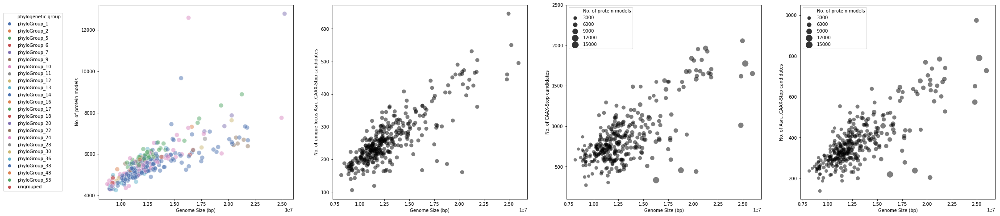

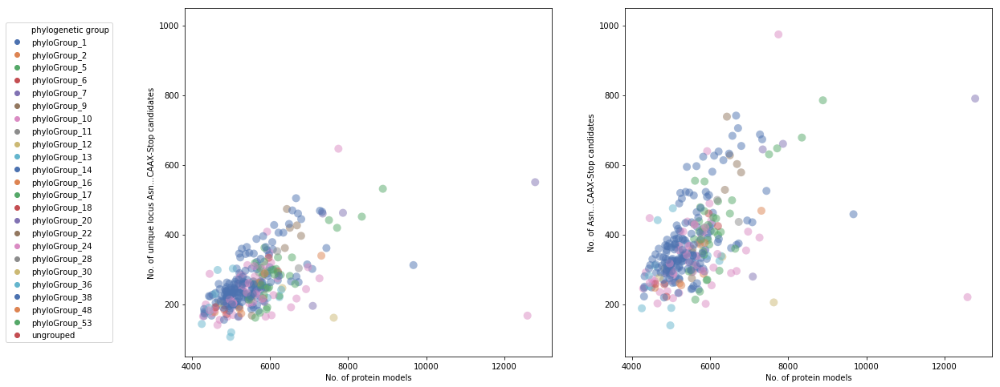

In [20]:
##Plotting the stats of genomes, proteomes and candidates identified.
#candidate_stats = pd.read_csv(os.path.join(data_dir, "20210715_candidateStats_332yeasts.csv"), sep=",")
candidate_stats = pd.read_csv(os.path.join(data_dir, "20210905_332yeast_candidateStats_grouping.csv"), sep="\t")
#candidate_stats = pd.read_csv(os.path.join(data_dir, "20210715_332yeast_candidateStats_grouping.csv"), sep="\t")
#candidate_stats.columns = candidate_stats.columns.str.replace(' ','_')
print(len(candidate_stats))
phylogenetic_group_label_order = candidate_stats['phylogenetic group'].fillna(value="ungrouped").unique().tolist()
phylogenetic_group_label_order.sort(key=natural_keys)

fig1 = figure(figsize=(36,8))
ax5 = subplot(141)
ax5 = sns.scatterplot(x='Genome Size (bp)', y="No. of protein models", hue='phylogenetic group', data=candidate_stats, 
                      palette='deep', s=100, legend='brief', alpha=0.5, hue_order=phylogenetic_group_label_order)
lgd5 = ax5.legend(loc='center left', bbox_to_anchor=(-0.5, 0.5))
#ax5.set_xscale('symlog')
#ax5.set_yscale('symlog')

ax6 = subplot(142)
ax6 = sns.scatterplot(x='Genome Size (bp)', y="No. of unique locus Asn...CAAX-Stop candidates", data=candidate_stats, color='black', s=80, legend='full', alpha=0.5, edgecolor='none')
#lgd6 = ax6.legend(loc='center left', bbox_to_anchor=(1, 0.5))

ax7 = subplot(143)
ax7 = sns.scatterplot(x='Genome Size (bp)', y="No. of CAAX-Stop candidates", size='No. of protein models', data=candidate_stats, color='black', sizes=(50,200), alpha=0.5, edgecolor='none')
ax7.set_ylim([100, 2500])

ax8 = subplot(144)
ax8 = sns.scatterplot(x='Genome Size (bp)', y="No. of Asn...CAAX-Stop candidates", size='No. of protein models', data=candidate_stats, color='black', sizes=(50,200), alpha=0.5, edgecolor='none')
ax8.set_ylim([100, 1050])
#savefig(os.path.join(figure_dir, 'candidateStats_211212.pdf'), dpi=300, transparent=True, bbox_inches='tight')

fig2 = figure(figsize=(18,8))
ax9 = subplot(121)
ax9 = sns.scatterplot(x='No. of protein models', y="No. of unique locus Asn...CAAX-Stop candidates", hue='phylogenetic group', data=candidate_stats, 
                      palette='deep', s=100, legend='brief', alpha=0.5, hue_order=phylogenetic_group_label_order, edgecolor='none')
lgd9 = ax9.legend(loc='center left', bbox_to_anchor=(-0.5, 0.5))
ax9.set_ylim([50, 1050])
#ax9.set_xscale('symlog')
#ax9.set_yscale('symlog')

ax10 = subplot(122)
ax10 = sns.scatterplot(x='No. of protein models', y="No. of Asn...CAAX-Stop candidates", hue='phylogenetic group', data=candidate_stats, 
                      palette='deep', s=100, legend=None, alpha=0.5, hue_order=phylogenetic_group_label_order, edgecolor='none')
ax10.set_ylim([50, 1050])
#savefig(os.path.join(figure_dir, 'candidateStats_candidate-protein-model-comparisson_210912.pdf'), dpi=300, transparent=True, bbox_inches='tight')

[(0.796875, 0, 0.796875), (0.19607843137254902, 0.803921568627451, 0.19607843137254902), (0.25098039215686274, 0.8784313725490196, 0.8156862745098039), (1.0, 0.0, 0.0), (0.75, 0.75, 0.0), (0.2549019607843137, 0.4117647058823529, 0.8823529411764706), (0.0, 0.0, 0.0)]


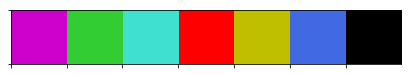

In [9]:
##Setting palettes to work with.
#test_palette = sns.color_palette("Blues", 6)[2:] + sns.color_palette("Reds", 6)[2:] + [matplotlib.colors.to_rgb("Black")]
#test_palette = [matplotlib.colors.to_rgb("darkviolet")] + [matplotlib.colors.to_rgb("limegreen")] + [matplotlib.colors.to_rgb("turquoise")] + [matplotlib.colors.to_rgb("Red")] + [matplotlib.colors.to_rgb("y")] + [matplotlib.colors.to_rgb("royalblue")] + [matplotlib.colors.to_rgb("Black")]
test_palette = [(0.796875,0,0.796875)] + [matplotlib.colors.to_rgb("limegreen")] + [matplotlib.colors.to_rgb("turquoise")] + [matplotlib.colors.to_rgb("Red")] + [matplotlib.colors.to_rgb("y")] + [matplotlib.colors.to_rgb("royalblue")] + [matplotlib.colors.to_rgb("Black")]
print(test_palette)
sns.palplot(test_palette)

332


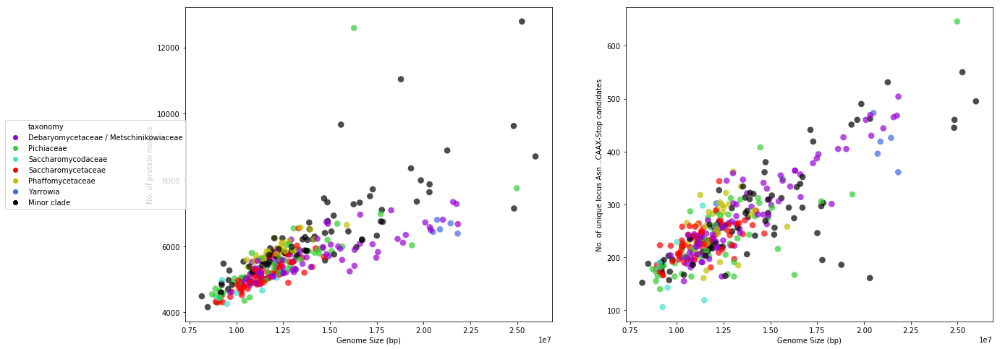

In [16]:
##Plotting the stats of genomes, proteomes and candidates identified.
#candidate_stats = pd.read_csv(os.path.join(data_dir, "20210715_candidateStats_332yeasts.csv"), sep=",")
candidate_stats = pd.read_csv(os.path.join(data_dir, "20210905_332yeast_candidateStats_grouping.csv"), sep="\t")
#candidate_stats = pd.read_csv(os.path.join(data_dir, "20210715_332yeast_candidateStats_grouping.csv"), sep="\t")
#candidate_stats.columns = candidate_stats.columns.str.replace(' ','_')
print(len(candidate_stats))
phylogenetic_group_label_order = ["Debaryomycetaceae / Metschinikowiaceae", "Pichiaceae", "Saccharomycodaceae", "Saccharomycetaceae", "Phaffomycetaceae", "Yarrowia", "Minor clade"]
phylogenetic_palette = [matplotlib.colors.to_rgb("darkviolet")] + [matplotlib.colors.to_rgb("limegreen")] + [matplotlib.colors.to_rgb("turquoise")] + [matplotlib.colors.to_rgb("Red")] + [matplotlib.colors.to_rgb("y")] + [matplotlib.colors.to_rgb("royalblue")] + [matplotlib.colors.to_rgb("Black")]

##I am going to add a new column 'taxonomy' to give the family names of the large major lineages I am going to work with and specifically to color match the circular cladogram in Figure 2.
candidate_stats['taxonomy'] = "Minor clade"
#phyloGroup1 corresponds to Debaryomycetaceae / Metschinikowiaceae
candidate_stats.loc[candidate_stats['phylogenetic group'] == "phyloGroup_1", 'taxonomy'] = "Debaryomycetaceae / Metschinikowiaceae"
#phyloGroup10 corresponds to Pichiaceae
candidate_stats.loc[candidate_stats['phylogenetic group'] == "phyloGroup_10", 'taxonomy'] = "Pichiaceae"
#phyloGroup13 corresponds to Saccharomycodaceae
candidate_stats.loc[candidate_stats['phylogenetic group'] == "phyloGroup_13", 'taxonomy'] = "Saccharomycodaceae"
#phyloGroup14 corresponds to Saccharomycetaceae
candidate_stats.loc[candidate_stats['phylogenetic group'] == "phyloGroup_14", 'taxonomy'] = "Saccharomycetaceae"
#phyloGroup17 corresponds to Phaffomycetaceae
candidate_stats.loc[candidate_stats['phylogenetic group'] == "phyloGroup_17", 'taxonomy'] = "Phaffomycetaceae"
#phyloGroup17 corresponds to Yarrowia genus
candidate_stats.loc[candidate_stats['phylogenetic group'] == "phyloGroup_22", 'taxonomy'] = "Yarrowia"


fig1 = figure(figsize=(20,8))
ax5 = subplot(121)
ax5 = sns.scatterplot(x='Genome Size (bp)', y="No. of protein models", hue='taxonomy', data=candidate_stats, 
                      palette=phylogenetic_palette, s=75, legend='brief', alpha=0.7, edgecolor='none', hue_order=phylogenetic_group_label_order)
lgd5 = ax5.legend(loc='center left', bbox_to_anchor=(-0.5, 0.5))
#ax5.set_xscale('symlog')
#ax5.set_yscale('symlog')

ax6 = subplot(122)
ax6 = sns.scatterplot(x='Genome Size (bp)', y="No. of unique locus Asn...CAAX-Stop candidates", hue='taxonomy', data=candidate_stats, 
                      palette=phylogenetic_palette, s=75, legend=False, alpha=0.7, edgecolor='none', hue_order=phylogenetic_group_label_order)
#lgd6 = ax6.legend(loc='center left', bbox_to_anchor=(1, 0.5))

#savefig(os.path.join(figure_dir, 'candidateStats_taxonomy-colored_211004.pdf'), dpi=300, transparent=True)

In [36]:
candidate_stats.head()

,Species,No. of scaffolds,Genome Size (bp),No. of protein models,No. of CAAX-Stop candidates,No. of Asn...CAAX-Stop candidates,No. of unique locus Asn...CAAX-Stop candidates,phylogenetic group,regulation phylogenetic group
0,yHAB160_kazachstania_kunashirensis_160519,353,10985687,5288,584,323,241,phyloGroup_14,phyloGroup_27
1,lachancea_fantastica,7,11336659,5002,769,313,247,phyloGroup_14,phyloGroup_30
2,yHMPu5000034615_saturnispora_zaruensis_160519,391,9901215,5023,562,267,189,phyloGroup_10,phyloGroup_20
3,lipomyces_starkeyi,117,21267709,8889,1964,785,531,phyloGroup_53,phyloGroup_77
4,ashbya_aceri,8,8894523,4322,868,250,178,phyloGroup_14,phyloGroup_32


In [5]:
##Checking number of candidates from the curated list that are found in different species.
candidate_score_dir = os.path.join(data_dir, "scores")
final_candidates_scoring_frame = pd.read_csv(os.path.join(candidate_score_dir, "candidates-super-significant_final-scoring_expansion.csv"), sep="\t", index_col='index')
#final_candidates_scoring_frame = pd.read_csv(os.path.join(candidate_score_dir, "candidates_final-scoring.csv"), sep="\t", index_col='index')

print("\t".join(["Number of unique loci candidates:", str(len(final_candidates_scoring_frame))]))

copynumber_candidates = final_candidates_scoring_frame[final_candidates_scoring_frame['copynumber'] >= 1].copy()
print("\t".join(["Number of unique loci candidates encoded in multiple loci with phylogenetic group:", str(len(copynumber_candidates))]))
print("\t".join(["Number of species that mave multiply-encoded candidates:", str(len(copynumber_candidates['species_name'].unique()))]))

curated_candidates = final_candidates_scoring_frame[final_candidates_scoring_frame['curated_geneious_candidates'] == 1].copy()
print("\t".join(["Number of curated pheromones from geneious curation:", str(len(curated_candidates))]))
print("\t".join(["Number of species represented in curated candidates:", str(len(curated_candidates['species_name'].unique()))]))
print("\t".join(["Number of pheromone phylogenetic groups represented in curated canidates:", str(len(curated_candidates['phylogenetic_group'].unique()))]))

print("\t".join(["Number of species represented in curated candidates of candida phyloGroup_1 of total:", 
                 str(len(curated_candidates[curated_candidates['phylogenetic_group'] == "phyloGroup_1"]['species_name'].unique())), 
                 str(len(final_candidates_scoring_frame[final_candidates_scoring_frame['phylogenetic_group'] == "phyloGroup_1"]['species_name'].unique()))
                ]))
#print(final_candidates_scoring_frame[final_candidates_scoring_frame['phylogenetic_group'] == "phyloGroup_1"]['species_name'].unique())
print("\t".join(["Missing canidates in:", "phyloGroup_1"]))
print("\n".join(list(set(final_candidates_scoring_frame[final_candidates_scoring_frame['phylogenetic_group'] == "phyloGroup_1"]['species_name'].unique().tolist()) 
      - set(curated_candidates[curated_candidates['phylogenetic_group'] == "phyloGroup_1"]['species_name'].unique().tolist()))))
print("----\n")

print("\t".join(["Number of species represented in curated candidates of pichia phyloGroup_10 of total", 
                 str(len(curated_candidates[curated_candidates['phylogenetic_group'] == "phyloGroup_10"]['species_name'].unique())), 
                 str(len(final_candidates_scoring_frame[final_candidates_scoring_frame['phylogenetic_group'] == "phyloGroup_10"]['species_name'].unique()))
                ]))
#print(final_candidates_scoring_frame[final_candidates_scoring_frame['phylogenetic_group'] == "phyloGroup_10"]['species_name'].unique())
print("\t".join(["Missing canidates in:", "phyloGroup_10"]))
print("\n".join(list(set(final_candidates_scoring_frame[final_candidates_scoring_frame['phylogenetic_group'] == "phyloGroup_10"]['species_name'].unique().tolist()) 
      - set(curated_candidates[curated_candidates['phylogenetic_group'] == "phyloGroup_10"]['species_name'].unique().tolist()))))
print("----\n")

print("\t".join(["Number of species represented in curated candidates of hanseniaspora phyloGroup_13 of total", 
                 str(len(curated_candidates[curated_candidates['phylogenetic_group'] == "phyloGroup_13"]['species_name'].unique())), 
                 str(len(final_candidates_scoring_frame[final_candidates_scoring_frame['phylogenetic_group'] == "phyloGroup_13"]['species_name'].unique()))
                ]))
#print(final_candidates_scoring_frame[final_candidates_scoring_frame['phylogenetic_group'] == "phyloGroup_13"]['species_name'].unique())
print("\t".join(["Missing canidates in:", "phyloGroup_13"]))
print("\n".join(list(set(final_candidates_scoring_frame[final_candidates_scoring_frame['phylogenetic_group'] == "phyloGroup_13"]['species_name'].unique().tolist()) 
      - set(curated_candidates[curated_candidates['phylogenetic_group'] == "phyloGroup_13"]['species_name'].unique().tolist()))))
print("----\n")

print("\t".join(["Number of species represented in curated candidates of saccharomyces phyloGroup_14 of total", 
                 str(len(curated_candidates[curated_candidates['phylogenetic_group'] == "phyloGroup_14"]['species_name'].unique())), 
                 str(len(final_candidates_scoring_frame[final_candidates_scoring_frame['phylogenetic_group'] == "phyloGroup_14"]['species_name'].unique()))
                ]))
#print(final_candidates_scoring_frame[final_candidates_scoring_frame['phylogenetic_group'] == "phyloGroup_14"]['species_name'].unique())
print("\t".join(["Missing canidates in:", "phyloGroup_14"]))
print("\n".join(list(set(final_candidates_scoring_frame[final_candidates_scoring_frame['phylogenetic_group'] == "phyloGroup_14"]['species_name'].unique().tolist()) 
      - set(curated_candidates[curated_candidates['phylogenetic_group'] == "phyloGroup_14"]['species_name'].unique().tolist()))))
print("----\n")

print("\t".join(["Number of species represented in curated candidates of phaffomyces phyloGroup_17 of total", 
                 str(len(curated_candidates[curated_candidates['phylogenetic_group'] == "phyloGroup_17"]['species_name'].unique())), 
                 str(len(final_candidates_scoring_frame[final_candidates_scoring_frame['phylogenetic_group'] == "phyloGroup_17"]['species_name'].unique()))
                ]))
#print(final_candidates_scoring_frame[final_candidates_scoring_frame['phylogenetic_group'] == "phyloGroup_17"]['species_name'].unique())
print("\t".join(["Missing canidates in:", "phyloGroup_17"]))
print("\n".join(list(set(final_candidates_scoring_frame[final_candidates_scoring_frame['phylogenetic_group'] == "phyloGroup_17"]['species_name'].unique().tolist()) 
      - set(curated_candidates[curated_candidates['phylogenetic_group'] == "phyloGroup_17"]['species_name'].unique().tolist()))))
print("----\n")

print("\t".join(["Number of species represented in curated candidates of yarrowia phyloGroup_22 of total", 
                 str(len(curated_candidates[curated_candidates['phylogenetic_group'] == "phyloGroup_22"]['species_name'].unique())), 
                 str(len(final_candidates_scoring_frame[final_candidates_scoring_frame['phylogenetic_group'] == "phyloGroup_22"]['species_name'].unique()))
                ]))
#print(final_candidates_scoring_frame[final_candidates_scoring_frame['phylogenetic_group'] == "phyloGroup_22"]['species_name'].unique())
print("\t".join(["Missing canidates in:", "phyloGroup_22"]))
print("\n".join(list(set(final_candidates_scoring_frame[final_candidates_scoring_frame['phylogenetic_group'] == "phyloGroup_22"]['species_name'].unique().tolist()) 
      - set(curated_candidates[curated_candidates['phylogenetic_group'] == "phyloGroup_22"]['species_name'].unique().tolist()))))
print("----\n")

Number of unique loci candidates:	78206
Number of unique loci candidates encoded in multiple loci with phylogenetic group:	17125
Number of species that mave multiply-encoded candidates:	300
Number of curated pheromones from geneious curation:	810
Number of species represented in curated candidates:	240
Number of pheromone phylogenetic groups represented in curated canidates:	13
Number of species represented in curated candidates of candida phyloGroup_1 of total:	70	91
Missing canidates in:	phyloGroup_1
yHMPu5000034988_candida_fructus_160519
lodderomyces_elongisporus
yHMPu5000035297_priceomyces_castillae_160928
scheffersomyces_stipitis
candida_sojae
yHMPu5000035335_candida_blattae_160928
yHMPu5000034632_candida_athensensis_160519
clavispora_lusitaniae
wickerhamia_fluorescens
hyphopichia_burtonii
yHMPu5000034986_candida_oregonensis_160519
yHMPu5000035662_meyerozyma_caribbica_160613
yHMPu5000035296_priceomyces_carsonii_160928
yHMPu5000034973_danielozyma_ontarioensis_160519
millerozyma_aca

## Curated pheromones to be output per the phylogroups

In [36]:
candidate_score_dir = os.path.join(data_dir, "scores")
final_candidates_scoring_frame = pd.read_csv(os.path.join(candidate_score_dir, "candidates-super-significant_final-scoring_expansion.csv"), sep="\t", index_col='index')
curated_candidates = final_candidates_scoring_frame[final_candidates_scoring_frame['curated_geneious_candidates'] == 1].copy()

print(curated_candidates['phylogenetic_group'].unique().tolist())
print_order = curated_candidates['phylogenetic_group'].unique().tolist()
print_order.sort(key=natural_keys)
print(print_order)

if not(os.path.isdir(os.path.join(data_dir, "curated-candidates_geneious"))):
    os.mkdir(os.path.join(data_dir, "curated-candidates_geneious"))
    
output_dir = os.path.join(data_dir, "curated-candidates_geneious")
    
for phylogroup in print_order:
    output_file = os.path.join(output_dir, phylogroup+"_curated-candidates-final.fasta")
    output_handle = open(output_file, "w")
    
    for index, row in curated_candidates[curated_candidates['phylogenetic_group'] == phylogroup].iterrows():
        #print(row)
        if (row['cys_pos'] < row['stop_pos']):
            candidate_id = row['species_name']+"|/|"+row['chromosome_id']+"||[forward]["+str(row['cys_pos'])+"-"+str(row['stop_pos'])+"]"
        elif (row['cys_pos'] > row['stop_pos']):
            candidate_id = row['species_name']+"|/|"+row['chromosome_id']+"||[reverse]["+str(row['cys_pos'])+"-"+str(row['stop_pos'])+"]"
        candidate_seq = row['aa_seq'].rstrip("*")
        #print(candidate_id, "\n", candidate_seq)
        output_handle.write(">"+candidate_id+"\n"+candidate_seq+"\n")
    output_handle.close()
    #sys.exit()

#phylogenetic_group_label_order.sort(key=natural_keys)

#for phylogroup in curated_candidates['phylogenetic_group']

['phyloGroup_1', 'phyloGroup_10', 'phyloGroup_12', 'phyloGroup_13', 'phyloGroup_14', 'phyloGroup_16', 'phyloGroup_17', 'phyloGroup_18', 'phyloGroup_22', 'phyloGroup_24', 'phyloGroup_30', 'phyloGroup_6', 'phyloGroup_7']
['phyloGroup_1', 'phyloGroup_6', 'phyloGroup_7', 'phyloGroup_10', 'phyloGroup_12', 'phyloGroup_13', 'phyloGroup_14', 'phyloGroup_16', 'phyloGroup_17', 'phyloGroup_18', 'phyloGroup_22', 'phyloGroup_24', 'phyloGroup_30']


### Code to import aligned mature regions of curated candidates in phylogroups

In [4]:
curated_candidates_geneious_dir = os.path.join(data_dir, "curated-candidates_geneious")
aligned_mature_candidates_geneious_filelist = [f for f in os.listdir(curated_candidates_geneious_dir) if (f.endswith(".fasta") and "mature" in f)]
aligned_mature_candidates_geneious_filelist.sort(key=natural_keys)
print("\n".join(aligned_mature_candidates_geneious_filelist))

###Defining the details to be recorded for mature pheromones.
dict_key = ['species_name', 'phylogenetic_group','chromosome_id','cys_pos','stop_pos','seqid','aa_seq_gapped','aa_seq','mature','caax','N_cleave']
mature_pheromone_geneious_dict = collections.OrderedDict()
for column in dict_key:
    mature_pheromone_geneious_dict[column] = 0
    
###Defining the pandas DataFrame to store all the pheromone candidates.
mature_candidates_geneious = pd.DataFrame()

##Looping through all aligned mature regions of pheromone candidates.
for f in aligned_mature_candidates_geneious_filelist:
    input_file_handle = open(os.path.join(curated_candidates_geneious_dir, f), "r")
    mature_candidates_geneious_records = list(SeqIO.parse(input_file_handle, "fasta"))
    input_file_handle.close()
    
    pheromone_phylogroup = "_".join([f.split("_")[0], f.split("_")[1].split("p")[0]])
#     print(pheromone_phylogroup)
#     print(mature_candidates_geneious_records[0])
#     os.sys.exit()
    
    print("\t".join(["Processed candidates:", pheromone_phylogroup, str(len(mature_candidates_geneious_records))]))
    ##Parsing records in each file.
    for record in mature_candidates_geneious_records:
        ###Initializing the OrderedDict that will save the pheromones.
        mature_pheromone_geneious_dict = collections.OrderedDict()
        for column in dict_key:
            mature_pheromone_geneious_dict[column] = 0
            
        ###Filling in the dictionary.
        mature_pheromone_geneious_dict['species_name'] = record.id.split("|/|")[0]
        mature_pheromone_geneious_dict['phylogenetic_group'] = pheromone_phylogroup
        mature_pheromone_geneious_dict['chromosome_id'] = record.id.split("|/|")[1].split("||")[0]
        if "Translate" in record.id:
            mature_pheromone_geneious_dict['cys_pos'] = int(record.id.split("|/|")[1].split("||")[1].split("][")[-2].split("-")[-2])
            mature_pheromone_geneious_dict['stop_pos'] = int(record.id.split("|/|")[1].split("||")[1].split("][")[-2].split("-")[-1])
        else:
            mature_pheromone_geneious_dict['cys_pos'] = int(record.id.split("|/|")[1].split("||")[1].split("][")[-1].split("-")[-2])
            mature_pheromone_geneious_dict['stop_pos'] = int(record.id.split("|/|")[1].split("||")[1].split("][")[-1].split("-")[-1].split("]")[0])
        mature_pheromone_geneious_dict['seqid'] = record.id
        mature_pheromone_geneious_dict['aa_seq_gapped'] = str(record.seq)
        mature_pheromone_geneious_dict['aa_seq'] = str(record.seq.ungap("-"))
        mature_pheromone_geneious_dict['mature'] = str(record.seq.ungap("-")[3:-3])
        mature_pheromone_geneious_dict['caax'] = str(record.seq.ungap("-")[-4:])
        mature_pheromone_geneious_dict['N_cleave'] = str(record.seq.ungap("-")[:3])
        
#         print(mature_pheromone_geneious_dict)
#         os.sys.exit()
        
        ###Appending to the pandas dataframe.
        mature_candidates_geneious = mature_candidates_geneious.append(pd.DataFrame(mature_pheromone_geneious_dict, index=[0]), ignore_index=True)
    
    print("Done processing "+str(len(mature_candidates_geneious_records))+" candidates from Geneious extracted FASTA file:\t"+f)
print("Done working on all "+str(len(mature_candidates_geneious))+" mature candidates extracted from Geneious curation in the folder:\t"+curated_candidates_geneious_dir)

print(len(mature_candidates_geneious['species_name'].unique()))
print(mature_candidates_geneious[mature_candidates_geneious['species_name'] == "candida_albicans"])
###I have 'candidates' from 240 species, and 13 phylogenetic groups.
#candidate_pheromone_geneious.tail()

####Outputing the scoring table to a csv.
candidates_score_dir = os.path.join(data_dir, "scores")
mature_candidates_geneious.to_csv(os.path.join(candidates_score_dir, "mature-candidates_geneious_scoring.csv"), sep="\t", header=True, index=True, index_label='index')

phyloGroup_1p1_curated-candidates-final_mature-alignment.fasta
phyloGroup_6_curated-candidates-final_mature-alignment.fasta
phyloGroup_7_curated-candidates-final_mature-alignment.fasta
phyloGroup_10_curated-candidates-final_mature-alignment.fasta
phyloGroup_12_curated-candidates-final_mature-alignment.fasta
phyloGroup_13p1_curated-candidates-final_mature-alignment.fasta
phyloGroup_13p2_curated-candidates-final_mature-alignment.fasta
phyloGroup_14_curated-candidates-final_mature-alignment.fasta
phyloGroup_16_curated-candidates-final_mature-alignment.fasta
phyloGroup_17p1_curated-candidates-final_mature-alignment.fasta
phyloGroup_17p2_curated-candidates-final_mature-alignment.fasta
phyloGroup_17p3_curated-candidates-final_mature-alignment.fasta
phyloGroup_18_curated-candidates-final_mature-alignment.fasta
phyloGroup_22_curatedplus-candidates-final_mature-alignment.fasta
phyloGroup_24_curated-candidates-final_mature-alignment.fasta
phyloGroup_30_curated-candidates-final_mature-alignment.f

Analyzing curated mature candidates:	786
The min and max mature region lengths are:	10	30
Candidates with mature region shorter than 20aa:	750
Amino-acid frequency in mature region are as follows:
{'A': 0.054509943181818184, 'C': 0.07750355113636363, 'E': 0.014382102272727272, 'D': 0.027965198863636364, 'G': 0.09783380681818182, 'F': 0.05300071022727273, 'I': 0.04953835227272727, 'H': 0.012872869318181818, 'K': 0.06613991477272728, 'M': 0.015891335227272728, 'L': 0.04794034090909091, 'N': 0.035955255681818184, 'Q': 0.02459161931818182, 'P': 0.059126420454545456, 'S': 0.05965909090909091, 'R': 0.02654474431818182, 'T': 0.07883522727272728, 'W': 0.08336292613636363, 'V': 0.05406605113636364, 'Y': 0.06028053977272727}
1.0

Amino-acid frequency in caax motif are as follows:
{'A': 0.17907124681933842, 'C': 0.2503180661577608, 'G': 0.0019083969465648854, 'I': 0.24013994910941475, 'M': 0.013358778625954198, 'L': 0.006043256997455471, 'N': 0.0003180661577608143, 'S': 0.01940203562340967, 'T': 

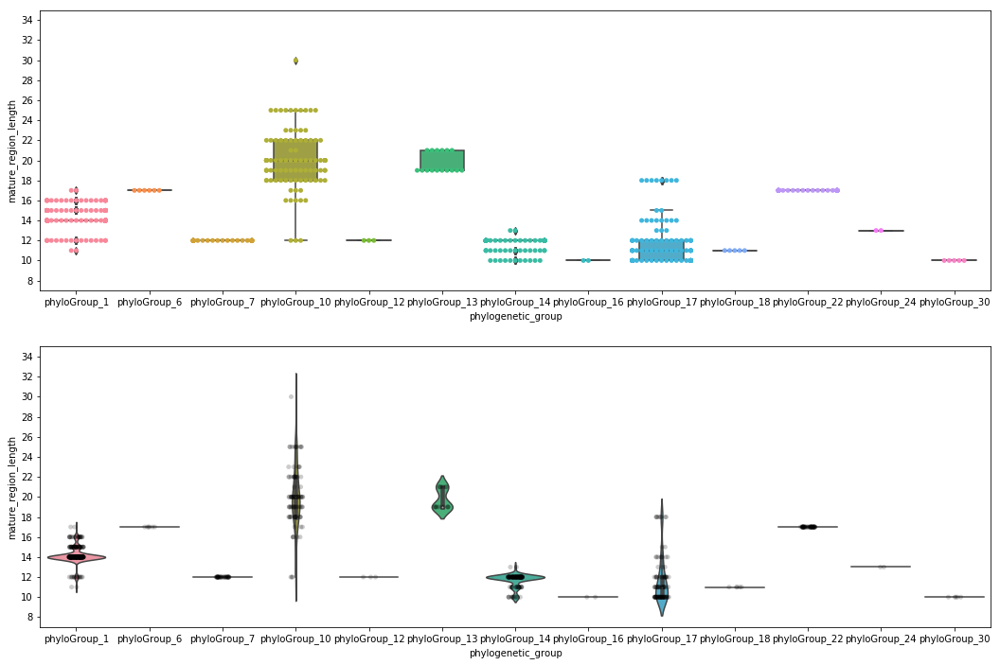

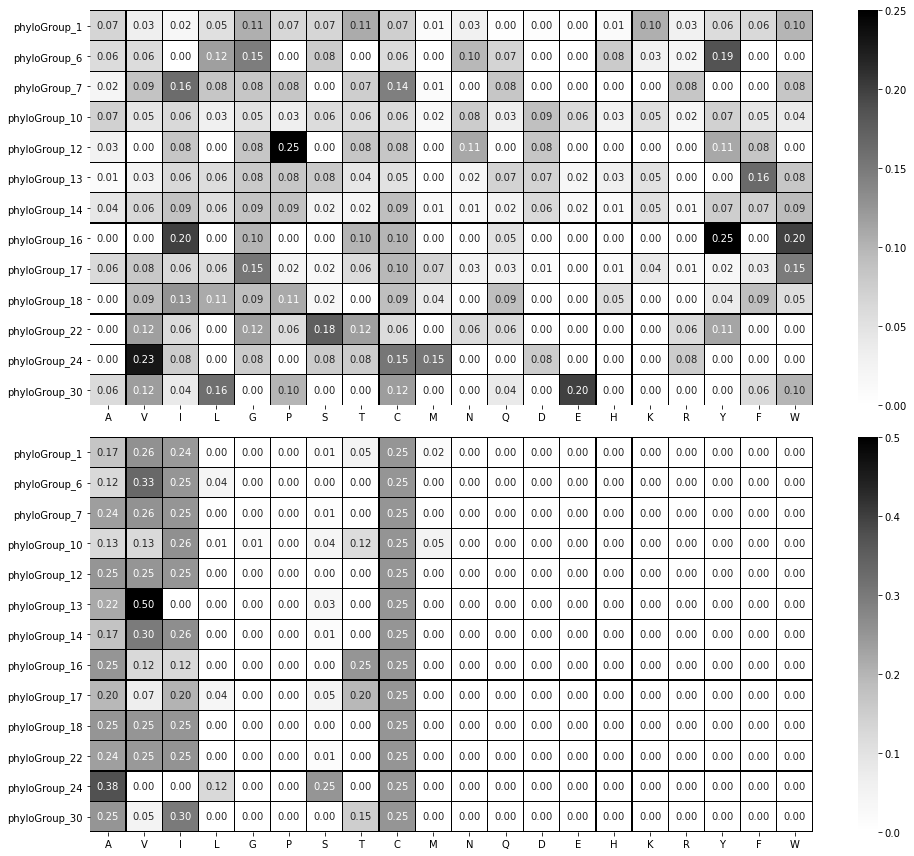

In [18]:
###Import pandas dataframe of mature candidates from geneious exported above.
candidate_score_dir = os.path.join(data_dir, "scores")
mature_candidates_geneious_frame = pd.read_csv(os.path.join(candidate_score_dir, "mature-candidates_geneious_scoring.csv"), sep="\t", index_col='index')
print("\t".join(["Analyzing curated mature candidates:", str(len(mature_candidates_geneious_frame))]))

###Add mature_region_length through function.
mature_candidates_geneious_frame['mature_region_length'] = mature_candidates_geneious_frame.apply(lambda row: mature_region_length(row), axis=1)
# print(mature_candidates_geneious_frame.iloc[0])
# os.sys.exit()

###Print mature region length min and max.
print("\t".join(["The min and max mature region lengths are:", str(mature_candidates_geneious_frame['mature_region_length'].min()), str(mature_candidates_geneious_frame['mature_region_length'].max())]))
print("\t".join(["Candidates with mature region shorter than 20aa:", str(len(mature_candidates_geneious_frame[mature_candidates_geneious_frame['mature_region_length'] <= 20]))]))

###Plotting length distribution of mature candidates
phylogenetic_group_label_order = mature_candidates_geneious_frame['phylogenetic_group'].unique().tolist()
phylogenetic_group_label_order.sort(key=natural_keys)

fig1, ax1 = plt.subplots(2, 1, figsize=(18,12))
sns.swarmplot(x="phylogenetic_group", y="mature_region_length", data=mature_candidates_geneious_frame, ax=ax1[0], size=5, order=phylogenetic_group_label_order)
sns.boxplot(x="phylogenetic_group", y="mature_region_length", data=mature_candidates_geneious_frame, ax=ax1[0], order=phylogenetic_group_label_order, width=0.6)
# sns.pointplot(x="phylogenetic_group", y="candidate_count", data=candidates_species_count, ax=ax,
#               estimator=mean, ci=None, join=False, markers='_', color='black', scale=2, order=phylogenetic_group_label_order)
# ax1[0].set_ylim(7,21);
# ax1[0].set_yticks(np.arange(8,22,step=2));
ax1[0].set_ylim(7,35);
ax1[0].set_yticks(np.arange(8,36,step=2));

sns.violinplot(x="phylogenetic_group", y="mature_region_length", data=mature_candidates_geneious_frame, ax=ax1[1], order=phylogenetic_group_label_order)
sns.stripplot(x="phylogenetic_group", y="mature_region_length", data=mature_candidates_geneious_frame, ax=ax1[1], order=phylogenetic_group_label_order, 
              alpha=0.2, color='black', linewidth=0, size=5)
# ax1[1].set_ylim(7,21);
# ax1[1].set_yticks(np.arange(8,22,step=2));
ax1[1].set_ylim(7,35);
ax1[1].set_yticks(np.arange(8,36,step=2));
#savefig(os.path.join(figure_dir, 'mature-candidates_length-dist_211212.pdf'), dpi=300, transparent=True)

###Intialize counters
amino_acid_list = ['A', 'V', 'I', 'L', 'G', 'P', 'S', 'T', 'C', 'M', 'N', 'Q', 'D', 'E', 'H', 'K', 'R', 'Y', 'F', 'W']
amino_acid_mature_total_counts = collections.Counter({'A': 0, 'V': 0, 'I': 0, 'L': 0, 'G': 0, 'P': 0, 
                                                      'S': 0, 'T': 0, 'C': 0, 'M': 0, 'N': 0, 'Q': 0, 
                                                      'D': 0, 'E': 0, 'H': 0, 'K': 0, 'R': 0, 
                                                      'Y': 0, 'F': 0, 'W': 0})
total_mature_length = 0
amino_acid_caax_total_counts = collections.Counter({'A': 0, 'V': 0, 'I': 0, 'L': 0, 'G': 0, 'P': 0, 
                                                    'S': 0, 'T': 0, 'C': 0, 'M': 0, 'N': 0, 'Q': 0, 
                                                    'D': 0, 'E': 0, 'H': 0, 'K': 0, 'R': 0, 
                                                    'Y': 0, 'F': 0, 'W': 0})
total_caax_length = 0
mature_amino_acid_phylogroup_dist = [[0 for i in range(len(amino_acid_list))] for j in range(len(phylogenetic_group_label_order))]
caax_amino_acid_phylogroup_dist = [[0 for i in range(len(amino_acid_list))] for j in range(len(phylogenetic_group_label_order))]
# test = amino_acid_total_counts + collections.Counter(mature_candidates_geneious_frame['mature'].iloc[0])
# print(test)

###Iterating through the mature_candidate_geneious dataframe.
for index,row in mature_candidates_geneious_frame.iterrows():
#     print(row)
#     print(row['mature'])
#     os.sys.exit()
    
    ##Building temp counter dictionary for mature regions.
    temp_mature_counter = collections.Counter(row['mature'])
    temp_caax_counter = collections.Counter(row['caax'])
    
    ###Adding to amino_acid_phylogroup_dist by amino-acid
    for key in temp_mature_counter:
        mature_amino_acid_phylogroup_dist[phylogenetic_group_label_order.index(row['phylogenetic_group'])][amino_acid_list.index(key)] += temp_mature_counter[key]
    for key in temp_caax_counter:
        caax_amino_acid_phylogroup_dist[phylogenetic_group_label_order.index(row['phylogenetic_group'])][amino_acid_list.index(key)] += temp_caax_counter[key]
    
    ###Adding to global counter.
    amino_acid_mature_total_counts = amino_acid_mature_total_counts + temp_mature_counter
    total_mature_length = total_mature_length + len(row['mature'])
    amino_acid_caax_total_counts = amino_acid_caax_total_counts + temp_caax_counter
    total_caax_length = total_caax_length + len(row['caax'])

###Confirm results of sums
# print(amino_acid_total_counts)
# print(total_mature_length)
# os.sys.exit()

###Converting to frequency of amino-acids from total counts by dividing by sum(mature_lengths)
amino_acid_freq_mature = {}
amino_acid_freq_caax = {}
test_count = 0
for key in amino_acid_mature_total_counts:
#     print("\t".join([key, str(amino_acid_total_counts[key])]))
#     os.sys.exit()
    #test_count = test_count + amino_acid_mature_total_counts[key]
    #print(test_count)
    amino_acid_freq_mature[key] = float(amino_acid_mature_total_counts[key])/total_mature_length
test_count = 0
for key in amino_acid_caax_total_counts:
    amino_acid_freq_caax[key] = float(amino_acid_caax_total_counts[key])/total_caax_length
    
###Output of amino-acid frequencies.
print("Amino-acid frequency in mature region are as follows:")
print(amino_acid_freq_mature)
# freq_total = 0
# for key in amino_acid_freq_mature.keys():
#     freq_total += amino_acid_freq_mature[key]
# print(freq_total)
print("\nAmino-acid frequency in caax motif are as follows:")
print(amino_acid_freq_caax)

for phylogroup_row in mature_amino_acid_phylogroup_dist:
#     print([float(x) for x in phylogroup_row]/sum(phylogroup_row))
#     print(mature_amino_acid_phylogroup_dist.index(phylogroup_row))
#     os.sys.exit()
    mature_amino_acid_phylogroup_dist[mature_amino_acid_phylogroup_dist.index(phylogroup_row)][:] = [float(x) for x in phylogroup_row]/sum(phylogroup_row)
for phylogroup_row in caax_amino_acid_phylogroup_dist:
    caax_amino_acid_phylogroup_dist[caax_amino_acid_phylogroup_dist.index(phylogroup_row)][:] = [float(x) for x in phylogroup_row]/sum(phylogroup_row)

# print("Amin-acid distribution of mature regions per phylogenetic group:")
# print(mature_amino_acid_phylogroup_dist)

fig2, ax2 = plt.subplots(2, 1, figsize=(14,12))
sns.heatmap(np.array(mature_amino_acid_phylogroup_dist), ax=ax2[0], annot=True, fmt="1.2f", cmap='Greys', vmin=0.00, vmax=0.25, 
            xticklabels=amino_acid_list, yticklabels=phylogenetic_group_label_order, linewidth=0.2, linecolor='black')
sns.heatmap(np.array(caax_amino_acid_phylogroup_dist), ax=ax2[1], annot=True, fmt="1.2f", cmap='Greys', vmin=0.00, vmax=0.50, 
            xticklabels=amino_acid_list, yticklabels=phylogenetic_group_label_order, linewidth=0.2, linecolor='black')
plt.tight_layout()
#savefig(os.path.join(figure_dir, 'candidates_aa-dist_211212.pdf'), dpi=300, transparent=True)

In [15]:
print("\t".join(["Number of species in curated candidates from multicopy candidates:", str(len(curated_candidates['species_name'].unique()))]))
print("\t".join(["Number of species in curated candidate mature regions:", str(len(mature_candidates_geneious_frame['species_name'].unique()))]))
#print(curated_candidates['species_name'].unique().tolist())
unique_species = [i for i in curated_candidates['species_name'].unique().tolist()+mature_candidates_geneious_frame['species_name'].unique().tolist() 
                  if i not in curated_candidates['species_name'].unique().tolist() 
                  or i not in mature_candidates_geneious_frame['species_name'].unique().tolist()]
print("\n".join(["Species present in only one of the lists"]+unique_species))

Number of species in curated candidates from multicopy candidates:	240
Number of species in curated candidate mature regions:	240
Species present in only one of the lists
candida_carpophila
yarsp2


## Evaluating number of candidates per caax-stop

Processed candidates:	alloascoidea_hylecoeti	445
Processed candidates:	ambrosiozyma_kashinagacola	279
Processed candidates:	ambrosiozyma_monospora	646
Processed candidates:	arxula_adeninivorans	218
Processed candidates:	ascoidea_asiatica	161
Processed candidates:	ascoidea_rubescens	246
Processed candidates:	ashbya_aceri	178
Processed candidates:	babjeviella_inositovora	256
Processed candidates:	brettanomyces_anomalus	312
Processed candidates:	candida_albicans	281
Processed candidates:	candida_apicola	196
Processed candidates:	candida_arabinofermentans	236
Processed candidates:	candida_auris	258
Processed candidates:	candida_boidinii_JCM9604	319
Processed candidates:	candida_carpophila	200
Processed candidates:	candida_dubliniensis	281
Processed candidates:	candida_glabrata	271
Processed candidates:	candida_homilentoma	220
Processed candidates:	candida_infanticola	152
Processed candidates:	candida_intermedia	302
Processed candidates:	candida_orthopsilosis	345
Processed candidates:	candi

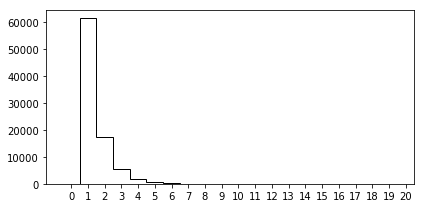

In [98]:
##Importing all unique candidates
#unique_candidates_dir = os.path.join(data_dir, "ORF-Locator", "phyloGroups_unique_Asn-CAAX")
unique_candidates_dir = os.path.join(data_dir, "ORF-Locator", "species_unique_Asn-CAAX")
unique_candidates_filelist = [f for f in os.listdir(unique_candidates_dir) if f.endswith(".fas.caax.asn.unique")]
unique_candidates_filelist.sort(key=natural_keys)
#print("\n".join(unique_candidates_filelist))

unique_candidate_count = []
total_unique_candidates = 0
for f in unique_candidates_filelist:
    input_file_handle = open(os.path.join(unique_candidates_dir, f), "r")
    unique_candidates_records = list(SeqIO.parse(input_file_handle, "fasta"))
    input_file_handle.close()
    
    pheromone_phylogroup = f.split(".fas.caax.asn.unique")[0]
#     print(pheromone_phylogroup)
#     print(mature_candidates_geneious_records[0])
#     os.sys.exit()
    
    print("\t".join(["Processed candidates:", pheromone_phylogroup, str(len(unique_candidates_records))]))
    total_unique_candidates += len(unique_candidates_records)
    ##Parsing records in each file.
    for record in unique_candidates_records:
        ###Extracting the candidate number per caax-stop of the unique candidates, which should be the max number that fits our filters.
#         print(int(record.id.split("|/|")[1].split("||")[1].split("][")[1]))
#         os.sys.exit()
        unique_candidate_count.append(int(record.id.split("|/|")[1].split("||")[1].split("][")[1]))
    
print("\t".join(["Total number of unique candidates:", str(total_unique_candidates), str(len(unique_candidate_count))]))
# print(max(unique_candidate_count))
# print(range(max(unique_candidate_count)+2))
# os.sys.exit()

candidate_count_bins = range(max(unique_candidate_count)+2)
fig3, ax3 = plt.subplots(1, 1, figsize=(6,3))
plt.hist(unique_candidate_count, bins=candidate_count_bins, align='left', log=False, color='black', histtype='step')
ax3.set_xticks(candidate_count_bins);
plt.tight_layout()
#savefig(os.path.join(figure_dir, 'species-candidates_candidate-count-per-caax_211121.pdf'), dpi=300, transparent=True)

In [20]:
candidate_score_dir = os.path.join(data_dir, "scores")
final_candidates_scoring_frame = pd.read_csv(os.path.join(candidate_score_dir, "candidates-super-significant_final-scoring_expansion.csv"), sep="\t", index_col='index')
curated_candidates = final_candidates_scoring_frame[final_candidates_scoring_frame['curated_geneious_candidates'] == 1].copy()
print(len(curated_candidates[curated_candidates['phylogenetic_group'] == "phyloGroup_10"]['species_name'].unique()))

#curated_candidates.head()
#curated_candidates[curated_candidates['phylogenetic_group'] == "phyloGroup_10"].head()

41


In [87]:
##The known pheromone of candida_glabrata is missing in the curated candidates, and in fact in the list of those with multiple candidates. 
##I don't know why, but I presumably there is enough variation in the mature region to not be counted in the >85% identity cutoff.
final_candidates_scoring_frame[(final_candidates_scoring_frame['species_name'] == 'candida_glabrata') & (final_candidates_scoring_frame['stop_pos'] == 202386)]
#final_candidates_scoring_frame[final_candidates_scoring_frame[final_candidates_scoring_frame['species_name'] == 'candida_glabrata']['aa_seq'] == "MQPTIEATQKDNTQEKRDNYIVKGFFWSPDCVIA*"]

,species_name,phylogenetic_group,chromosome_id,cys_pos,stop_pos,aa_seq,dna_seq,copynumber,regulation_phylogenetic_group,#all_motif_sites,...,#pheroAct_motif_2_sites,pheroAct_motif_3_evalue,#pheroAct_motif_3_sites,aSpec_motif_1_evalue,#aSpec_motif_1_sites,aSpec_motif_2_evalue,#aSpec_motif_2_sites,aSpec_motif_3_evalue,#aSpec_motif_3_sites,curated_geneious_candidates
index,,,,,,,,,,,,,,,,,,,,,
41056,candida_glabrata,phyloGroup_14,CR380949,202398,202386,MQPTIEATQKDNTQEKRDNYIVKGFFWSPDCVIA*,ATGCAACCAACTATTGAAGCCACTCAAAAGGATAACACTCAAGAAA...,0,phyloGroup_27,4.0,...,0.0,7.300000e-18,0.0,8.600000e-62,2.0,9.100000e-49,2.0,2.200000e-31,1.0,0.0


In [47]:
final_candidates_scoring_frame[(final_candidates_scoring_frame['species_name'] == 'yHMPu5000035689_candida_mycetangii_160613') & final_candidates_scoring_frame['aa_seq'].str.contains('CTIA')]['aa_seq'].values

array(['MGAYLRTSSLSAWYHFPCNPTTTICTTMQPTLASSAVSTSDDENRDHSSVIAHTWDGVWYPCTIA*',
       'MQPSFASSAVPQDMSDENSDNVGIVIRGNVWYACTIA*',
       'MGDPVSDVCDLLAFSGVVIFCCKRFMVFAVLLCIALGSLVSSIVSSPIVSSSSGACFKMEPKTLVCSIVTSTPLFCTIAPNGLVCSIVTSIVVSCSGV*'],
      dtype=object)

In [22]:
curated_candidates[curated_candidates['species_name'] == "candida_albicans"]

,species_name,phylogenetic_group,chromosome_id,cys_pos,stop_pos,aa_seq,dna_seq,copynumber,regulation_phylogenetic_group,#all_motif_sites,#pheroAct_motif_sites,#aSpec_motif_sites,curated_geneious_candidates
index,,,,,,,,,,,,,
9,candida_albicans,phyloGroup_1,Ca22chr2A_C_albicans_SC5314,1663687,1663675,MAAQQQSKKTGSGQTKDKDAAAKNNAVRSVLTGNCCSTCSVM*,ATGGCTGCTCAACAACAATCTAAAAAAACTGGATCTGGTCAAACCA...,1,phyloGroup_2,4.0,2.0,9.0,1.0


In [38]:
##Testing presence of candidates in 
candidate_score_dir = os.path.join(data_dir, "scores")
final_candidates_scoring_frame = pd.read_csv(os.path.join(candidate_score_dir, "candidates-super-significant_final-scoring_expansion.csv"), sep="\t", index_col='index')
curated_candidates = final_candidates_scoring_frame[final_candidates_scoring_frame['curated_geneious_candidates'] == 1].copy()

#curated_candidates[curated_candidates['species_name'] == "saccharomyces_cerevisiae"]
curated_candidates[curated_candidates['species_name'] == "lachancea_waltii"]

,species_name,phylogenetic_group,chromosome_id,cys_pos,stop_pos,aa_seq,dna_seq,copynumber,regulation_phylogenetic_group,#all_motif_sites,...,#pheroAct_motif_2_sites,pheroAct_motif_3_evalue,#pheroAct_motif_3_sites,aSpec_motif_1_evalue,#aSpec_motif_1_sites,aSpec_motif_2_evalue,#aSpec_motif_2_sites,aSpec_motif_3_evalue,#aSpec_motif_3_sites,curated_geneious_candidates
index,,,,,,,,,,,,,,,,,,,,,
45517,lachancea_waltii,phyloGroup_14,AADM01000273.1,25650,25638,MASCASIEIWFLVDSQNHQPTKQDFNTKYYAMQPIAQATQNDSSDN...,ATGGCAAGCTGTGCTTCAATTGAAATCTGGTTTCTGGTTGACTCTC...,59,phyloGroup_30,1.0,...,0.0,4500.0,0.0,8.900000e-08,0.0,0.000005,0.0,0.000026,0.0,1.0


In [38]:
copynumber_candidates.head()

,species_name,phylogenetic_group,chromosome_id,cys_pos,stop_pos,aa_seq,dna_seq,copynumber,regulation_phylogenetic_group,#all_motif_sites,#pheroAct_motif_sites,#aSpec_motif_sites,curated_geneious_candidates
index,,,,,,,,,,,,,
0,candida_albicans,phyloGroup_1,Ca22chr1A_C_albicans_SC5314,2404344,2404332,MREAVKNNGVLKKKDARQALKIDVNKASKIYEFFVHMGWCSQG*,ATGAGAGAAGCAGTTAAAAATAACGGTGTATTGAAAAAGAAAGACG...,64,phyloGroup_2,1.0,0.0,5.0,0.0
1,candida_albicans,phyloGroup_1,Ca22chr1A_C_albicans_SC5314,3102278,3102266,MDSAQPKVLVKETNNFTRRCLGTCGNAVAKLANKNSISLFTGDNPF...,ATGGATTCAGCACAGCCTAAAGTTTTGGTCAAGGAAACAAACAACT...,12,phyloGroup_2,2.0,2.0,2.0,0.0
2,candida_albicans,phyloGroup_1,Ca22chr2A_C_albicans_SC5314,1075275,1075287,MYPNCGLLLKSLREIKIHLCKEVAITIPAGSTFSAKVMYSSFFKGI...,ATGTACCCTAATTGTGGTTTACTTTTGAAATCCCTAAGAGAAATTA...,6,phyloGroup_2,1.0,0.0,0.0,0.0
3,candida_albicans,phyloGroup_1,Ca22chr6A_C_albicans_SC5314,774464,774452,MNPTEICFLSECKVENCLNN*,ATGAACCCCACAGAAATTTGTTTTCTGTCTGAATGTAAAGTTGAAA...,2,phyloGroup_2,5.0,2.0,3.0,0.0
4,candida_albicans,phyloGroup_1,Ca22chrRA_C_albicans_SC5314,1946181,1946193,MASLSTIKVQSACSKVVWVVNTVLYGSTTEVDTCGAG*,ATGGCTTCATTATCAACCATAAAAGTACAATCGGCGTGTTCCAAAG...,2,phyloGroup_2,2.0,1.0,6.0,0.0


In [52]:
##Estimating the pairwise score of candida_glabrata pheromone against the saccharomyces_cerevisiae pheromones.
##As expected the %identity as evaluated by my method is < 85 between scerevisiae and cglabrata. The paired score is at most 73. Should I repeat the copy number evaluation with > 70 id.
candida_glabrata_pher = 'MQPTIEATQKDNTQEKRDNYIVKGFFWSPDCVIA*'
saccharomyces_cerevisiae_pher1 = 'MQPITTASTQATQKDKSSEKKDNYIIKGLFWDPACVIA*'
saccharomyces_cerevisiae_pher2 = 'MQPSTATAAPKEKTSSEKKDNYIIKGVFWDPACVIA*'

print("\t".join(["Paired scores are:", 
                 str(100*pairwise2.align.globalxx(candida_glabrata_pher[max(candida_glabrata_pher[:-10].rfind("N")-2,0):], saccharomyces_cerevisiae_pher1[max(saccharomyces_cerevisiae_pher1[:-10].rfind("N")-2,0):], score_only=True)/max(len(candida_glabrata_pher[max(candida_glabrata_pher[:-10].rfind("N")-2,0):]), len(saccharomyces_cerevisiae_pher1[max(saccharomyces_cerevisiae_pher1[:-10].rfind("N")-2,0):]))), 
                 str(100*pairwise2.align.globalxx(candida_glabrata_pher[max(candida_glabrata_pher[:-10].rfind("N")-2,0):], saccharomyces_cerevisiae_pher2[max(saccharomyces_cerevisiae_pher1[:-10].rfind("N")-2,0):], score_only=True)/max(len(candida_glabrata_pher[max(candida_glabrata_pher[:-10].rfind("N")-2,0):]), len(saccharomyces_cerevisiae_pher2[max(saccharomyces_cerevisiae_pher2[:-10].rfind("N")-2,0):])))
                ]))

Paired scores are:	73.6842105263	68.4210526316


In [16]:
##I am going to write a function to start from the copy number candidate list of 11065 candidates with at least 1 copy in any pheromone-phyloGroup and report a representative candidate of the copies.
##The goal being to identify the number of "unique copynumber-candidates" per phylogroup.
candidate_score_dir = os.path.join(data_dir, "scores")
final_candidates_scoring_frame = pd.read_csv(os.path.join(candidate_score_dir, "candidates_final-scoring.csv"), sep="\t", index_col='index')
print(len(final_candidates_scoring_frame[final_candidates_scoring_frame['copynumber'] >= 1]))




11065


In [188]:
print(final_candidates_scoring_frame[final_candidates_scoring_frame['phylogenetic_group'] == "phyloGroup_6"]['species_name'].unique())

['komagataella_pastoris' 'yHMPu5000026274_komagataella_populi_160519'
 'yHMPu5000034939_komagataella_pseudopastoris_160519']


In [39]:
final_candidates_scoring_frame.head()

,species_name,phylogenetic_group,chromosome_id,cys_pos,stop_pos,aa_seq,dna_seq,copynumber,regulation_phylogenetic_group,#all_motif_sites,#pheroAct_motif_sites,#aSpec_motif_sites,curated_geneious_candidates
index,,,,,,,,,,,,,
0,candida_albicans,phyloGroup_1,Ca22chr1A_C_albicans_SC5314,2404344,2404332,MREAVKNNGVLKKKDARQALKIDVNKASKIYEFFVHMGWCSQG*,ATGAGAGAAGCAGTTAAAAATAACGGTGTATTGAAAAAGAAAGACG...,64,phyloGroup_2,1.0,0.0,5.0,0.0
1,candida_albicans,phyloGroup_1,Ca22chr1A_C_albicans_SC5314,3102278,3102266,MDSAQPKVLVKETNNFTRRCLGTCGNAVAKLANKNSISLFTGDNPF...,ATGGATTCAGCACAGCCTAAAGTTTTGGTCAAGGAAACAAACAACT...,12,phyloGroup_2,2.0,2.0,2.0,0.0
2,candida_albicans,phyloGroup_1,Ca22chr2A_C_albicans_SC5314,1075275,1075287,MYPNCGLLLKSLREIKIHLCKEVAITIPAGSTFSAKVMYSSFFKGI...,ATGTACCCTAATTGTGGTTTACTTTTGAAATCCCTAAGAGAAATTA...,6,phyloGroup_2,1.0,0.0,0.0,0.0
3,candida_albicans,phyloGroup_1,Ca22chr6A_C_albicans_SC5314,774464,774452,MNPTEICFLSECKVENCLNN*,ATGAACCCCACAGAAATTTGTTTTCTGTCTGAATGTAAAGTTGAAA...,2,phyloGroup_2,5.0,2.0,3.0,0.0
4,candida_albicans,phyloGroup_1,Ca22chrRA_C_albicans_SC5314,1946181,1946193,MASLSTIKVQSACSKVVWVVNTVLYGSTTEVDTCGAG*,ATGGCTTCATTATCAACCATAAAAGTACAATCGGCGTGTTCCAAAG...,2,phyloGroup_2,2.0,1.0,6.0,0.0


In [132]:
##Function to read in FIMO output and plot outputs.
fimo_dir = os.path.join(data_dir, "fimo")
fimo_result_file = os.path.join(fimo_dir, "fimo.txt")
fimo_result = pd.read_csv(fimo_result_file, sep="\t")

print(list(fimo_result.columns))

print(len(fimo_result[fimo_result['#pattern name'] == 1]))
fimo_result['species'] = fimo_result.apply(lambda row: insert_species_name(row), axis=1)
print(fimo_result['species'].unique())

['#pattern name', 'sequence name', 'start', 'stop', 'strand', 'score', 'p-value', 'q-value', 'matched sequence']
3886
['nakaseomyces_castellii' 'candida_glabrata' 'nakaseomyces_bracarensis'
 'nakaseomyces_delphensis' 'saccharomyces_uvarum'
 'saccharomyces_cerevisiae' 'yHAB153_kazachstania_rosinii_160519'
 'yHAB160_kazachstania_kunashirensis_160519' 'kazachstania_africana'
 'yHAB148_kazachstania_intestinalis_160519'
 'yHAB147_kazachstania_taianensis_160519'
 'yHAB166_kazachstania_yakushimaensis_160519'
 'yHAB159_kazachstania_solicola_160519'
 'yHAB133_kazachstania_unispora_160519'
 'yHAB143_kazachstania_siamensis_160519' 'naumovozyma_dairenensis'
 'saccharomyces_arboricola' 'yHAB136_kazachstania_bromeliacearum_160519'
 'yHAB164_kazachstania_aerobia_160519' 'nakaseomyces_bacillisporus'
 'saccharomyces_eubayanus' 'saccharomyces_kudriavzevii'
 'saccharomyces_mikatae' 'saccharomyces_paradoxus'
 'yHAB155_kazachstania_spencerorum_160519'
 'yHAB134_kazachstania_turicensis_160519'
 'yHAB158_kaz

### Binaries invoked in this notebook.

In [15]:
cmd = 'hmmbuild -h'
!{cmd}

# hmmbuild :: profile HMM construction from multiple sequence alignments
# HMMER 3.3 (Nov 2019); http://hmmer.org/
# Copyright (C) 2019 Howard Hughes Medical Institute.
# Freely distributed under the BSD open source license.
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Usage: hmmbuild [-options] <hmmfile_out> <msafile>

Basic options:
  -h     : show brief help on version and usage
  -n <s> : name the HMM <s>
  -o <f> : direct summary output to file <f>, not stdout
  -O <f> : resave annotated, possibly modified MSA to file <f>

Options for selecting alphabet rather than guessing it:
  --amino : input alignment is protein sequence data
  --dna   : input alignment is DNA sequence data
  --rna   : input alignment is RNA sequence data

Alternative model construction strategies:
  --fast           : assign cols w/ >= symfrac residues as consensus  [default]
  --hand           : manual construction (requires reference annotation)
  --symfrac <x>    : sets sym fra

In [45]:
cmd = 'hmmsearch -h'
!{cmd}

# hmmsearch :: search profile(s) against a sequence database
# HMMER 3.3 (Nov 2019); http://hmmer.org/
# Copyright (C) 2019 Howard Hughes Medical Institute.
# Freely distributed under the BSD open source license.
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
Usage: hmmsearch [options] <hmmfile> <seqdb>

Basic options:
  -h : show brief help on version and usage

Options directing output:
  -o <f>           : direct output to file <f>, not stdout
  -A <f>           : save multiple alignment of all hits to file <f>
  --tblout <f>     : save parseable table of per-sequence hits to file <f>
  --domtblout <f>  : save parseable table of per-domain hits to file <f>
  --pfamtblout <f> : save table of hits and domains to file, in Pfam format <f>
  --acc            : prefer accessions over names in output
  --noali          : don't output alignments, so output is smaller
  --notextw        : unlimit ASCII text output line width
  --textw <n>      : set max width of AS

In [147]:
cmd = "makeblastdb -help"
!{cmd}

USAGE
  makeblastdb [-h] [-help] [-in input_file] [-input_type type]
    -dbtype molecule_type [-title database_title] [-parse_seqids]
    [-hash_index] [-mask_data mask_data_files] [-mask_id mask_algo_ids]
    [-mask_desc mask_algo_descriptions] [-gi_mask]
    [-gi_mask_name gi_based_mask_names] [-out database_name]
    [-blastdb_version version] [-max_file_sz number_of_bytes]
    [-logfile File_Name] [-taxid TaxID] [-taxid_map TaxIDMapFile] [-version]

DESCRIPTION
   Application to create BLAST databases, version 2.10.0+

REQUIRED ARGUMENTS
 -dbtype <String, `nucl', `prot'>
   Molecule type of target db

OPTIONAL ARGUMENTS
 -h
   Print USAGE and DESCRIPTION;  ignore all other parameters
 -help
   Print USAGE, DESCRIPTION and ARGUMENTS; ignore all other parameters
 -version
   Print version number;  ignore other arguments

 *** Input options
 -in <File_In>
   Input file/database name
   Default = `-'
 -input_type <String, `asn1_bin', `asn1_txt', `blastdb', `fasta'>
   Type of the data

In [155]:
cmd = "tblastn -help"
!{cmd}

USAGE
  tblastn [-h] [-help] [-import_search_strategy filename]
    [-export_search_strategy filename] [-task task_name] [-db database_name]
    [-dbsize num_letters] [-gilist filename] [-seqidlist filename]
    [-negative_gilist filename] [-negative_seqidlist filename]
    [-taxids taxids] [-negative_taxids taxids] [-taxidlist filename]
    [-negative_taxidlist filename] [-entrez_query entrez_query]
    [-db_soft_mask filtering_algorithm] [-db_hard_mask filtering_algorithm]
    [-subject subject_input_file] [-subject_loc range] [-query input_file]
    [-out output_file] [-evalue evalue] [-word_size int_value]
    [-gapopen open_penalty] [-gapextend extend_penalty]
    [-qcov_hsp_perc float_value] [-max_hsps int_value]
    [-xdrop_ungap float_value] [-xdrop_gap float_value]
    [-xdrop_gap_final float_value] [-searchsp int_value]
    [-sum_stats bool_value] [-db_gencode int_value] [-ungapped]
    [-max_intron_length length] [-seg SEG_options]
    [-soft_masking soft_masking] [-matrix m

In [7]:
cmd = "meme -h"
!{cmd}

 Usage:	meme	<dataset> [optional arguments]

	<dataset> 		file containing sequences in FASTA format
	[-h]			print this message
	[-o <output dir>]	name of directory for output files
				will not replace existing directory
	[-oc <output dir>]	name of directory for output files
				will replace existing directory
	[-text]			output in text format (default is HTML)
	[-objfun classic|de|se|cd|ce]	objective function (default: classic)
	[-test mhg|mbn|mrs]	statistical test type (default: mhg)
	[-use_llr]		use LLR in search for starts in Classic mode
	[-neg <negdataset>]	file containing control sequences
	[-shuf <kmer>]		preserve frequencies of k-mers of size <kmer> 
				when shuffling (default: 2)
	[-hsfrac <hsfrac>]	fraction of primary sequences in holdout set 
				(default: 0.5)
	[-cefrac <cefrac>]	fraction sequence length for CE region 
				(default: 0.25)
	[-searchsize <ssize>]	maximum portion of primary dataset to use
				for motif search (in characters)
	[-maxsize <maxsize>]	maximum data

In [87]:
cmd = "fimo"
!{cmd}

Usage: fimo [options] <motif file> <sequence file>

   Options:
     --alpha <double> (default 1.0)
     --bfile <background file> (DNA and protein use NRDB by default)
     --max-stored-scores <int> (default=100000)
     --max-strand
     --motif <id> (default=all)
     --motif-pseudo <float> (default=0.1)
     --no-qvalue
     --norc
     --o <output dir> (default=fimo_out)
     --oc <output dir> (default=fimo_out)
     --parse-genomic-coord
     --psp <PSP filename> (default none)
     --prior-dist <PSP distribution filename> (default none)
     --qv-thresh
     --skip-matched-sequence
     --text
     --thresh <float> (default = 1e-4)
     --verbosity [1|2|3|4] (default 2)
     --version (print the version and exit)

   When scanning with a single motif use '-' for <sequence file> to
     read the database from standard input.
   Use '--bfile --motif--' to read the background from the motif file.
   Use '--bfile --uniform--' to use a uniform background.



In [90]:
cmd = "matrix2meme -h"
!{cmd}

Usage:
    matrix2meme [options]

     Options: 
      -dna                          use DNA IUPAC alphabet
      -rna                          use RNA IUPAC alphabet
      -protein                      use protein IUPAC alphabet
      -alph <alphabet file>         Alphabet definition; default: DNA
      -orien auto|col|row           The matrix orientation; default: auto
      -numseqs <numseqs>            assume frequencies based on this many 
                                    sequences when probabilty matrix is used;
                                    default: 20
      -bg <background file>         file with background frequencies of letters; 
                                    default: uniform background
      -pseudo <total pseudocounts>  add <total pseudocounts> times letter 
                                    background to each frequency; default: 0
      -logodds                      output the log-odds (PSSM) and frequency 
                                    (PSPM) motifs

### Testing various snippets

In [44]:
### I have tested the function of subprocess.call and it seems clear that the python block doesn't complete until the command line code gives an exit code.
### This is nice in that I can use this to continute on with my code and only keep in mind that all command line tools 
timer_test = subprocess.call(["sleep", "15"])

In [47]:
print(os.path.join(data_dir, "hmmsearch_raw"))

../hmmsearch_raw


In [75]:
### Found a code fragment that wrote a class that iterates over terminal commands that contain pipes. This clearly work.
command = '|'.join([
        "ps aux",
        "grep python",
        ])
        
pipeline = Pipeline(command)
if not pipeline.run():
    print "ERROR: Pipeline failed"
else:
    print pipeline.output

ssrikant 25523  0.0  0.4 606212 67772 tty3     Sl   Apr15   1:28 /home/ssrikant/anaconda3/bin/python3.7 /home/ssrikant/anaconda3/bin/jupyter-lab
ssrikant 25532  0.0  0.1 516412 32896 ?        Ssl  Apr15   0:01 /home/ssrikant/anaconda3/envs/py27/bin/python -m ipykernel_launcher -f /home/ssrikant/.local/share/jupyter/runtime/kernel-e9b7827a-48de-42f8-95d4-397a2450eccf.json
ssrikant 25536  0.0  0.6 824352 115008 ?       Rsl  Apr15   0:14 /home/ssrikant/anaconda3/envs/py27/bin/python -m ipykernel_launcher -f /home/ssrikant/.local/share/jupyter/runtime/kernel-5398f1ca-2704-42ea-9790-e173da77c8b6.json



In [112]:
ps = subprocess.Popen(('ps', 'aux'), stdout=subprocess.PIPE)
output = subprocess.Popen(('grep', 'python'), stdin=ps.stdout, stdout=subprocess.PIPE)
stdout = output.communicate()
print(stdout)
#ps.wait()

('ssrikant 25523  0.0  0.4 606212 67744 tty3     Sl   Apr15   1:32 /home/ssrikant/anaconda3/bin/python3.7 /home/ssrikant/anaconda3/bin/jupyter-lab\nssrikant 25532  0.0  0.1 516412 32800 ?        Ssl  Apr15   0:01 /home/ssrikant/anaconda3/envs/py27/bin/python -m ipykernel_launcher -f /home/ssrikant/.local/share/jupyter/runtime/kernel-e9b7827a-48de-42f8-95d4-397a2450eccf.json\nssrikant 25536  0.0  0.7 825576 116252 ?       Rsl  Apr15   0:18 /home/ssrikant/anaconda3/envs/py27/bin/python -m ipykernel_launcher -f /home/ssrikant/.local/share/jupyter/runtime/kernel-5398f1ca-2704-42ea-9790-e173da77c8b6.json\nssrikant 27163  0.0  0.0 825576   196 ?        R    21:30   0:00 /home/ssrikant/anaconda3/envs/py27/bin/python -m ipykernel_launcher -f /home/ssrikant/.local/share/jupyter/runtime/kernel-5398f1ca-2704-42ea-9790-e173da77c8b6.json\n', None)


In [132]:
##Something seems to be wrong here in the way I chained the subprocess.Popen commands by piping stout into stdin. This may be a problem in my misunderstanding how the shell handles pipes.
##Pulling top-hits of hmmsearch for each hmmprofile and combining the hits by genome.
###First need to index all the protein collections
for species_prot in proteinFileList:
    eslsfetch_index_cmd = subprocess.call(["esl-sfetch", "--index", os.path.join(protein_dir, species_prot)])
    
    if not(os.path.isdir(os.path.join(data_dir, "hmmsearch_best"))):
        os.mkdir(os.path.join(data_dir, "hmmsearch_best"))
    output_fasta_file = os.path.join(data_dir, species_prot.split(".max.pep")[0]+"_hmmsearch.fasta")
    input_prot_database = os.path.join(protein_dir, species_prot)
    
    for index, record in hmm_dict.iterrows():
        hmmsearch_output_tblout = os.path.join(data_dir, "hmmsearch_raw", str(record['GeneName'])+"_0_"+species_prot.split(".max.pep")[0]+"_hmmsearch.tbl")
        temp_output_file = os.path.join(data_dir, "hmmsearch_best", "temp.fasta")
        #temp = "grep -v \"^#\" "+hmmsearch_output_tblout+" | awk '{print $1}' | esl-sfetch"+" -f "+input_prot_database+" - > "+temp_output_file
        #eslsfetch_cmd = subprocess.call([temp])
                
        command = '|'.join([
            "grep -v \"^#\" "+hmmsearch_output_tblout,
            "awk '{print $1}'",
            "esl-sfetch -f "+input_prot_database+" - > "+temp_output_file
        ])
        
        grep_cmd = subprocess.Popen(["grep", "-v", "^#::", hmmsearch_output_tblout.replace("|", "\|")], stdout=subprocess.PIPE)
        awk_cmd = subprocess.Popen(["awk", "'{print $1}'"], stdin=grep_cmd.stdout, stdout=subprocess.PIPE)
        #grep_cmd.wait()
        eslsfetch_cmd = subprocess.Popen(["esl-sfetch", "-f", input_prot_database, "- >", temp_output_file], stdin=awk_cmd.stdout, stdout=subprocess.PIPE, stderr=subprocess.PIPE)
        #eslsfetch_cmd.wait()
        stdout, stderr = eslsfetch_cmd.communicate()
        
        print(stdout)
        sys.exit()

Usage: esl-sfetch [options] <sqfile> <name>        (one seq named <name>)
Usage: esl-sfetch [options] -f <sqfile> <namefile> (all seqs in <namefile>)
Usage: esl-sfetch [options] --index <sqfile>       (index <sqfile>)

To see more help on available options, do esl-sfetch -h




SystemExit: 

In [209]:
###reverse_complement() both checks complement and reverses orientation of the sequence.
print(str(Seq("TAGC").reverse_complement()))

GCTA


In [219]:
tblastn_results[tblastn_results['qseqid'] == "FUS3|/|candida_albicans|/|C4_06480C_B"]

,qseqid,sseqid,pident,length,mismatch,gapopen,qstart,qend,sstart,send,evalue,bitscore
18,FUS3|/|candida_albicans|/|C4_06480C_B,candida_albicans|/|Ca22chr4A_C_albicans_SC5314,99.458,369,2,0,55,423,1438785,1437679,0.000000e+00,677.0
19,FUS3|/|candida_albicans|/|C4_06480C_B,candida_albicans|/|Ca22chr4A_C_albicans_SC5314,28.862,246,142,8,66,287,1072832,1072122,5.020000e-19,89.0
20,FUS3|/|candida_albicans|/|C4_06480C_B,candida_albicans|/|Ca22chr4A_C_albicans_SC5314,24.202,376,177,16,71,396,953639,952686,1.410000e-12,68.9
21,FUS3|/|candida_albicans|/|C4_06480C_B,candida_albicans|/|Ca22chr4A_C_albicans_SC5314,22.481,258,128,5,166,387,957663,956998,1.780000e-09,58.9
22,FUS3|/|candida_albicans|/|C4_06480C_B,candida_albicans|/|Ca22chr4A_C_albicans_SC5314,34.146,41,27,0,163,203,655204,655082,7.300000e-02,34.3
23,FUS3|/|candida_albicans|/|C4_06480C_B,candida_albicans|/|Ca22chrRA_C_albicans_SC5314,58.713,373,142,4,54,419,1244549,1245652,1.010000e-128,408.0
24,FUS3|/|candida_albicans|/|C4_06480C_B,candida_albicans|/|Ca22chrRA_C_albicans_SC5314,49.211,380,147,10,65,420,32339,31266,2.410000e-95,312.0
25,FUS3|/|candida_albicans|/|C4_06480C_B,candida_albicans|/|Ca22chrRA_C_albicans_SC5314,36.859,312,165,8,71,376,1293475,1294332,2.310000e-48,176.0
26,FUS3|/|candida_albicans|/|C4_06480C_B,candida_albicans|/|Ca22chrRA_C_albicans_SC5314,27.190,331,186,9,63,376,2257323,2258201,2.630000e-29,120.0
27,FUS3|/|candida_albicans|/|C4_06480C_B,candida_albicans|/|Ca22chrRA_C_albicans_SC5314,33.136,169,88,3,146,293,739682,739188,4.200000e-25,107.0


In [237]:
with open(os.path.join(data_dir, "seqfiles", "genome_list.txt"), 'r') as f:
    file_list = f.read().splitlines()
print("\n".join(file_list))

candida_albicans.fas
saccharomyces_cerevisiae.fas
yarrowia_lipolytica.fas


In [2]:
print("testing//".rstrip("/"))

testing


ValueError: left cannot be >= right

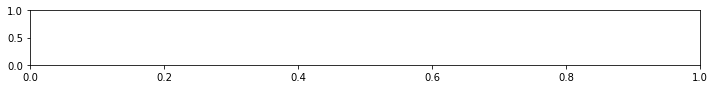

In [14]:
##Plotting matplotlib named colors (https://matplotlib.org/stable/gallery/color/named_colors.html)
from matplotlib.patches import Rectangle
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors


def plot_colortable(colors, title, sort_colors=True, emptycols=0):

    cell_width = 212
    cell_height = 22
    swatch_width = 48
    margin = 12
    topmargin = 40

    # Sort colors by hue, saturation, value and name.
    if sort_colors is True:
        by_hsv = sorted((tuple(mcolors.rgb_to_hsv(mcolors.to_rgb(color))),
                         name)
                        for name, color in colors.items())
        names = [name for hsv, name in by_hsv]
    else:
        names = list(colors)

    n = len(names)
    ncols = 4 - emptycols
    nrows = n // ncols + int(n % ncols > 0)

    width = cell_width * 4 + 2 * margin
    height = cell_height * nrows + margin + topmargin
    dpi = 72

    fig, ax = plt.subplots(figsize=(width / dpi, height / dpi), dpi=dpi)
    fig.subplots_adjust(margin/width, margin/height,
                        (width-margin)/width, (height-topmargin)/height)
    ax.set_xlim(0, cell_width * 4)
    ax.set_ylim(cell_height * (nrows-0.5), -cell_height/2.)
    ax.yaxis.set_visible(False)
    ax.xaxis.set_visible(False)
    ax.set_axis_off()
    ax.set_title(title, fontsize=24, loc="left", pad=10)

    for i, name in enumerate(names):
        row = i % nrows
        col = i // nrows
        y = row * cell_height

        swatch_start_x = cell_width * col
        text_pos_x = cell_width * col + swatch_width + 7

        ax.text(text_pos_x, y, name, fontsize=14,
                horizontalalignment='left',
                verticalalignment='center')

        ax.add_patch(
            Rectangle(xy=(swatch_start_x, y-9), width=swatch_width,
                      height=18, facecolor=colors[name], edgecolor='0.7')
        )

    return fig

plot_colortable(mcolors.BASE_COLORS, "Base Colors",
                sort_colors=False, emptycols=1)
plot_colortable(mcolors.TABLEAU_COLORS, "Tableau Palette",
                sort_colors=False, emptycols=2)

plot_colortable(mcolors.CSS4_COLORS, "CSS Colors")

# Optionally plot the XKCD colors (Caution: will produce large figure)
#xkcd_fig = plot_colortable(mcolors.XKCD_COLORS, "XKCD Colors")
#xkcd_fig.savefig("XKCD_Colors.png")

plt.show()